In [29]:
import os
import shutil

def copy_images_with_similar_names(image_names_folder, images_folder, dest_folder, num_common_letters):
    # Create the destination folder if it doesn't exist
    os.makedirs(dest_folder, exist_ok=True)
    
    # Iterate through image names in the folder
    for filename in os.listdir(image_names_folder):
        # Check if the file is a text file containing image names
        
            
        base_name = filename[:-num_common_letters]
        print(base_name)  
                # Find the corresponding image file in the images folder
        image_file = [f for f in os.listdir(images_folder) if f.startswith(base_name)]
        print(image_file)
        if image_file:
                    # Copy the image file to the destination folder
            src_path = os.path.join(images_folder, image_file[0])
            dest_path = os.path.join(dest_folder, image_file[0])
            shutil.copy(src_path, dest_path)
        else:
            print(f"Image file '{filename}' not found in the images folder.")

# Example usage:
image_names_folder = 'data/no_artifact/masks'
images_folder = "C:\\Users\\hp\\Desktop\\Master's\\sem 4\\Thesis\\Milan_data_with_annotations\\Automate-Image-Annotation-for-Decision-Support-Systems\\train\\cropped_images"
dest_folder = 'data/no_artifact/images'
num_common_letters = 11 # Number of letters common in filenames before the differing part
copy_images_with_similar_names(image_names_folder, images_folder, dest_folder, num_common_letters)


AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_1
['AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_1.png']
AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_2
['AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_2.png']
AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_3
['AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_3.png']
AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_4
['AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_4.png']
AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_5
['AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_5.png']
AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_6
['AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_6.png']
AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_7
['AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_7.png']
AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_8
['AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_8.png']
AIH_2020

In [2]:
import os

# Directory containing the images
directory = "data/Food-Image-Classifier/test_vgg/image"

# Initialize counters for each type of image
image_counts = {
    "_DAPI.png": 0,
    "_Cy5.png": 0,
    "_FITC.png": 0,
    "_TRITC.png": 0,
    "_AF_FITC.png": 0
}

# Iterate through the files in the directory
for filename in os.listdir(directory):
    # Check if the file is a PNG image
    if filename.endswith(".png"):
        # Increment the corresponding counter based on the filename
        if "_DAPI.png" in filename:
            image_counts["_DAPI.png"] += 1
        elif "_Cy5.png" in filename:
            image_counts["_Cy5.png"] += 1
        elif "_TRITC.png" in filename:
            image_counts["_TRITC.png"] += 1
        elif "_AF_FITC.png" in filename:
            image_counts["_AF_FITC.png"] += 1
        elif "_FITC.png" in filename and "_AF_FITC.png" not in filename:
            image_counts["_FITC.png"] += 1

# Print the counts for each type of image
for image_type, count in image_counts.items():
    print(f"Number of {image_type} images: {count}")


Number of _DAPI.png images: 15
Number of _Cy5.png images: 11
Number of _FITC.png images: 13
Number of _TRITC.png images: 7
Number of _AF_FITC.png images: 7


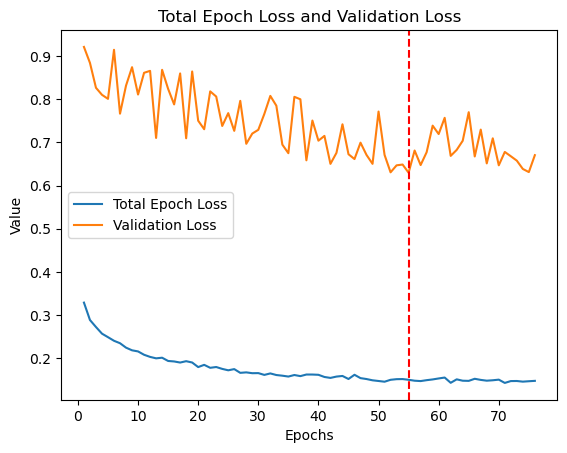

In [12]:
import pandas as pd
import matplotlib.pyplot as plt

# Read the total epoch loss from the first CSV file
df_total_epoch_loss = pd.read_excel('train_loss.xlsx')  # Replace 'total_epoch_loss.csv' with the actual path to your first CSV file
total_epoch_loss = df_total_epoch_loss['Avg loss']  # Replace 'avg loss' with the actual column name

# Read the validation score from the second CSV file
df_validation_score = pd.read_excel('trial1.xlsx')  # Replace 'validation_score.csv' with the actual path to your second CSV file
validation_score = df_validation_score['Val loss']  # Replace 'val loss' with the actual column name

# Plotting both on the same scale
epochs = range(1, min(len(total_epoch_loss), len(validation_score)) + 1)  # Assume both CSV files have the same number of epochs

plt.plot(epochs, total_epoch_loss[:len(epochs)], label='Total Epoch Loss')
plt.plot(epochs, validation_score[:len(epochs)], label='Validation Loss')
plt.axvline(x=55, color='r', linestyle='--')
avg_loss_at_epoch_40 = total_epoch_loss[54]  # Assuming the index starts from 0
val_loss_at_epoch_40 = validation_score[54]  # Assuming the index starts from 0
#plt.text(40, avg_loss_at_epoch_40, f'{avg_loss_at_epoch_40}', va='bottom', ha='right')
#plt.text(40, val_loss_at_epoch_40, f'{val_loss_at_epoch_40}', va='bottom', ha='right')

plt.xlabel('Epochs')
plt.ylabel('Value')
plt.title('Total Epoch Loss and Validation Loss')
plt.legend()

plt.show()


torch.Size([1, 680, 680]) torch.Size([1, 680, 680])


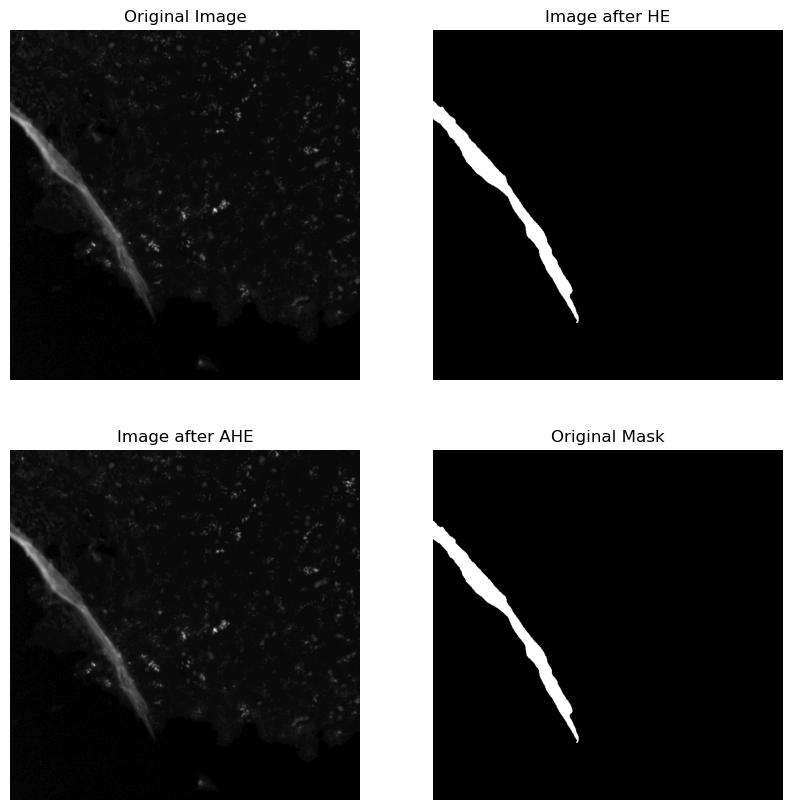

In [3]:
import matplotlib.pyplot as plt
from augmentation import *
from utils.data_loading import *
# Function to display images and masks

def visualize(image, mask, transformed_image, transformed_mask):
    fig, axes = plt.subplots(2, 2, figsize=(10, 10))
    
    # Convert tensors to NumPy arrays
    '''image = image.detach().cpu().numpy()
    mask = mask.detach().cpu().numpy()
    transformed_image = transformed_image.detach().cpu().numpy()
    transformed_mask = transformed_mask.detach().cpu().numpy()'''

    axes[0, 0].imshow(image.squeeze(), cmap='gray')
    axes[0, 0].set_title('Original Image')
    axes[0, 0].axis('off')

    axes[0, 1].imshow(mask.squeeze(), cmap='gray')
    axes[0, 1].set_title('Image after HE')
    axes[0, 1].axis('off')

    axes[1, 0].imshow(transformed_image.squeeze(), cmap='gray')
    axes[1, 0].set_title('Image after AHE')
    axes[1, 0].axis('off')

    axes[1, 1].imshow(transformed_mask.squeeze(), cmap='gray')
    axes[1, 1].set_title('Original Mask')
    axes[1, 1].axis('off')

    plt.show()

# Assuming you have an original image and mask
original_image = load_image('data/imgs/CTR_20200408_00R-Scene-020-ScanRegion19_S0M4_TRITC_cropped_4.png')
original_mask = load_image('data/masks/CTR_20200408_00R-Scene-020-ScanRegion19_S0M4_TRITC_cropped_4_label1.png')
tra=DoubleCompose([DoubleToTensor()])
image, mask=tra(original_image, original_mask)
image_mask_transform = DoubleCompose([DoubleToTensor(), DoubleElasticTransform(alpha=250, sigma=500),])

# Apply transformations
transformed_image, transformed_mask = image_mask_transform(original_image, original_mask)
print(image.shape, mask.shape)
# Apply transformations
# Visualize
visualize(image, mask, transformed_image, transformed_mask)


In [20]:
import pandas as pd
import re

# Read the log file and extract relevant information
train_losses = []
validation_dice_scores = []

with open('error.log', 'r') as file:
    for line in file:
        train_loss_match = re.search(r'Train loss=(\d+\.\d+)', line)
        if train_loss_match:
            train_loss = float(train_loss_match.group(1))
            train_losses.append(train_loss)
        
        validation_dice_score_match = re.search(r'Validation Dice score: (\d+\.\d+)', line)
        if validation_dice_score_match:
            validation_dice_score = float(validation_dice_score_match.group(1))
            validation_dice_scores.append(validation_dice_score)

# Create a DataFrame

data1={'Validation Dice Score': validation_dice_scores}
df = pd.DataFrame(train_losses)
df.to_excel('train_loss_data_aug.xlsx')
df1=pd.DataFrame(data1)
df1.to_excel('val_loss_data_aug.xlsx')
# Save to Excel





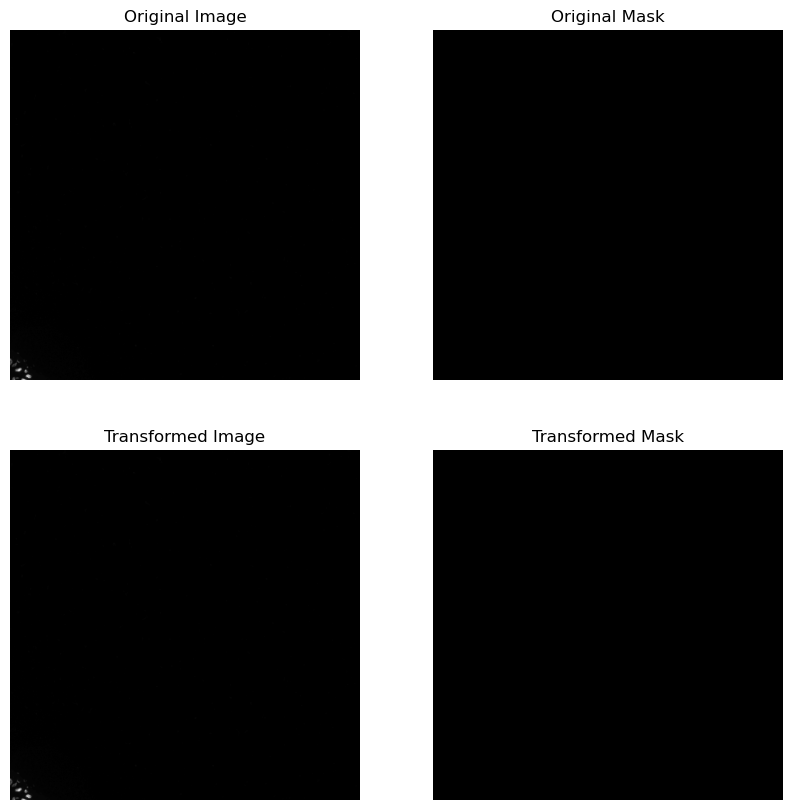

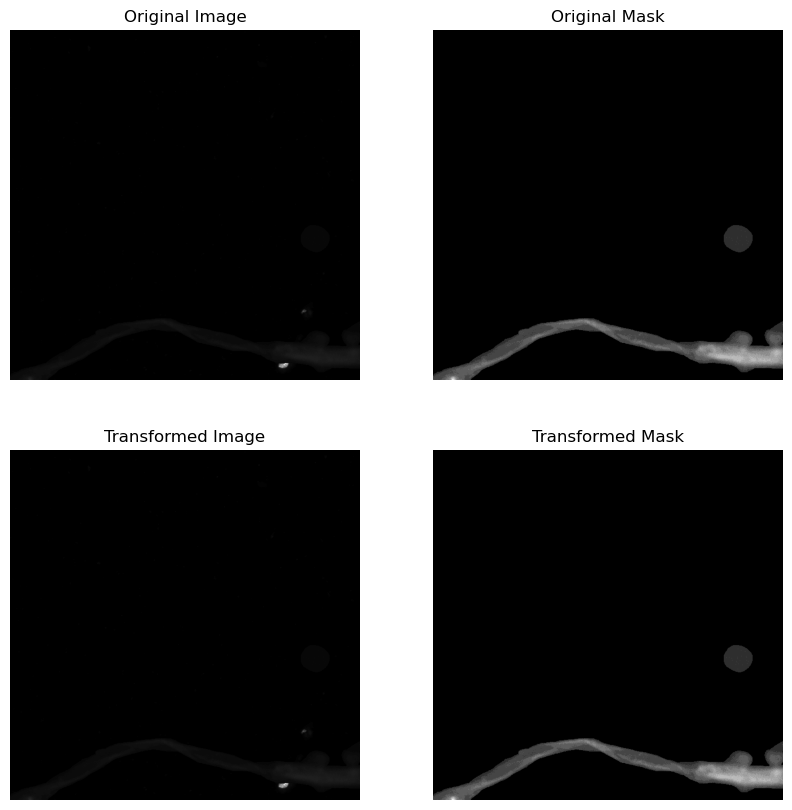

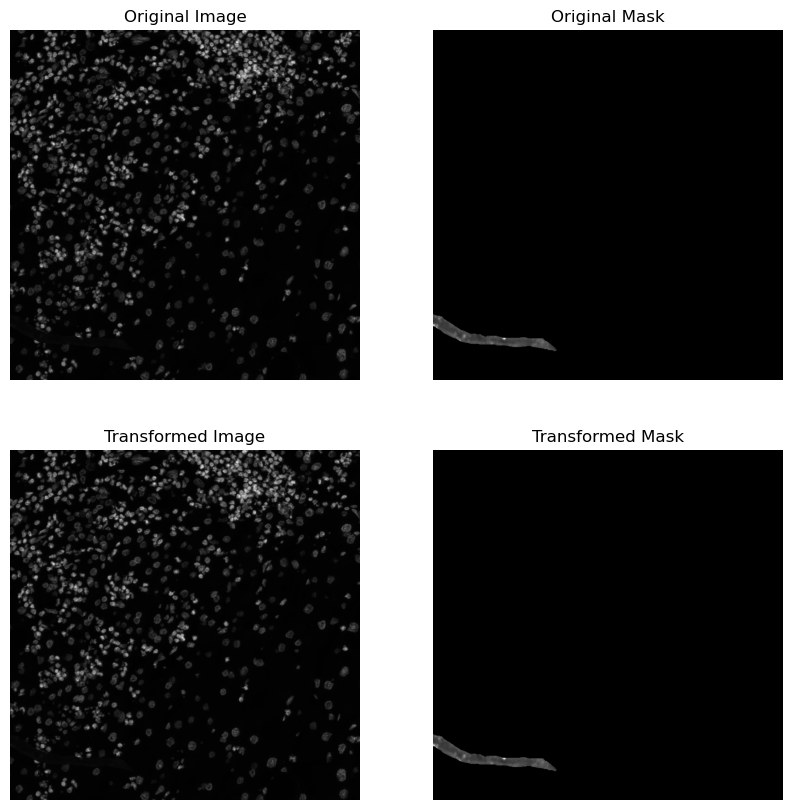

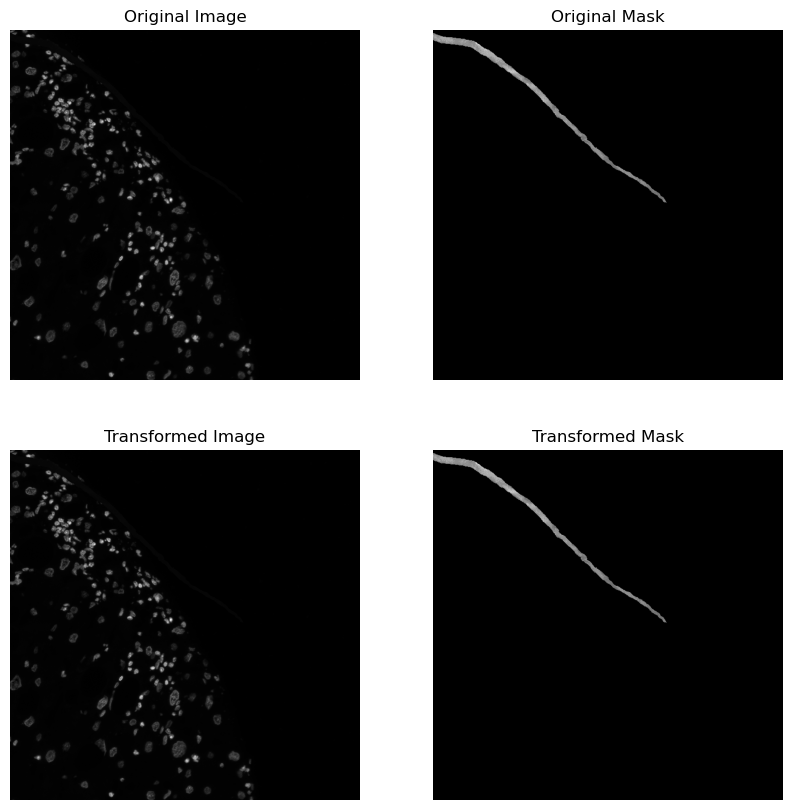

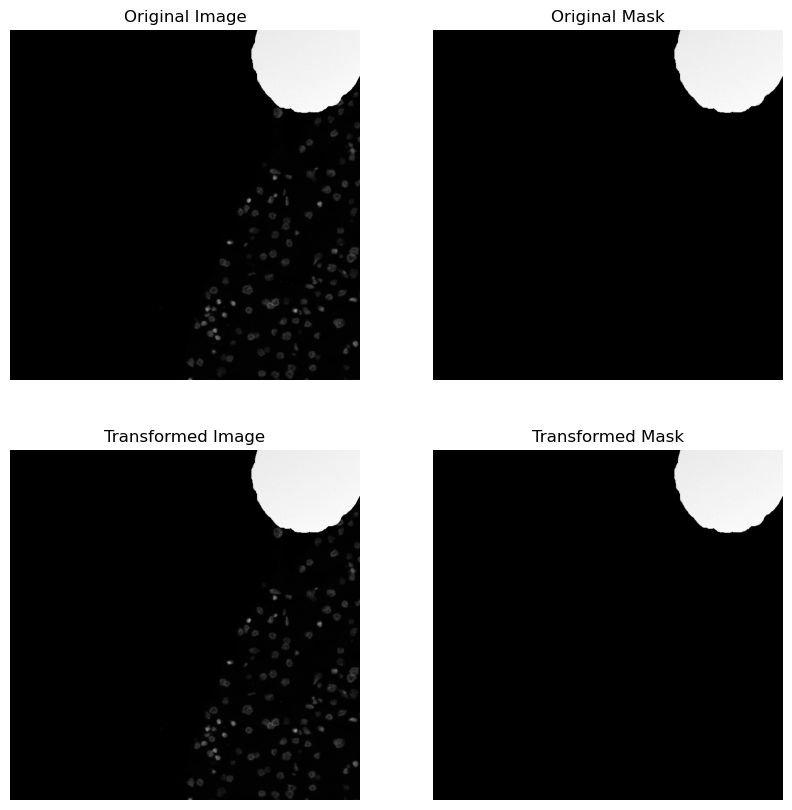

...

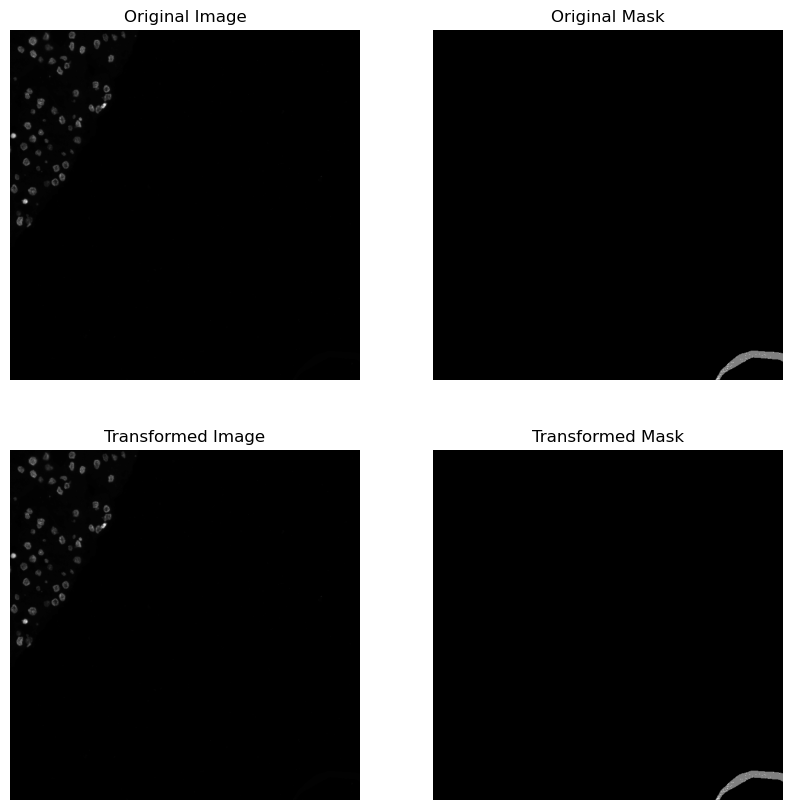

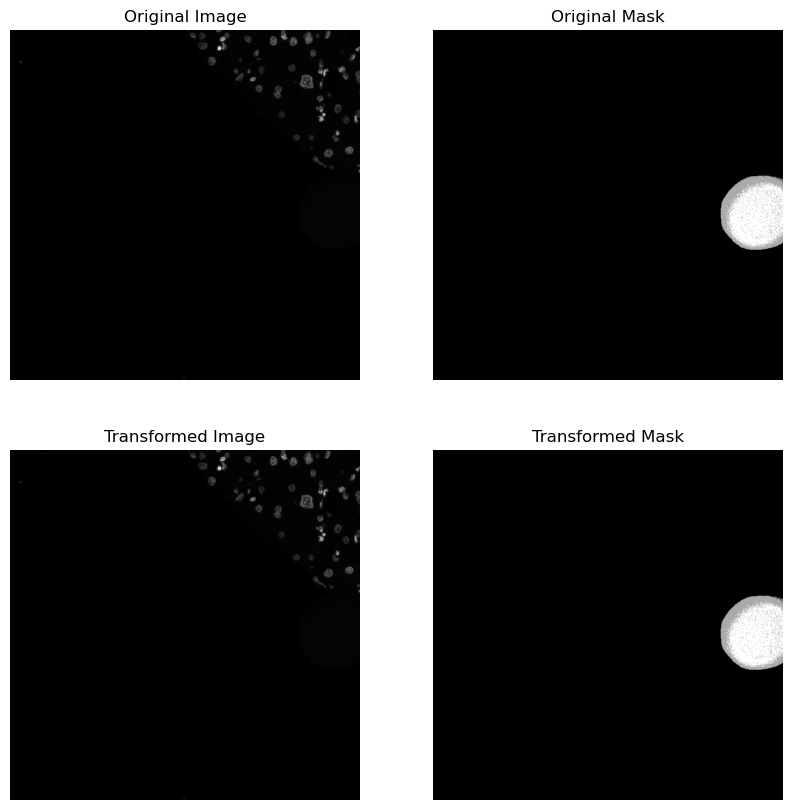

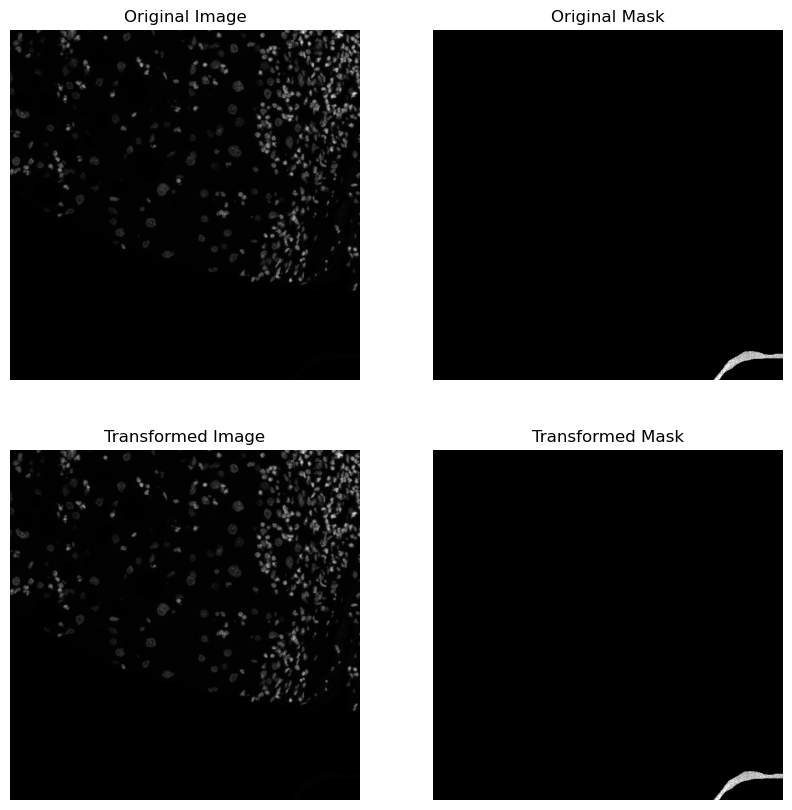

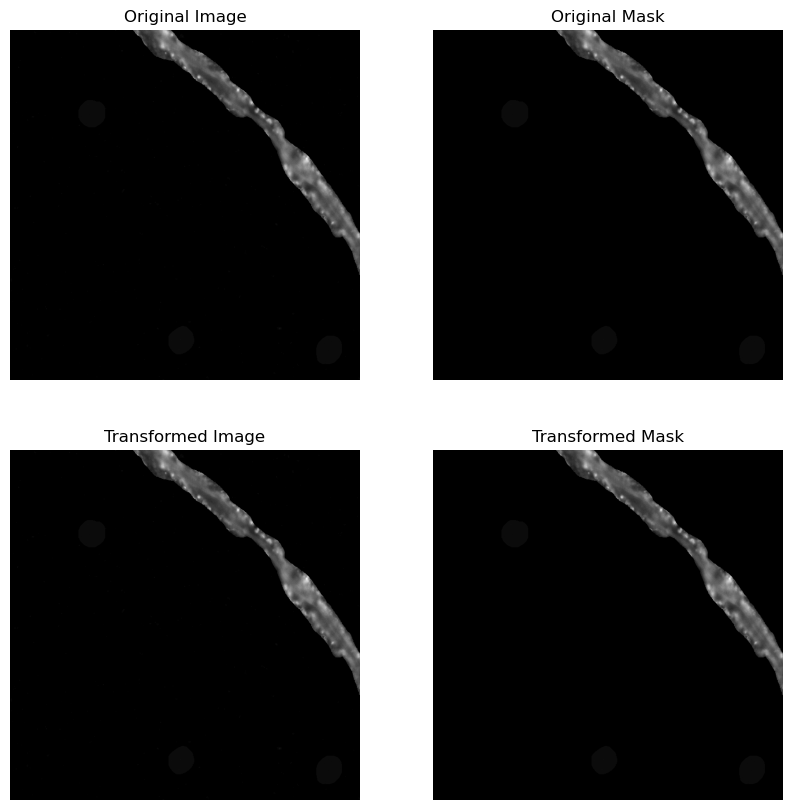

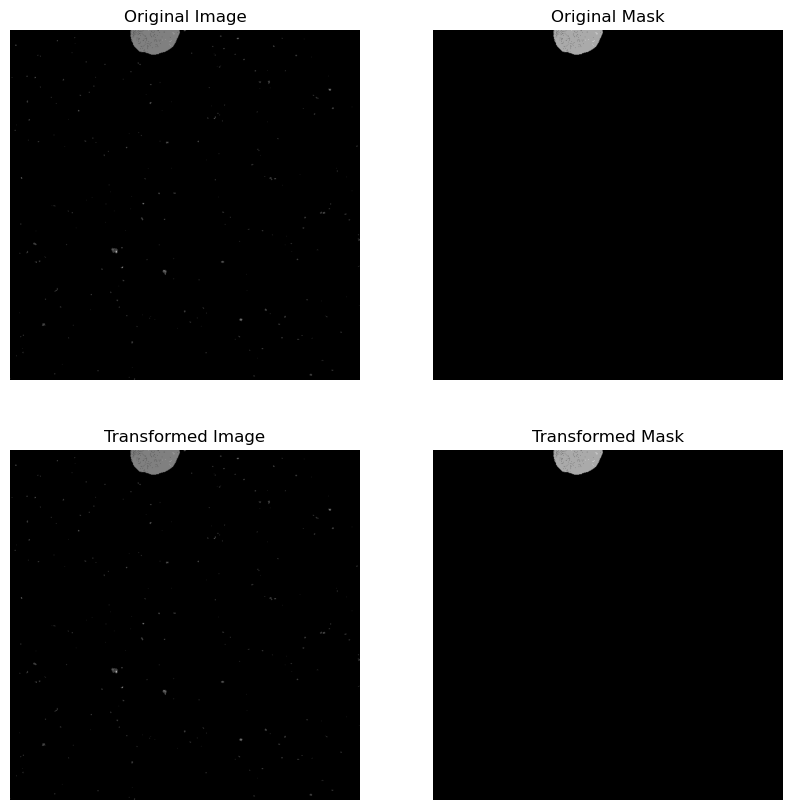

KeyboardInterrupt: 

In [22]:
import os
import random
from PIL import Image
import numpy as np
import os
import numpy as np
from PIL import Image

def extract_artifact_locations(mask_folder):
    """
    Extract artifact locations from the masks.
    
    Args:
    - mask_folder (str): Path to the folder containing label masks.
    
    Returns:
    - artifact_locations (list of np.ndarray): List of artifact locations for each mask.
    """
    artifact_locations = []
    for mask_filename in os.listdir(mask_folder):
        mask_path = os.path.join(mask_folder, mask_filename)
        mask = Image.open(mask_path)
        mask_array = np.array(mask)
        # Get indices where mask value is greater than 0
        artifact_locations.append(np.where(mask_array > 0))
    return artifact_locations

def create_artifact_images(image_folder, mask_folder, output_folder, artifact_locations):
    """
    Create artifact images using the extracted artifact locations.
    
    Args:
    - image_folder (str): Path to the folder containing original images.
    - mask_folder (str): Path to the folder containing label masks.
    - output_folder (str): Path to the output folder to save the generated artifact images.
    - artifact_locations (list of np.ndarray): List of artifact locations for each mask.
    """
    # Create output folder if it does not exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    
    # Iterate over each image and its corresponding mask
    for image_filename, mask_locations in zip(os.listdir(image_folder), artifact_locations):
        image_path = os.path.join(image_folder, image_filename)
        image = Image.open(image_path)
        image_array = np.array(image)
        
        # Create an empty artifact image
        artifact_image = np.zeros_like(image_array)
        
        # Fill artifact locations with pixel values from the original image
        for x, y in zip(*mask_locations):
            artifact_image[x, y] = image_array[x, y]
        
        # Save the artifact image
        #artifact_image_path = os.path.join(output_folder, f"artifact_{image_filename}")
        
        #Image.fromarray(artifact_image).save(artifact_image_path)
        visualize(image_array, artifact_image, image_array, artifact_image)
# Example usage
image_folder = "data/imgs"
mask_folder = "data/masks"
output_folder = "data/artifacts"

artifact_locations = extract_artifact_locations(mask_folder)
create_artifact_images(image_folder, mask_folder, output_folder, artifact_locations)

In [3]:
import os
import numpy as np
from PIL import Image
from utils.data_loading import *
def load_artifacts(artifact_folder):
    """
    Load artifacts from the folder.
    
    Args:
    - artifact_folder (str): Path to the folder containing artifacts.
    
    Returns:
    - artifacts (list): List of artifact images.
    """
    artifacts = []
    for artifact_filename in os.listdir(artifact_folder):
        artifact_path = os.path.join(artifact_folder, artifact_filename)
        artifact = Image.open(artifact_path)
        artifacts.append(artifact)
    return artifacts

def add_artifacts(image, mask, artifacts):
    """
    Add artifacts to both the image and its corresponding mask.
    
    Args:
    - image (PIL.Image): Original image.
    - mask (PIL.Image): Corresponding label mask.
    - artifacts (list of PIL.Image): List of artifact images.
    
    Returns:
    - artifact_image (np.ndarray): Image with added artifacts.
    - artifact_mask (np.ndarray): Mask with added artifacts.
    """
    # Randomly select an artifact
    artifact = np.random.choice(artifacts)
    artifact=np.array(artifact)
    image_array = np.array(image)
    mask_array = np.array(mask)
    artifact_array = np.array(artifact)
    
    # Replace non-zero parts of the artifact onto the original image
    artifact_image_array = np.where(artifact_array > 0, artifact_array, image_array)
    
    # Create a new mask with only the pasted artifact
    artifact_mask_array = np.where(artifact_array > 0, 255, mask_array)
    
    # Convert arrays back to PIL images
    artifact_image = Image.fromarray(artifact_image_array)
    artifact_mask = Image.fromarray(artifact_mask_array)
    
    return artifact_image, artifact_mask
    '''image=np.array(image)
    artifact_image = image.copy()
    artifact_mask = mask.copy()
    
    # Randomly rotate or flip artifact
    rotation_angle = np.random.randint(0, 360)  # Random rotation angle between 0 and 360 degrees
    should_flip = np.random.choice([True, False])  # Randomly decide whether to flip horizontally
    if should_flip:
        artifact = artifact.transpose(Image.FLIP_LEFT_RIGHT)
        
    artifact = artifact.rotate(rotation_angle, expand=True)
    artifact = artifact.rotate(rotation_angle, expand=True)
    for x, y in zip(*artifact):
        artifact_image[x, y] = artifact[x, y]
        artifact_mask[x, y] = 255  # Set the corresponding pixel in the mask to white
    
    return artifact_image, artifact_mask
    
    # Add artifact to image and mask
    artifact_image.paste(artifact_image, (0, 0), mask=artifact_mask)
    
    return artifact_image, artifact_mask
    # Randomly select a position to place the artifact
    x_offset = np.random.randint(0, 680)
    y_offset = np.random.randint(0, 680)

    
    # Create copies of image and mask
    artifact_image = np.array(image.copy())
    artifact_mask = np.array(mask.copy())
    
    # Overlay the artifact on the image
    artifact_image[y_offset:y_offset+artifact.size[1], x_offset:x_offset+artifact.size[0], :] += np.array(artifact)
    
    # Update the mask to have white parts at the artifact location
    artifact_mask[y_offset:y_offset+artifact.size[1], x_offset:x_offset+artifact.size[0]] = 255
    
    return artifact_image, artifact_mask'''


def add_artifacts_to_images(image_folder, mask_folder, output_image_folder, output_mask_folder, artifact_folder):
    """
    Add artifacts to images and their corresponding masks and save them.
    
    Args:
    - image_folder (str): Path to the folder containing original images.
    - mask_folder (str): Path to the folder containing label masks.
    - output_image_folder (str): Path to the output folder to save the images with artifacts.
    - output_mask_folder (str): Path to the output folder to save the masks with artifacts.
    - artifact_folder (str): Path to the folder containing artifacts.
    """
    k=0
        # Load artifacts
    artifacts = load_artifacts(artifact_folder)
    
    # Create output folders if they do not exist
    if not os.path.exists(output_image_folder):
        os.makedirs(output_image_folder)
    if not os.path.exists(output_mask_folder):
        os.makedirs(output_mask_folder)
    
    # Iterate over each image and its corresponding mask
    for image_filename in os.listdir(image_folder):
        image_path = os.path.join(image_folder, image_filename)
        mask_filename = image_filename.replace(".png", "_label0.png")  # Get corresponding mask filename
        mask_path = os.path.join(mask_folder, mask_filename)
        image = Image.open(image_path)
        mask = Image.open(mask_path)
       
        # Add artifacts to image and mask
        artifact_image, artifact_mask = add_artifacts(image.copy(), mask, artifacts)
        
        # Save the artifact image and mask
        artifact_image_path = os.path.join(output_image_folder, f"artifact_{image_filename}")
        artifact_mask_path = os.path.join(output_mask_folder, f"artifact_{mask_filename}")
        artifact_image.save(artifact_image_path)
        artifact_mask.save(artifact_mask_path)
        k+=1
        if k>=500:
            break

# Example usage
image_folder = "data/no_artifact/images"
mask_folder = "data/no_artifact/masks"
output_image_folder = "data/extra/images"
output_mask_folder = "data/extra/masks"
artifact_folder = "data/artifacts"

add_artifacts_to_images(image_folder, mask_folder, output_image_folder, output_mask_folder, artifact_folder)


NameError: name '_C' is not defined

In [1]:
import os

def rename_images(folder_path):
    """
    Rename all images ending with "label0.png" to "label1.png" in the specified folder.
    
    Args:
    - folder_path (str): Path to the folder containing the images.
    """
    for filename in os.listdir(folder_path):
        if filename.endswith(".png"):
            old_filepath = os.path.join(folder_path, filename)
            new_filename = filename.replace(".png", "_label1.png")
            new_filepath = os.path.join(folder_path, new_filename)
            os.rename(old_filepath, new_filepath)

# Example usage
image_folder = "data/Food-Image-Classifier/No_Artifacts_label"
rename_images(image_folder)


In [13]:
from PIL import Image
import os
import numpy as np

def count_zeros_ones_in_folder(folder_path):
    """
    Open any image from the specified folder and count the number of 0s and 1s in its array representation.
    
    Args:
    - folder_path (str): Path to the folder containing images.
    
    Returns:
    - num_zeros (int): Number of zeros in the image array.
    - num_ones (int): Number of ones in the image array.
    """
    # List all files in the folder
    files = os.listdir(folder_path)
    
    # Filter out image files
    image_files = [f for f in files if f.endswith(".jpg") or f.endswith(".png")]

    # Choose any one image file
    chosen_image_file = np.random.choice(image_files)
    print(chosen_image_file)
    # Open the chosen image
    chosen_image_path = os.path.join(folder_path, chosen_image_file)
    chosen_image = Image.open(chosen_image_path)

    # Convert image to grayscale
    

    # Convert image to numpy array
    chosen_image_array = np.array(chosen_image)

    # Convert image to binary (0 and 1)
    

    # Count the number of zeros and ones
    num_zeros = np.sum(chosen_image_array == 0)
    num_ones = np.max(chosen_image_array)

    return num_zeros, num_ones

# Example usage
folder_path = "data/artifact/images"  # Replace with the path to your folder containing images
num_zeros, num_ones = count_zeros_ones_in_folder(folder_path)
print("Number of zeros:", num_zeros)
print("Number of ones:", num_ones)


artifact_BNC17_R07_V02_RIEM_JM_S4M4_DAPI_cropped_6.png
Number of zeros: 81723
Number of ones: 95


In [14]:
image_path='data/no_artifact/images/PBC_20200408_00R-Scene-085-ScanRegion84_S0M1_TRITC_cropped_2.png'
chosen_image = Image.open(image_path)
arr1=np.array(chosen_image)
    # Convert image to grayscale
    
image_path='data/artifact/images/artifact_PBC_20200408_00R-Scene-085-ScanRegion84_S0M1_TRITC_cropped_2.png'
chosen_image = Image.open(image_path)
arr2=np.array(chosen_image)
    # Convert image to numpy array
chosen_image_array = np.array(chosen_image)

    # Convert image to binary (0 and 1)
    

    # Count the number of zeros and ones
num_zeros = np.sum(chosen_image_array == 4)
num_ones = np.sum(chosen_image_array == 2)
print(chosen_image_array)
print(num_zeros, num_ones)
arr1_flat = arr1.flatten()
arr2_flat = arr2.flatten()

# Perform element-wise comparison
mismatch_indices = np.where(arr1_flat != arr2_flat)[0]

# Get the values at the mismatched indices
mismatch_values_arr1 = arr1_flat[mismatch_indices]
mismatch_values_arr2 = arr2_flat[mismatch_indices]

print("Mismatched indices:", mismatch_indices)
print("Values in arr1 at mismatched indices:", mismatch_values_arr1)
print("Values in arr2 at mismatched indices:", mismatch_values_arr2)

[[4 4 4 ... 2 2 2]
 [4 4 4 ... 2 2 2]
 [4 4 4 ... 2 2 2]
 ...
 [2 2 2 ... 2 2 2]
 [2 2 2 ... 2 2 2]
 [2 2 2 ... 2 2 2]]
18308 413240
Mismatched indices: [ 47834  47835  48514 ... 462088 462089 462090]
Values in arr1 at mismatched indices: [4 4 4 ... 2 2 2]
Values in arr2 at mismatched indices: [1 1 1 ... 1 1 1]


In [86]:
print(len(mismatch_indices))
print(np.max(mismatch_values_arr1))

9573
5


In [15]:
import os

# Path to the folder containing images
image_folder = "data\\train_vgg\\cropped_images"

# Path to the folder containing masks
mask_folder = "data\\train_vgg\\cropped_labels"

# Initialize an empty dictionary to store image path: label pairs
image_label_dict = {}

# Iterate over mask files in the mask folder
for mask_filename in os.listdir(mask_folder):
    # Initialize an empty dictionary to store image path: label pairs
    image_label_dict = {}
    # Extract the image name from the mask filename
    image_name = mask_filename.split("_label")[0]
    
    # Get the full path to the mask file
    mask_path = os.path.join(mask_folder, mask_filename)
    
    # Determine the label based on the mask filename
    label = mask_filename.split("_")[-1].split(".")[0]  # Extract label from mask filename
    label=int(label[-1])
    # Construct the full path to the corresponding image
    image_path = os.path.join(image_folder, image_name)+'.png'
    
    # Add the image path and label to the dictionary
    image_label_dict[image_path] = label
    return image_label_dict
# Print the image path: label dictionary

t=sum(image_label_dict.values())
print(t)
    

555


In [6]:
from hist_eq import *
import os
import numpy as np
from PIL import Image
from utils.data_loading import *
import cv2
import argparse
import numpy as pb
import glob
parse = argparse.ArgumentParser()
parse.add_argument(
        '--FilePath', default='/data/artifact/images',
        help='Images path')
parse.add_argument(
        "--visualize",
        default=True,
        choices=('True', 'False'),
        help="Shows visualization. Default: False.")
parse.add_argument(
        "--record",
        default=False,
        choices=('True', 'False'),
        help="Records video (histE.mp4 & AHE.mp4). Default: False.")

Args = parse.parse_args()
    # Change the file format below if images are in different formats
file_path = Args.FilePath + '/*.png'
visualize = str(Args.visualize)
video_write = str(Args.record)
fps = 10
    
k=0
images = sorted(glob.glob(file_path))
for image in images:
    img = cv2.imread(image, 1)
        # Covert to HSV
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    h, s, v = cv2.split((hsv))
    hist_v = hist_equalization(v)
        # Merge back the channel
    merged_hist = cv2.merge((h, s, hist_v))
    hist = cv2.cvtColor(merged_hist, cv2.COLOR_HSV2BGR)

    ahe_v = ahe(v)
    merged_ahe = cv2.merge((h, s, ahe_v))
    ahe_img = cv2.cvtColor(merged_ahe, cv2.COLOR_HSV2BGR)

        
    if visualize == str(True):
        cv2.imshow("Original", img)
        cv2.imshow("Histogram Equalization", hist)
        cv2.imshow("AHE", ahe_img)
  
       
    
  




usage: ipykernel_launcher.py [-h] [--FilePath FILEPATH]
                             [--visualize {True,False}]
                             [--record {True,False}]
ipykernel_launcher.py: error: unrecognized arguments: --f=c:\Users\hp\AppData\Roaming\jupyter\runtime\kernel-v2-9064gcW9P5qCPz0m.json


SystemExit: 2

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_2.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_2_label1.png
(680, 680) (680, 680)


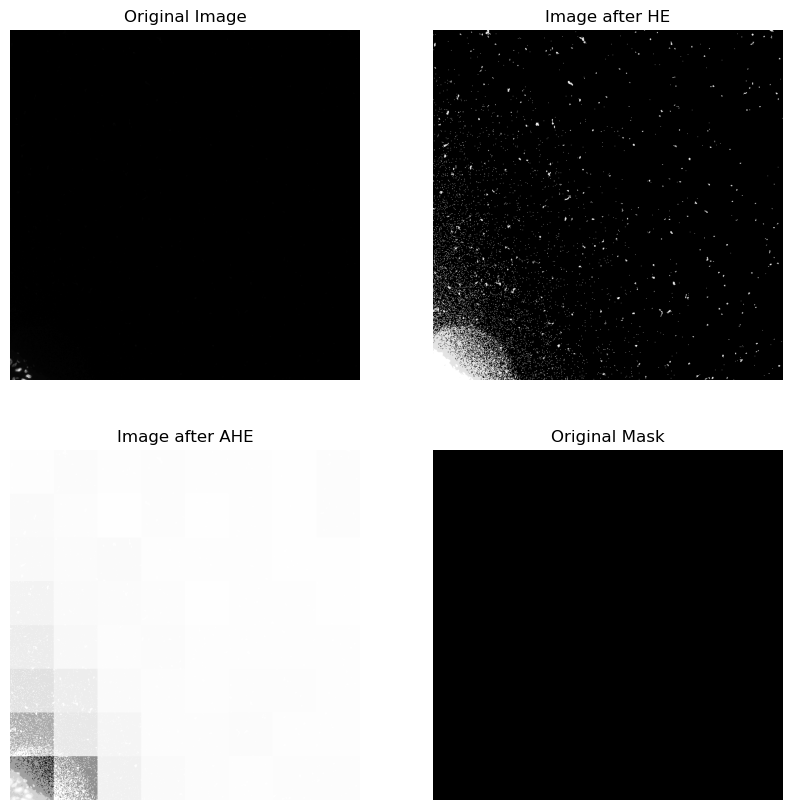

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_3.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_3_label1.png
(680, 680) (680, 680)


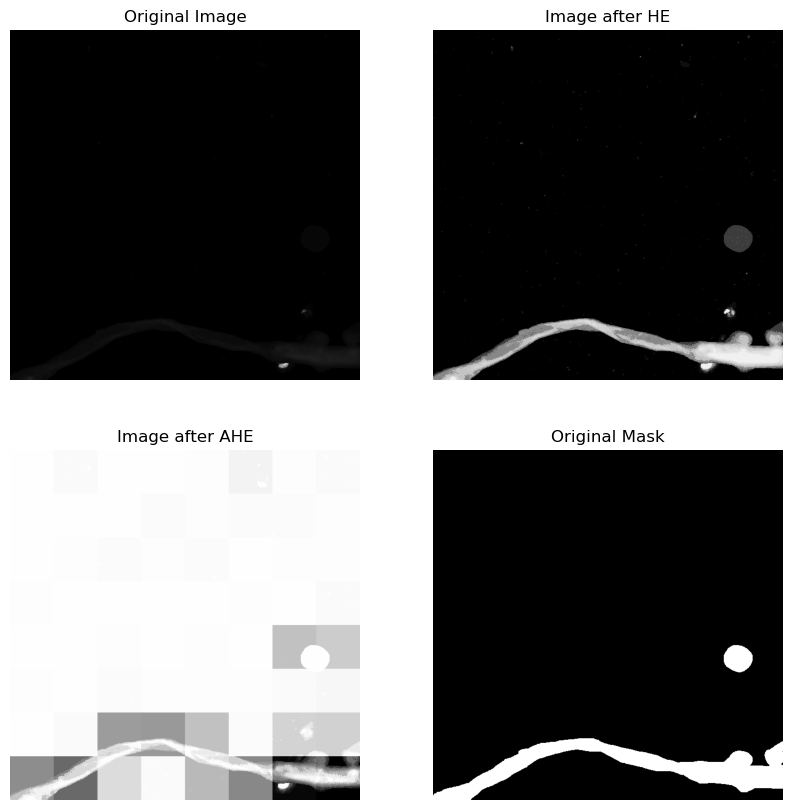

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_4.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_4_label1.png
(680, 680) (680, 680)


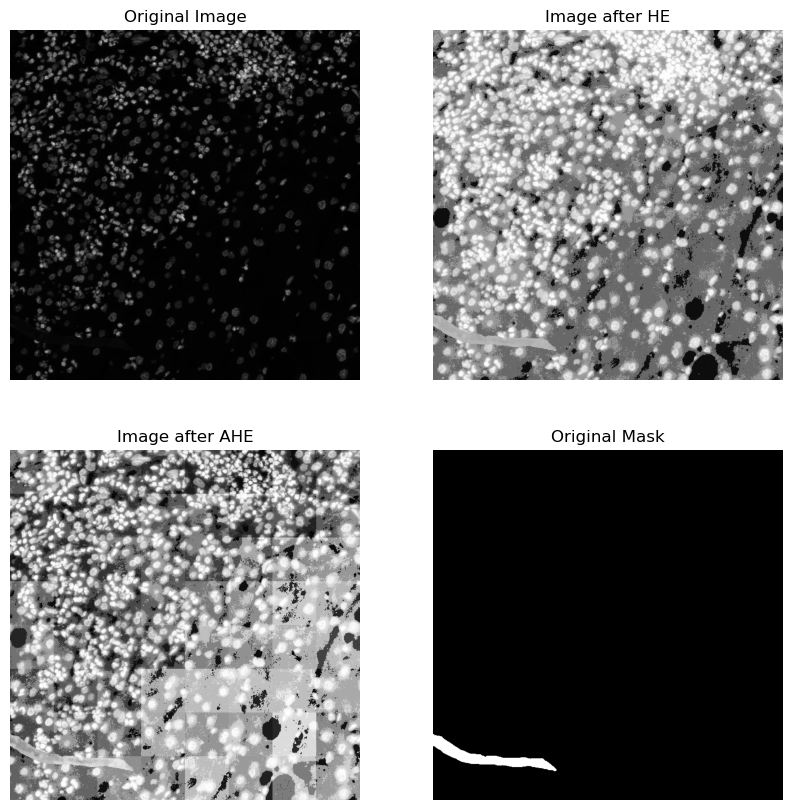

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_5.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_5_label1.png
(680, 680) (680, 680)


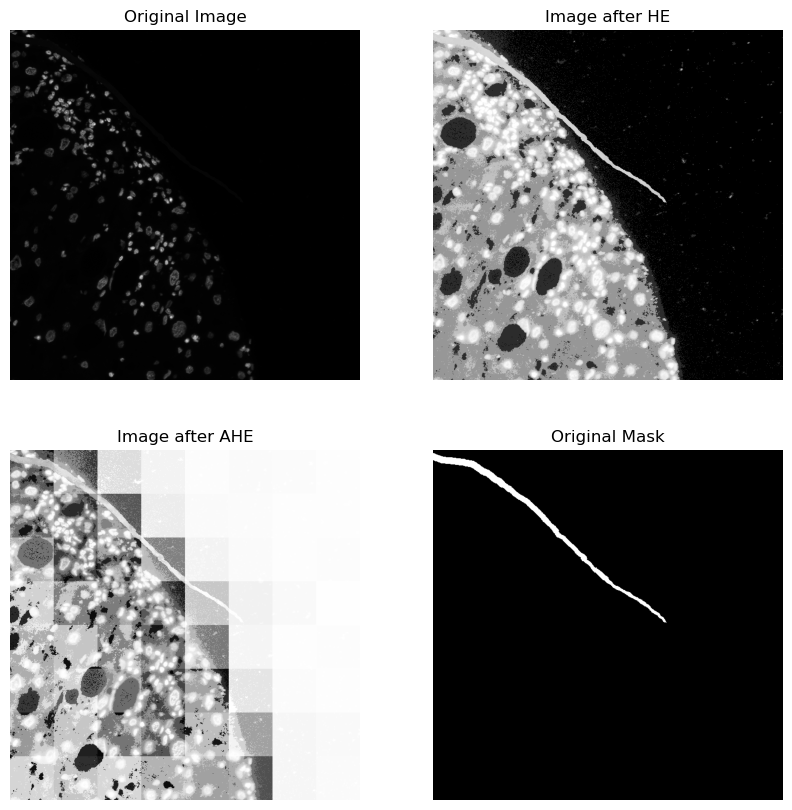

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_6.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_6_label1.png
(680, 680) (680, 680)


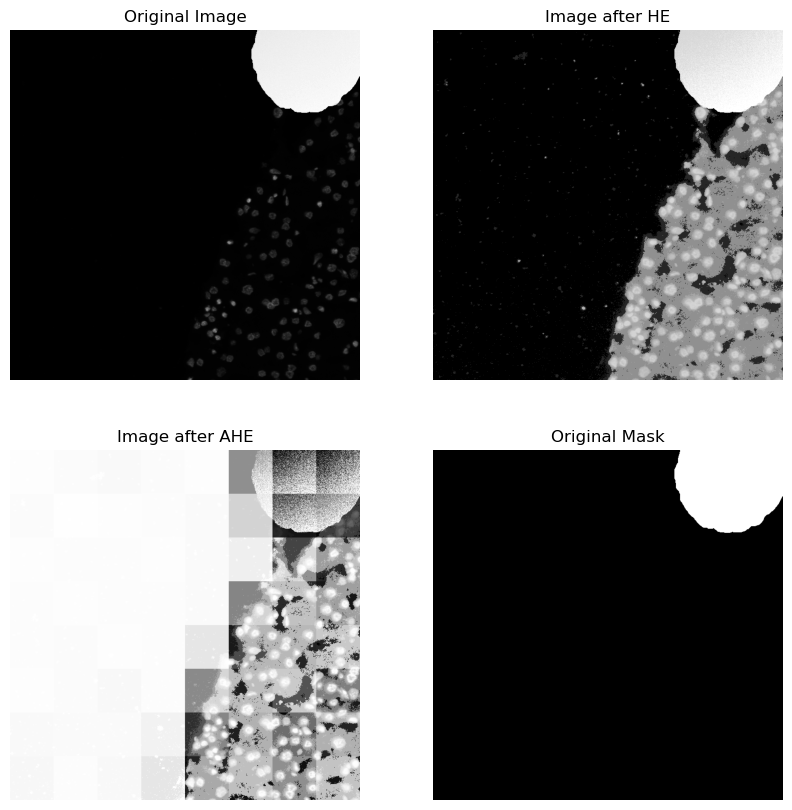

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_7.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_7_label1.png
(680, 680) (680, 680)


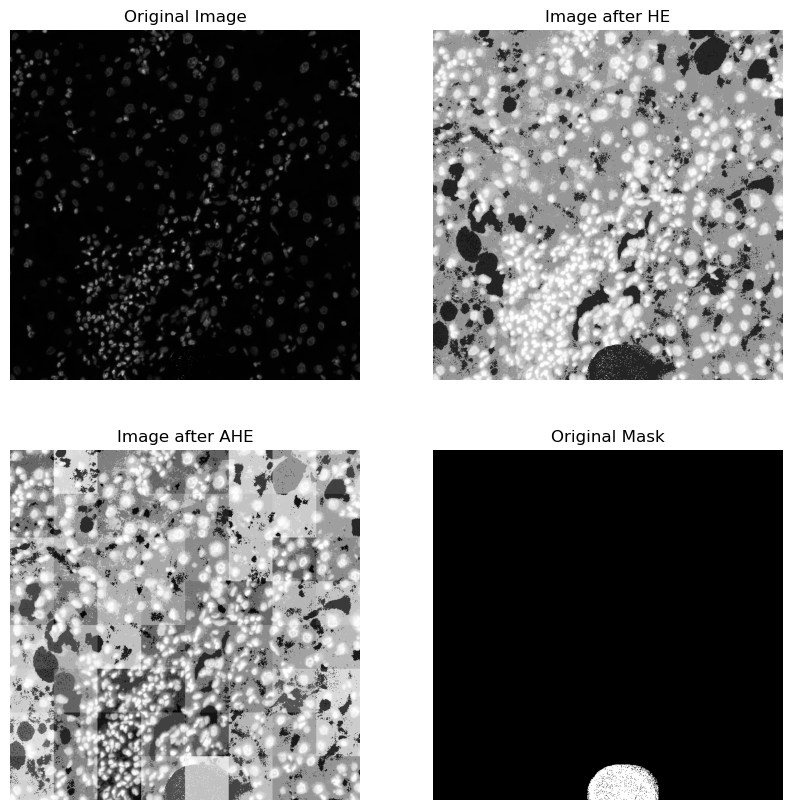

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_8.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_8_label1.png
(680, 680) (680, 680)


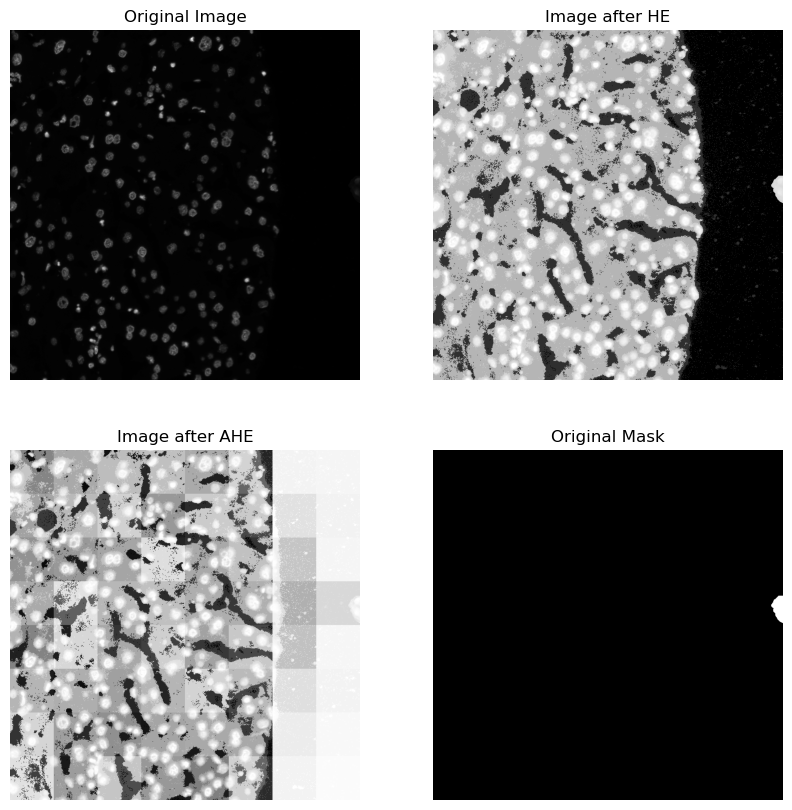

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_9.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_9_label1.png
(680, 680) (680, 680)


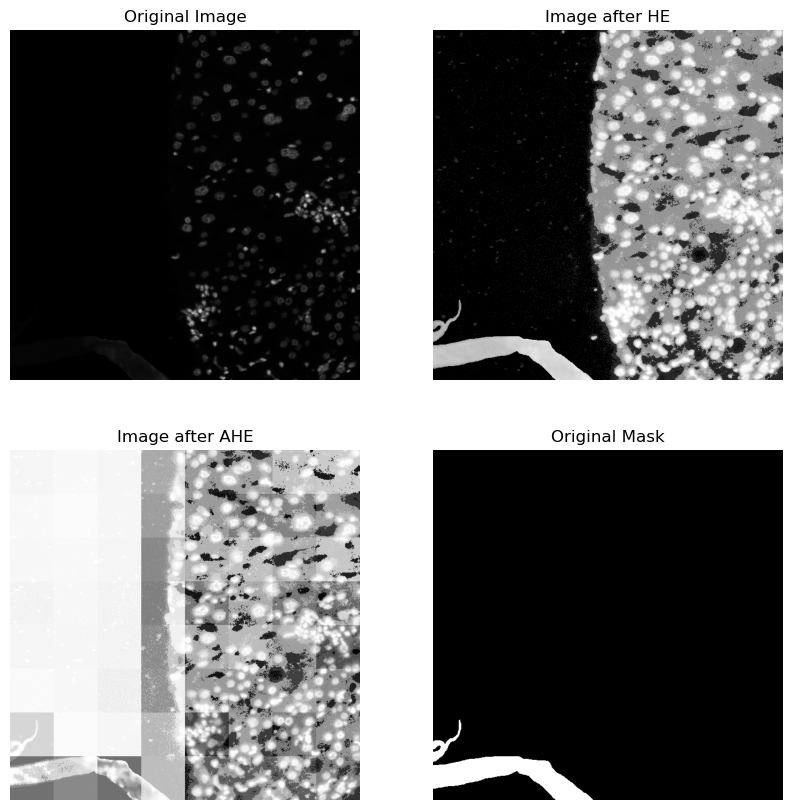

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_1.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_1_label1.png
(680, 680) (680, 680)


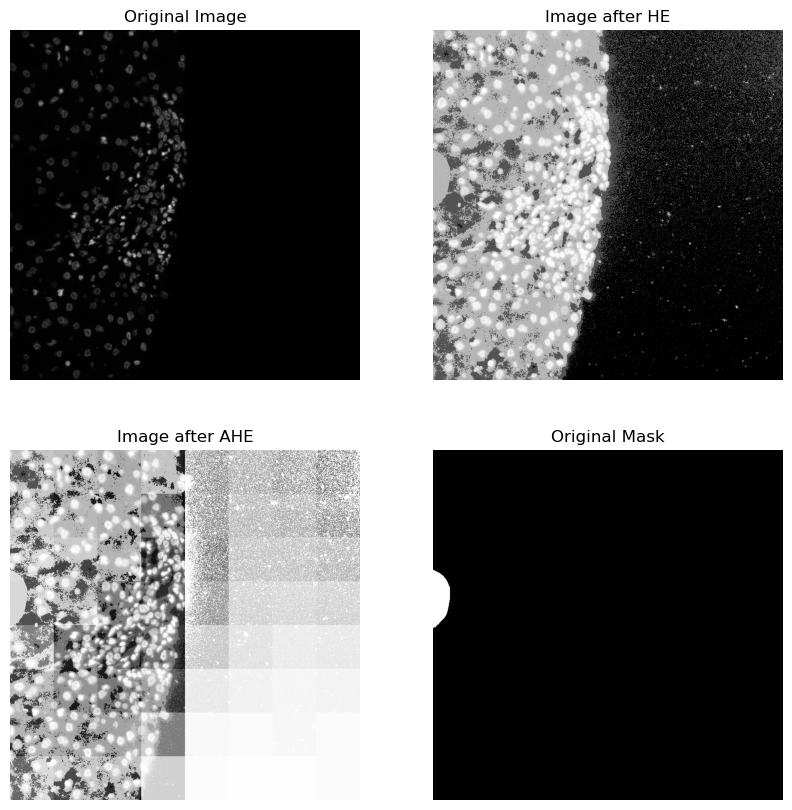

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_2.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_2_label1.png
(680, 680) (680, 680)


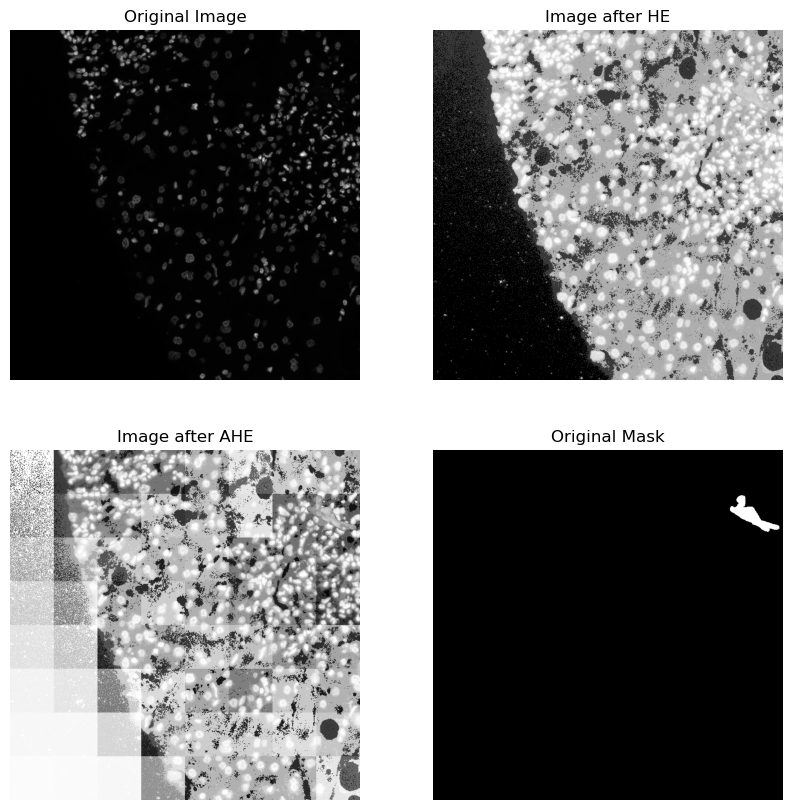

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_3.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_3_label1.png
(680, 680) (680, 680)


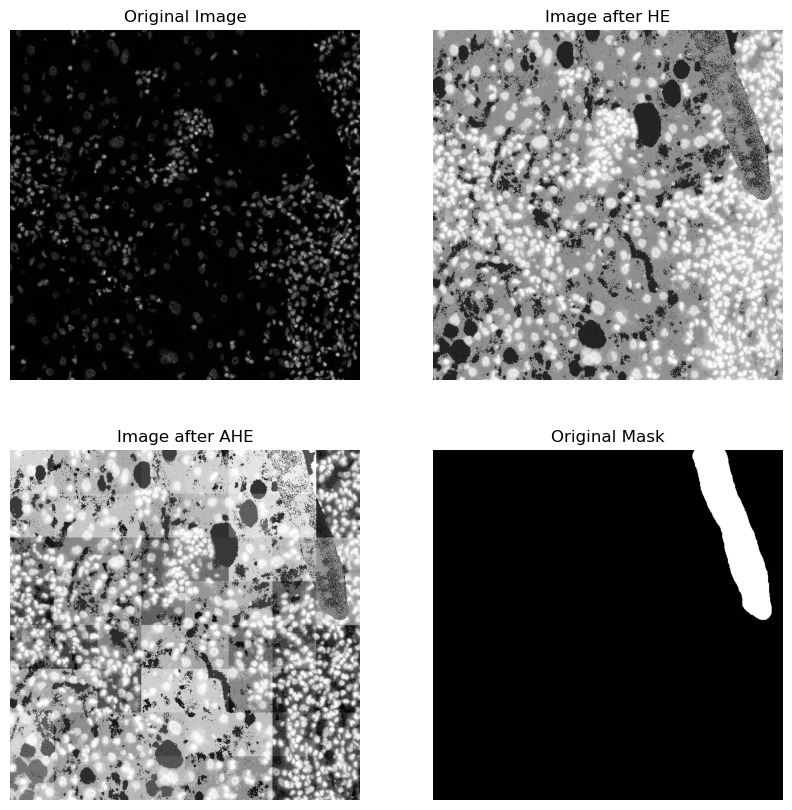

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_4.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_4_label1.png
(680, 680) (680, 680)


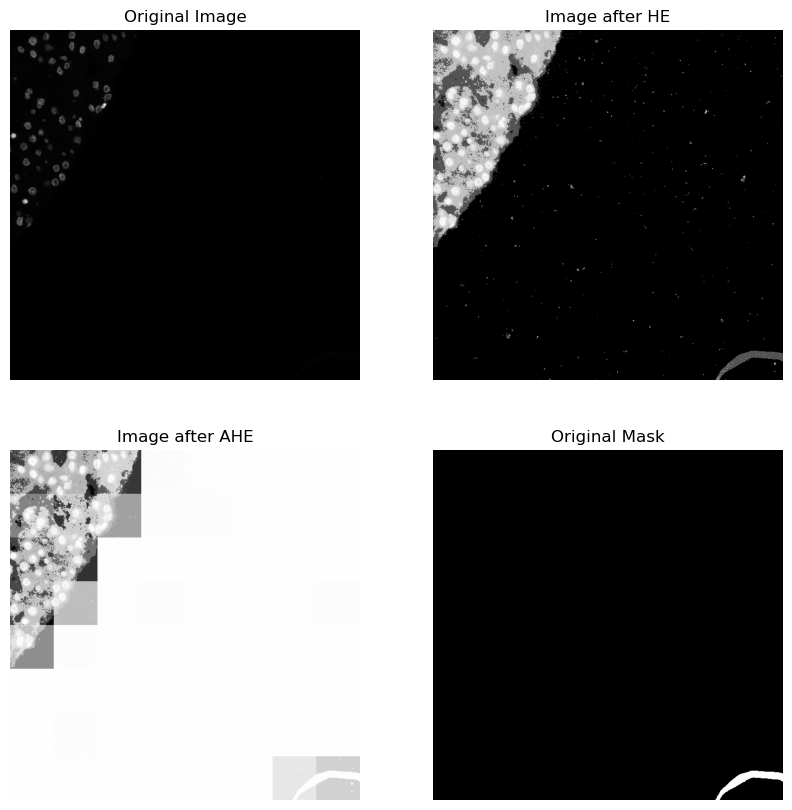

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_5.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_5_label1.png
(680, 680) (680, 680)


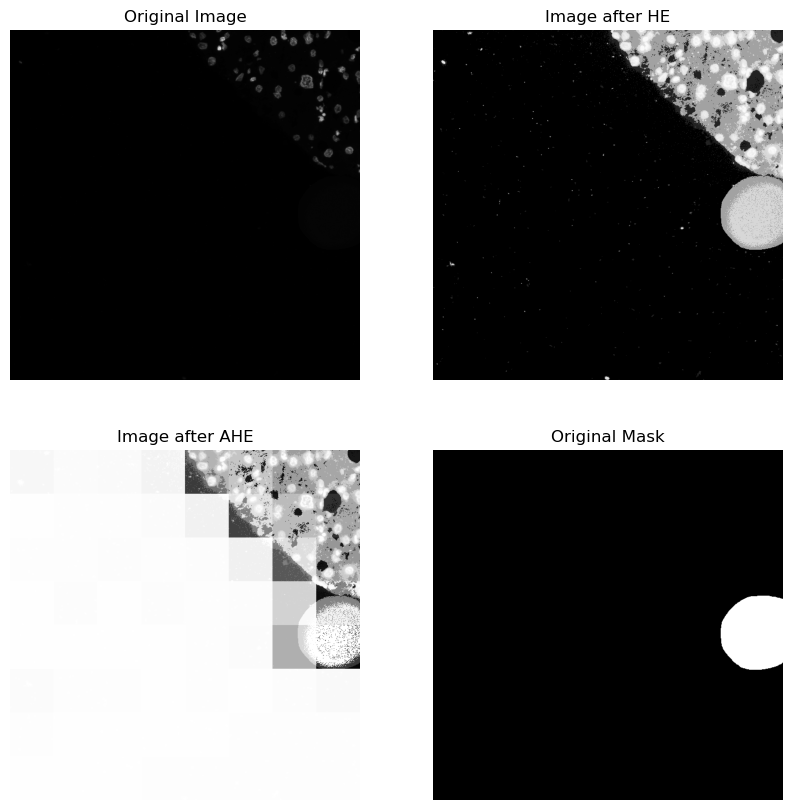

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_6.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_6_label1.png
(680, 680) (680, 680)


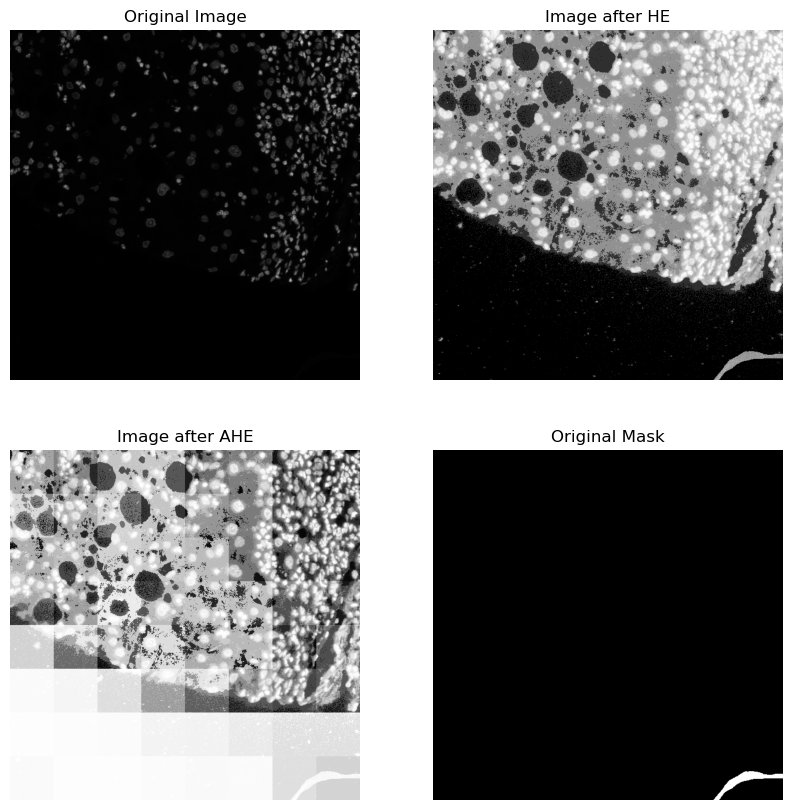

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_7.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_7_label1.png
(680, 680) (680, 680)


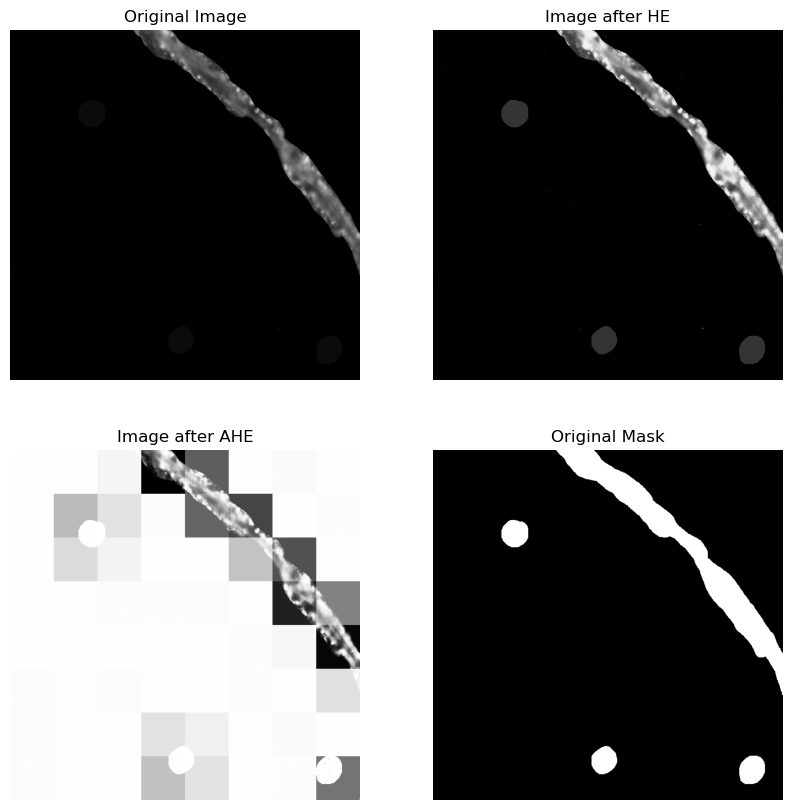

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_8.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_8_label1.png
(680, 680) (680, 680)


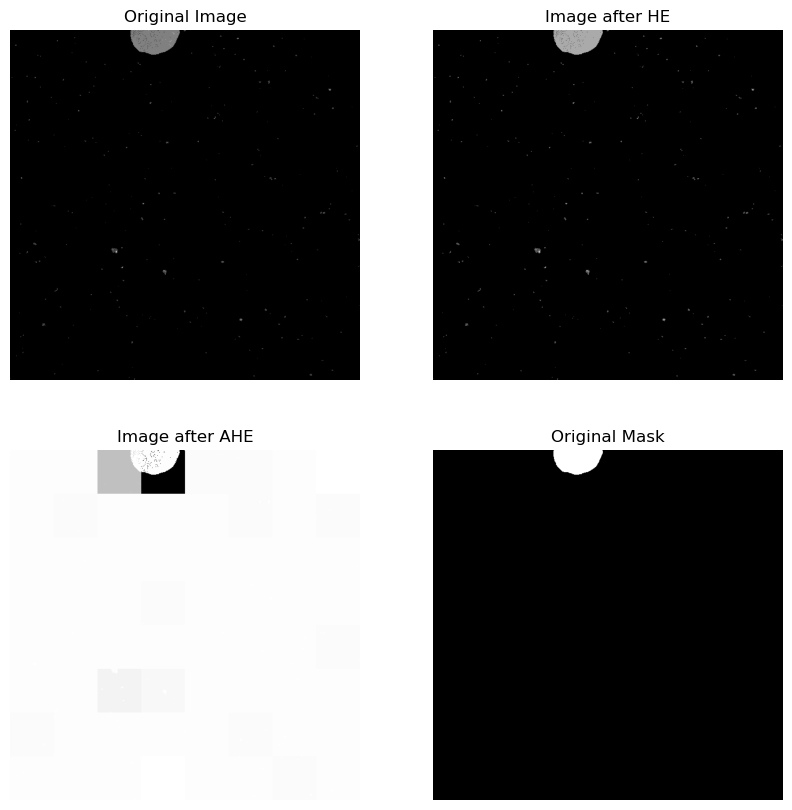

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_9.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_9_label1.png
(680, 680) (680, 680)


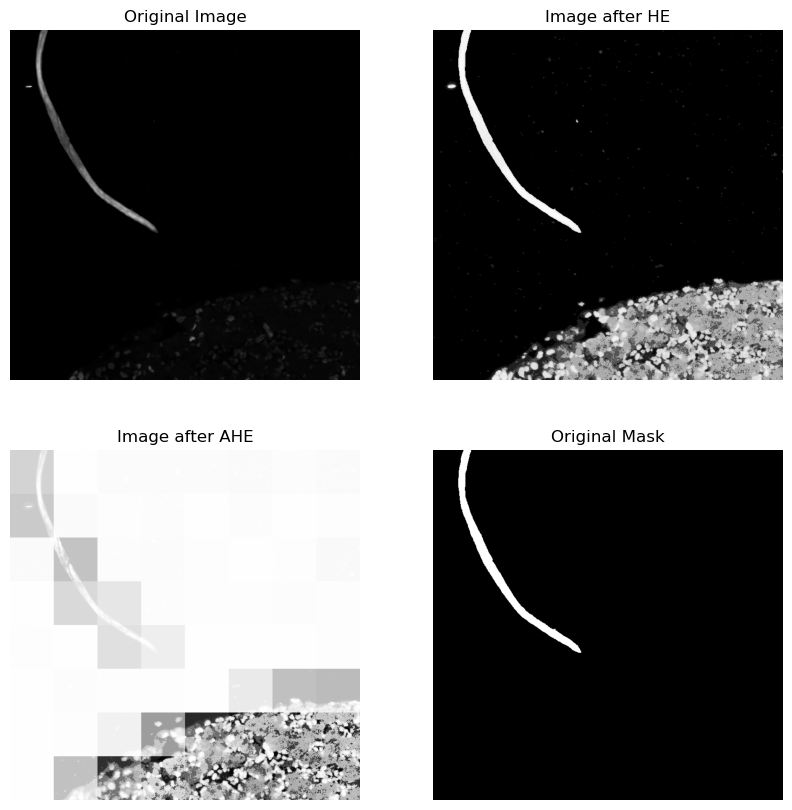

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_1.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_1_label1.png
(680, 680) (680, 680)


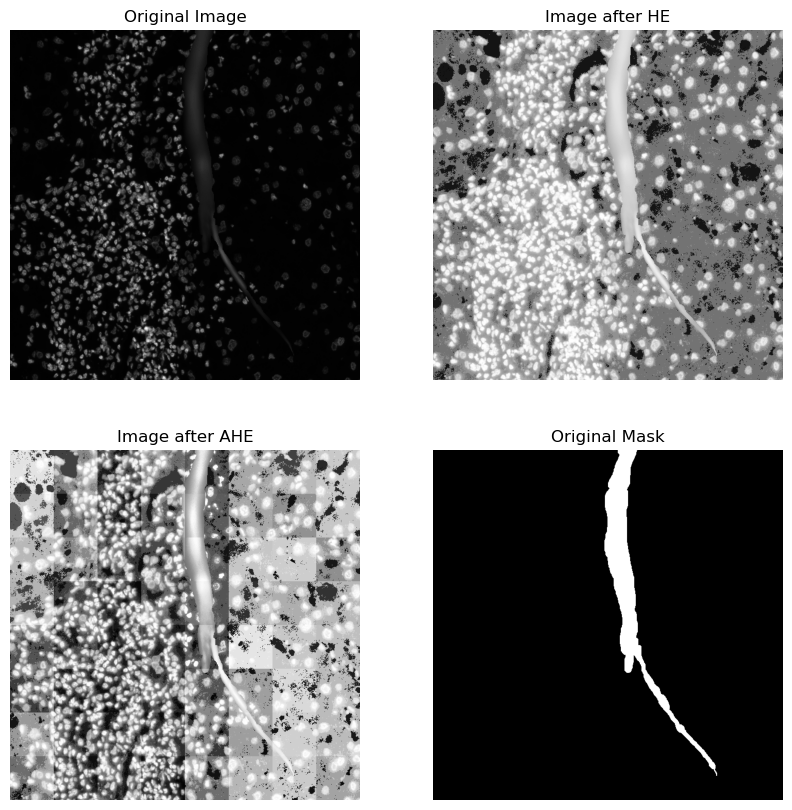

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_2.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_2_label1.png
(680, 680) (680, 680)


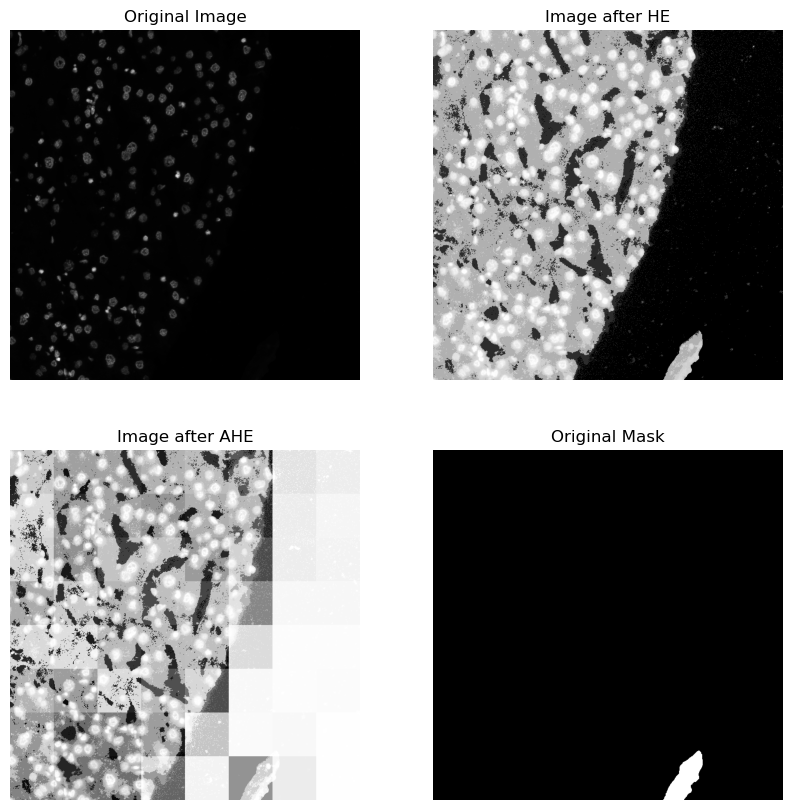

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_3.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_3_label1.png
(680, 680) (680, 680)


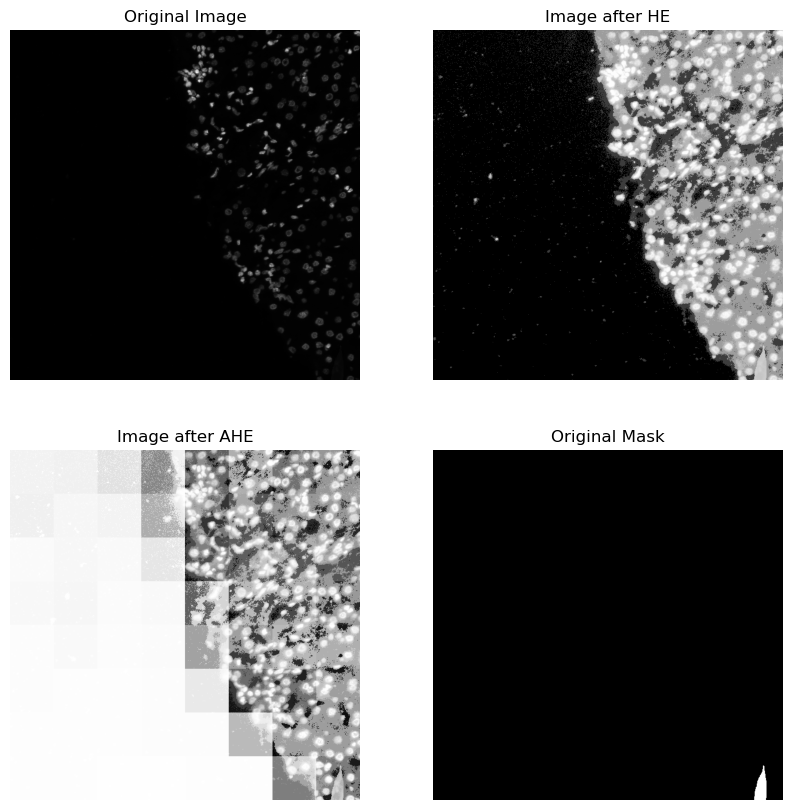

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_4.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_4_label1.png
(680, 680) (680, 680)


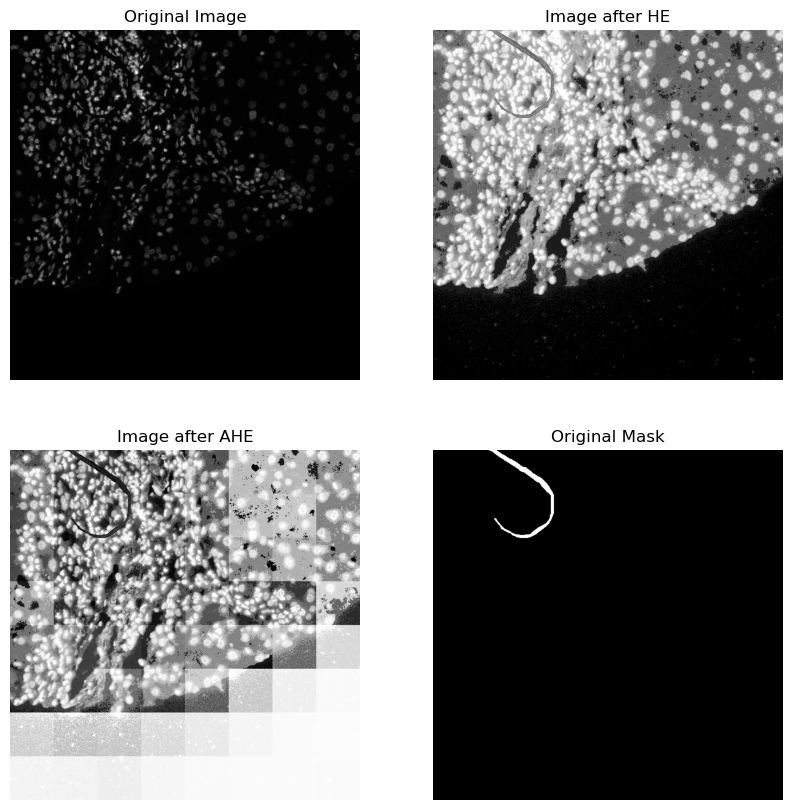

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_5.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_5_label1.png
(680, 680) (680, 680)


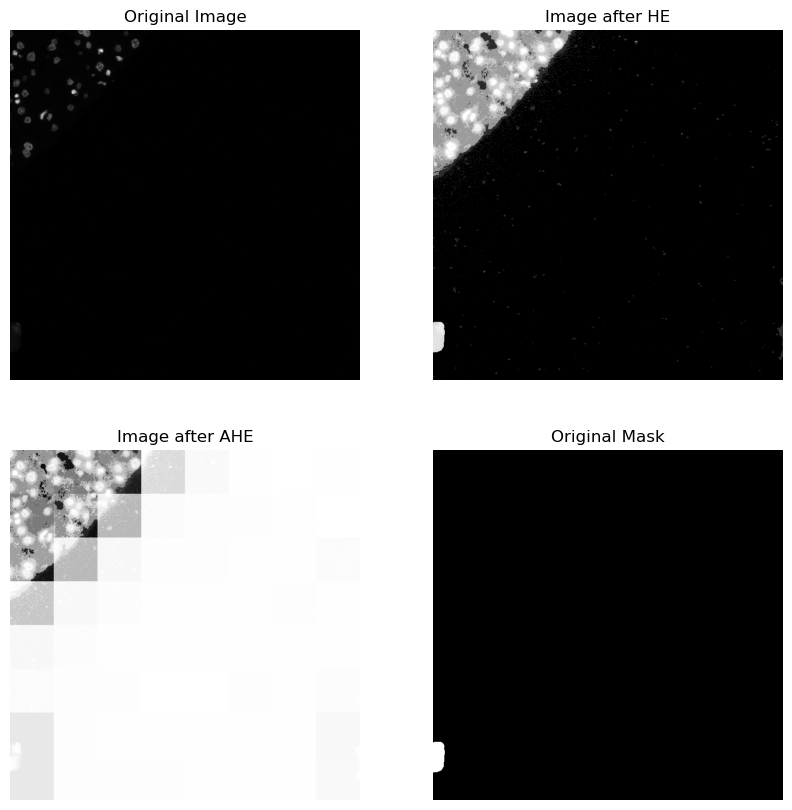

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_6.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_6_label1.png
(680, 680) (680, 680)


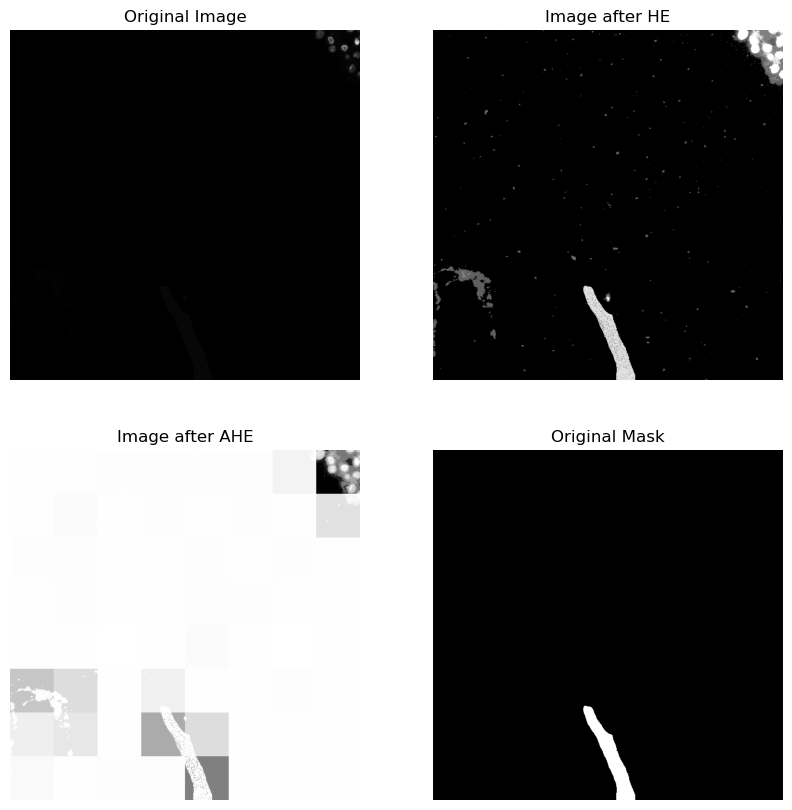

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_7.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_7_label1.png
(680, 680) (680, 680)


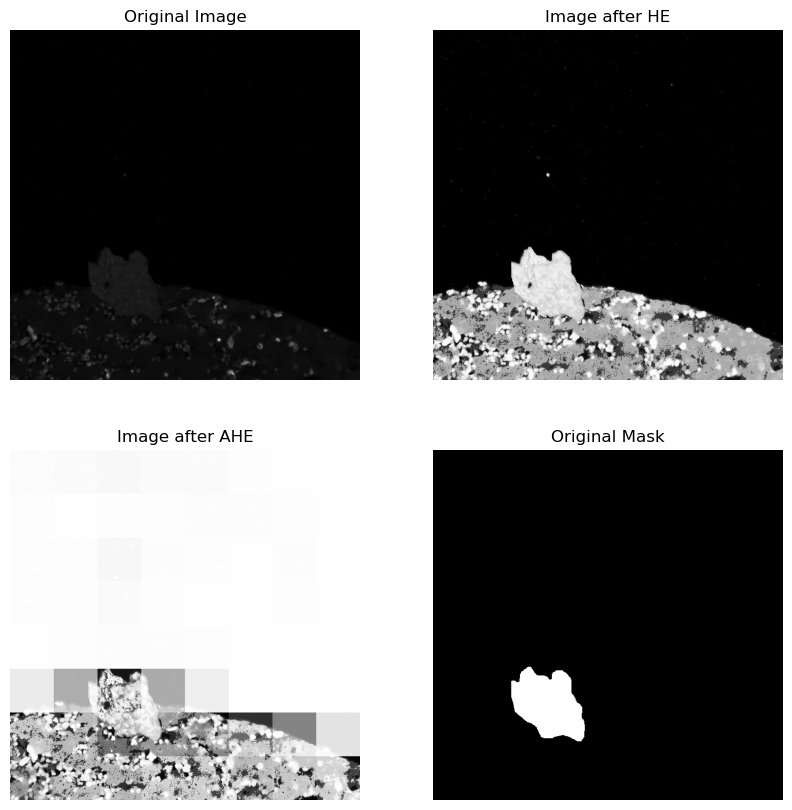

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_8.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_8_label1.png
(680, 680) (680, 680)


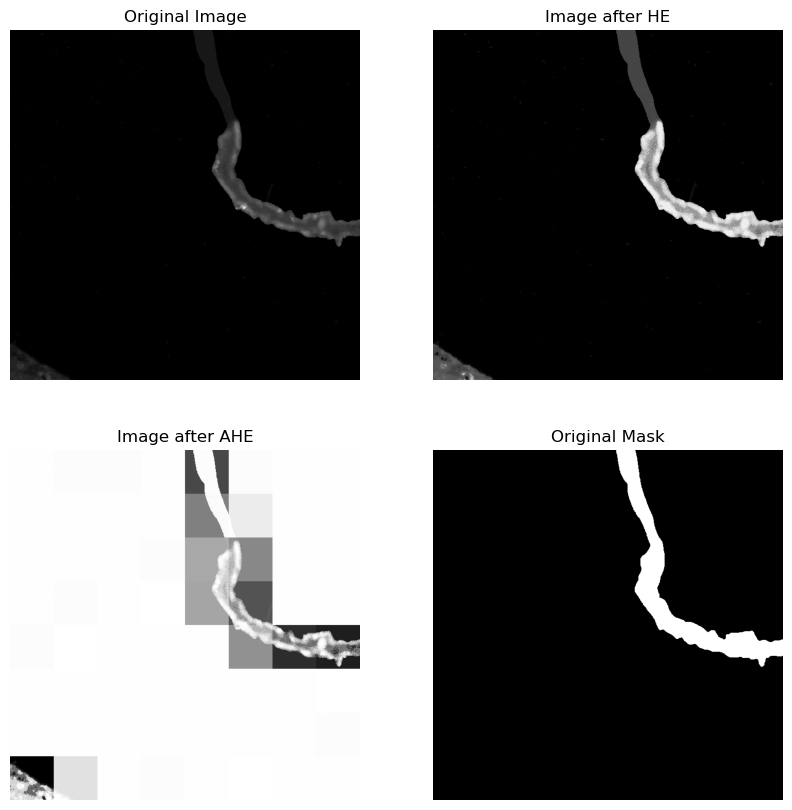

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_9.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_9_label1.png
(680, 680) (680, 680)


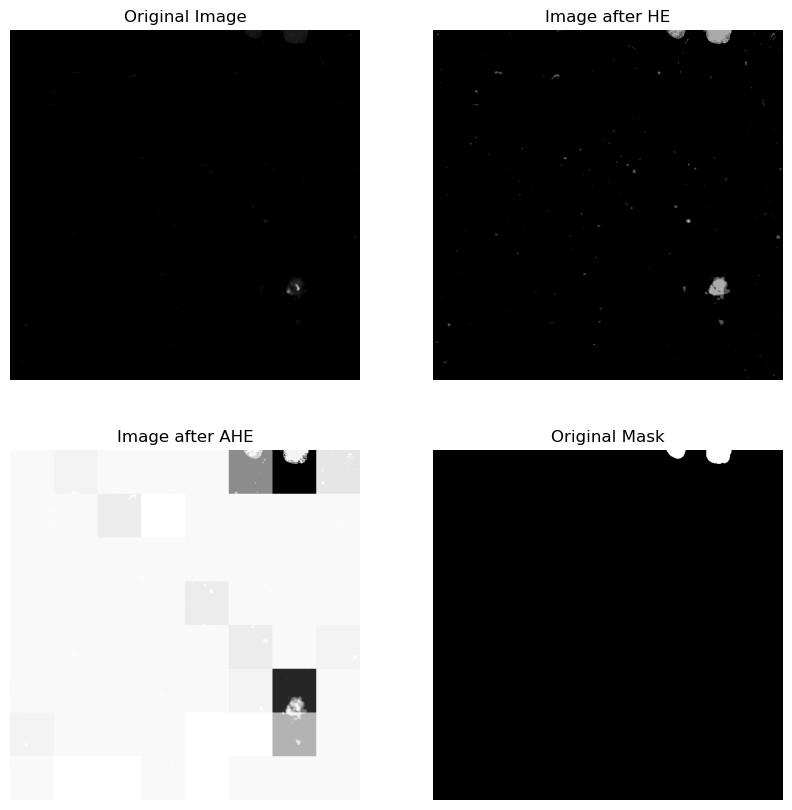

artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_1.png
artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_1_label1.png
(680, 680) (680, 680)


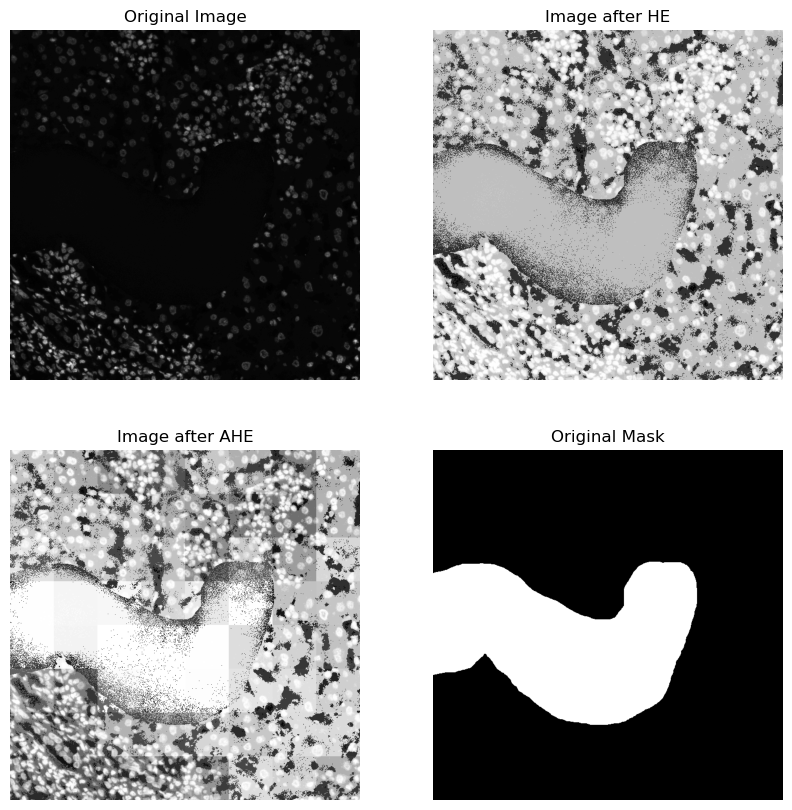

artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_2.png
artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_2_label1.png
(680, 680) (680, 680)


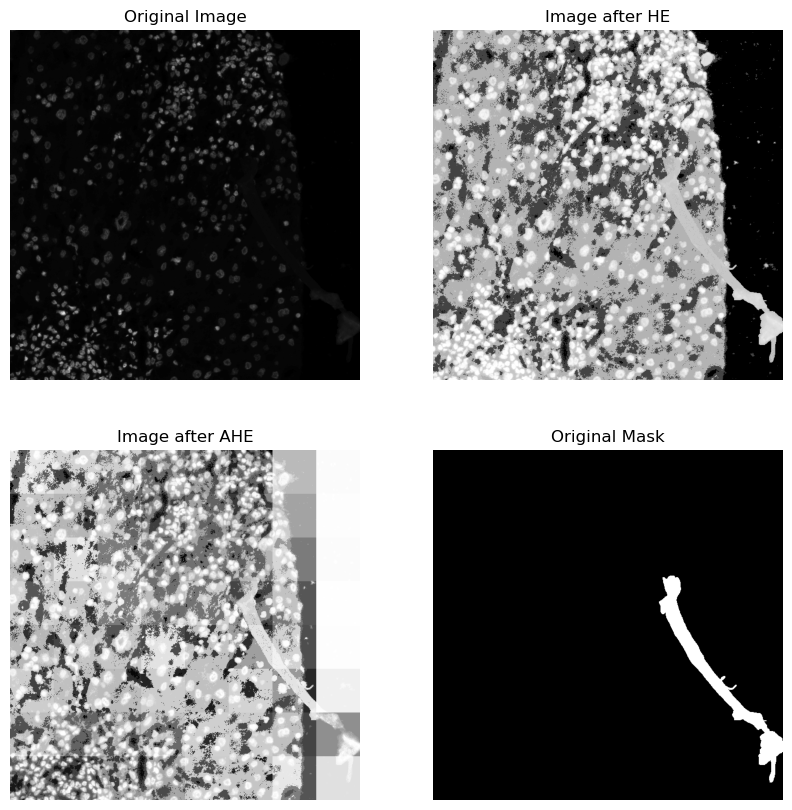

artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_3.png
artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_3_label1.png
(680, 680) (680, 680)


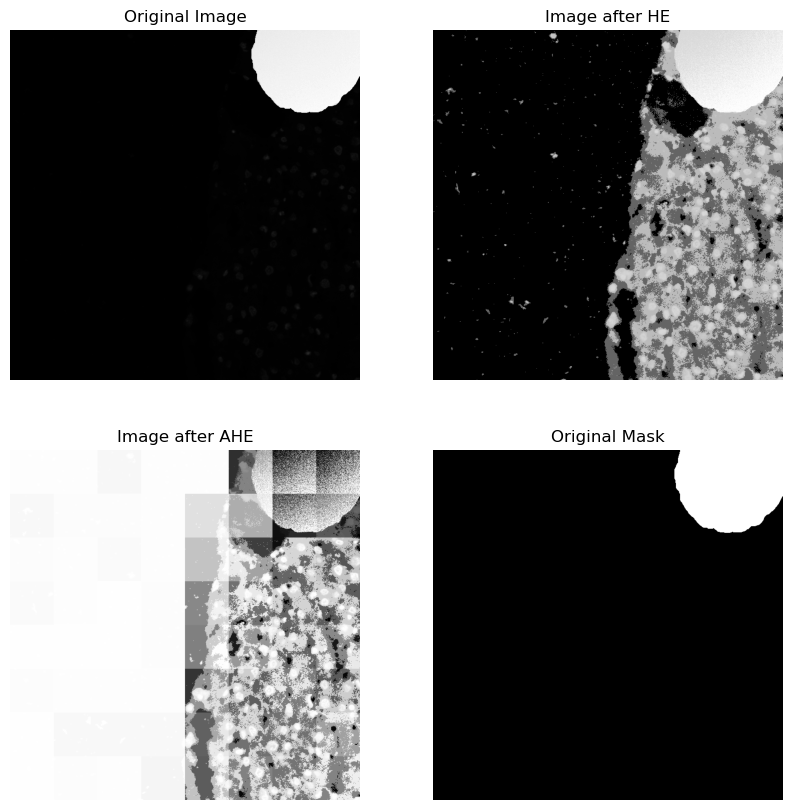

artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_4.png
artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_4_label1.png
(680, 680) (680, 680)


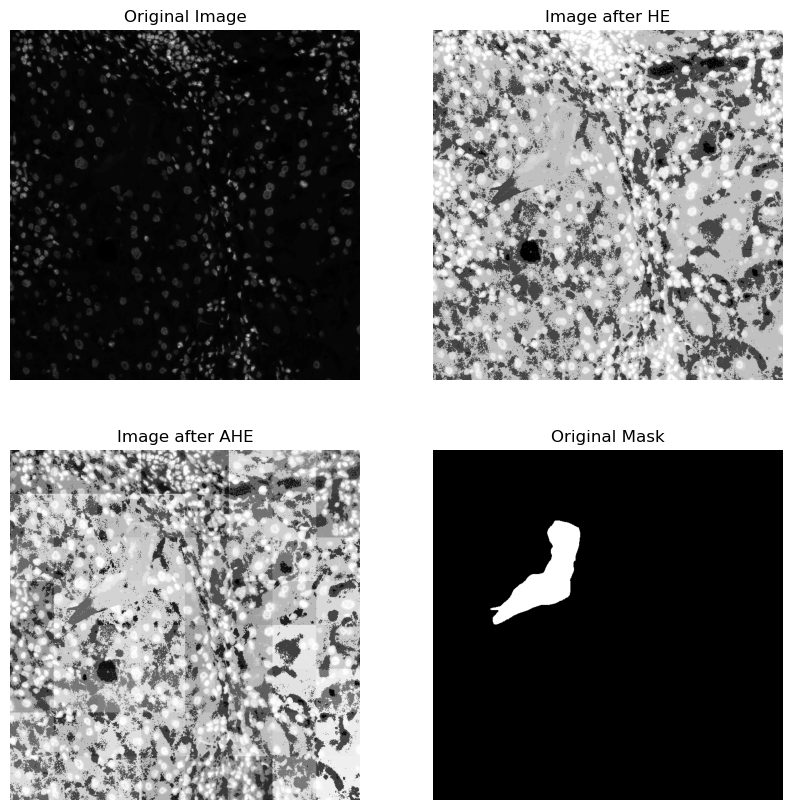

artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_5.png
artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_5_label1.png
(680, 680) (680, 680)


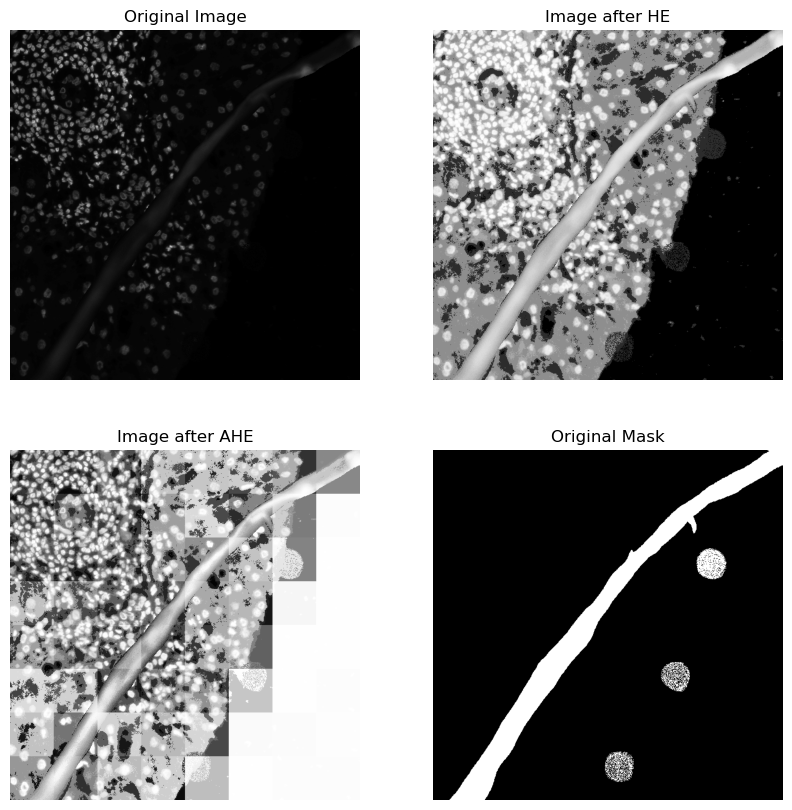

artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_6.png
artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_6_label1.png
(680, 680) (680, 680)


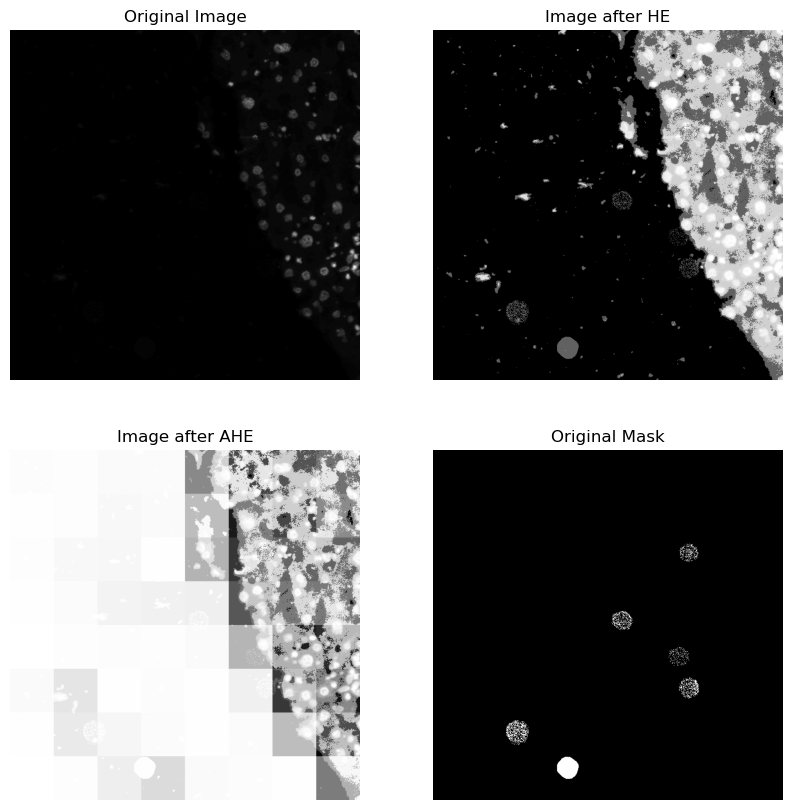

artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_7.png
artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_7_label1.png
(680, 680) (680, 680)


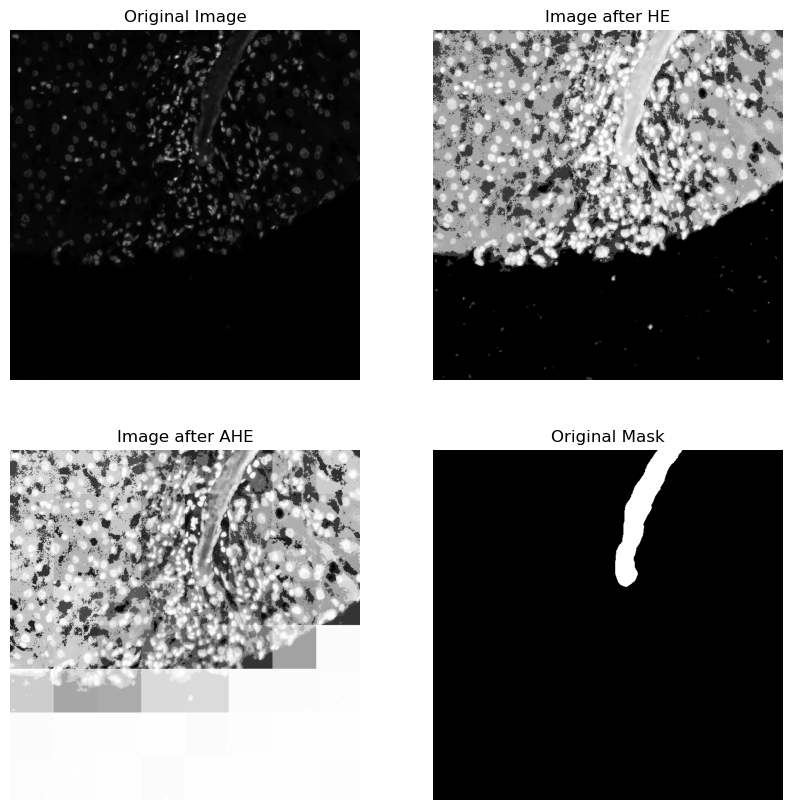

artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_8.png
artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_8_label1.png
(680, 680) (680, 680)


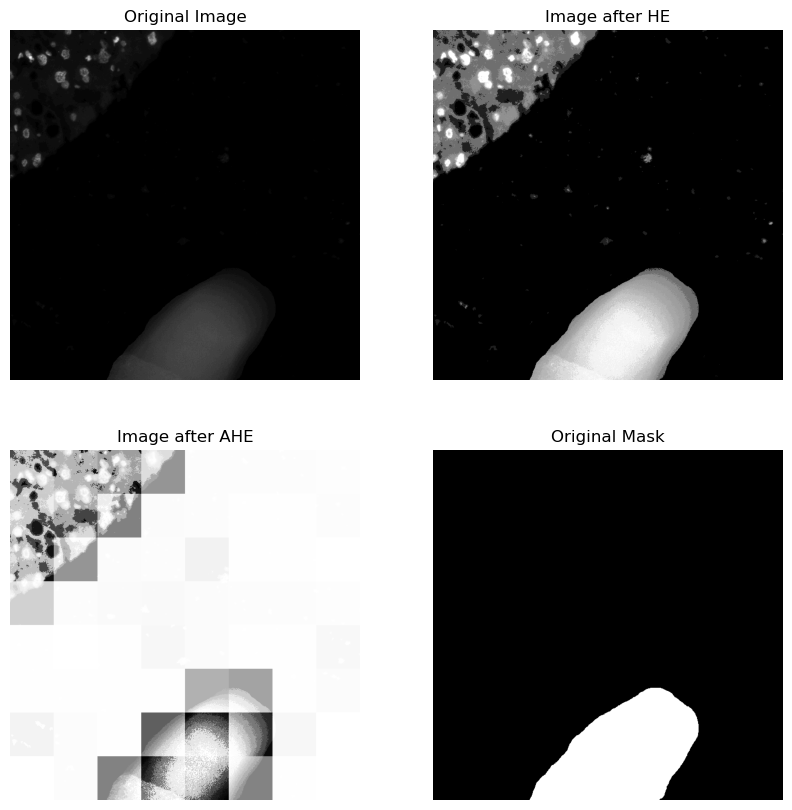

artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_9.png
artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_9_label1.png
(680, 680) (680, 680)


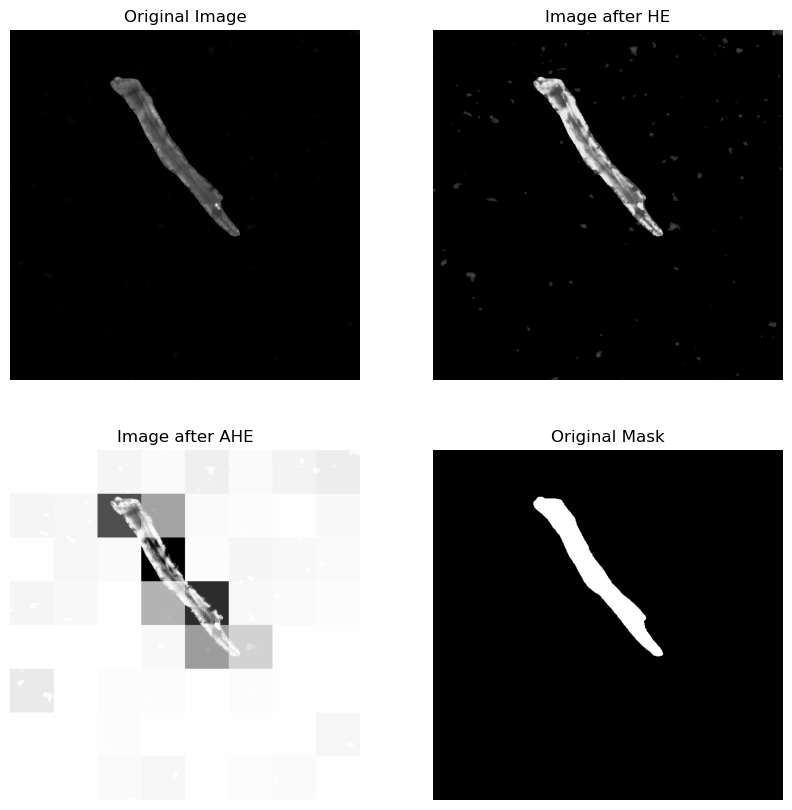

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_1.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_1_label1.png
(680, 680) (680, 680)


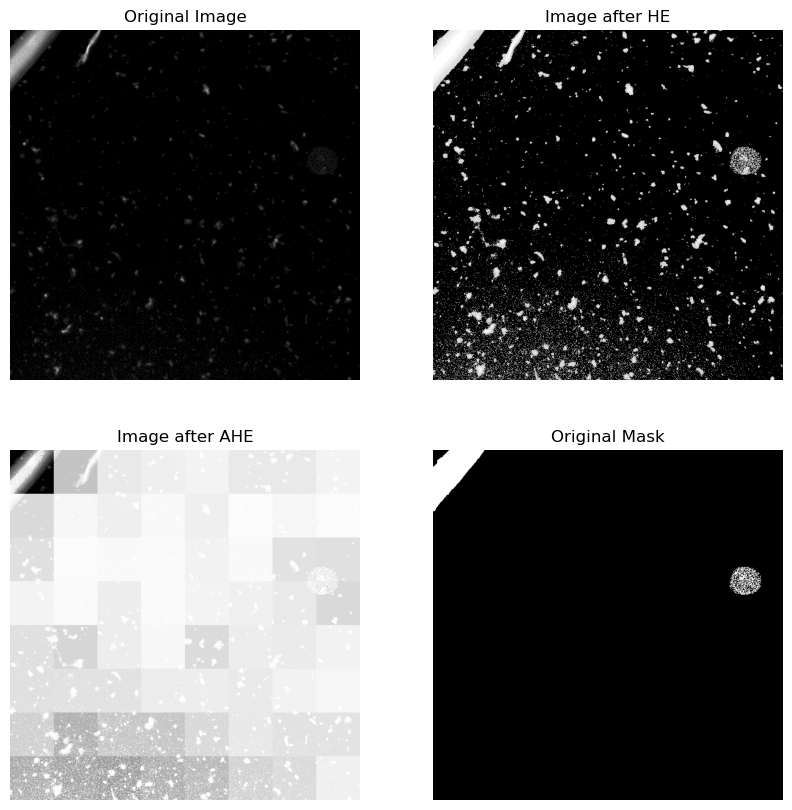

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_2.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_2_label1.png
(680, 680) (680, 680)


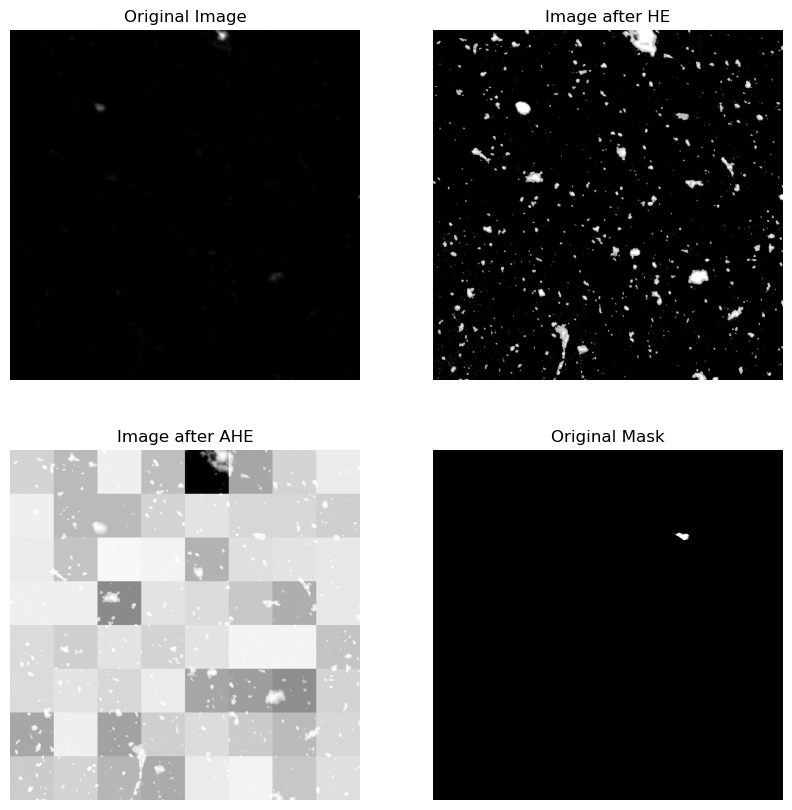

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_3.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_3_label1.png
(680, 680) (680, 680)


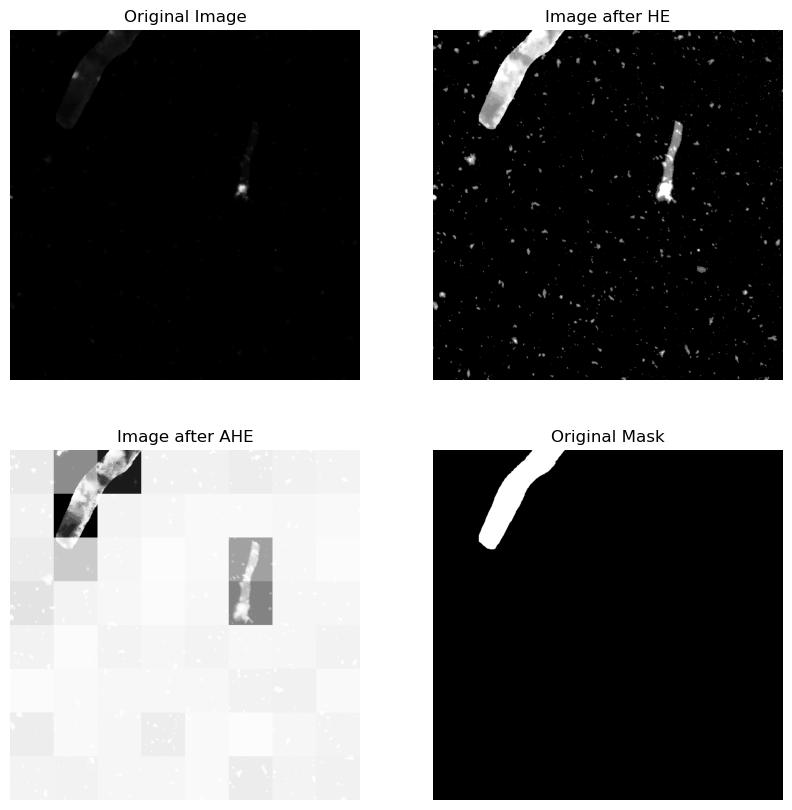

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_4.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_4_label1.png
(680, 680) (680, 680)


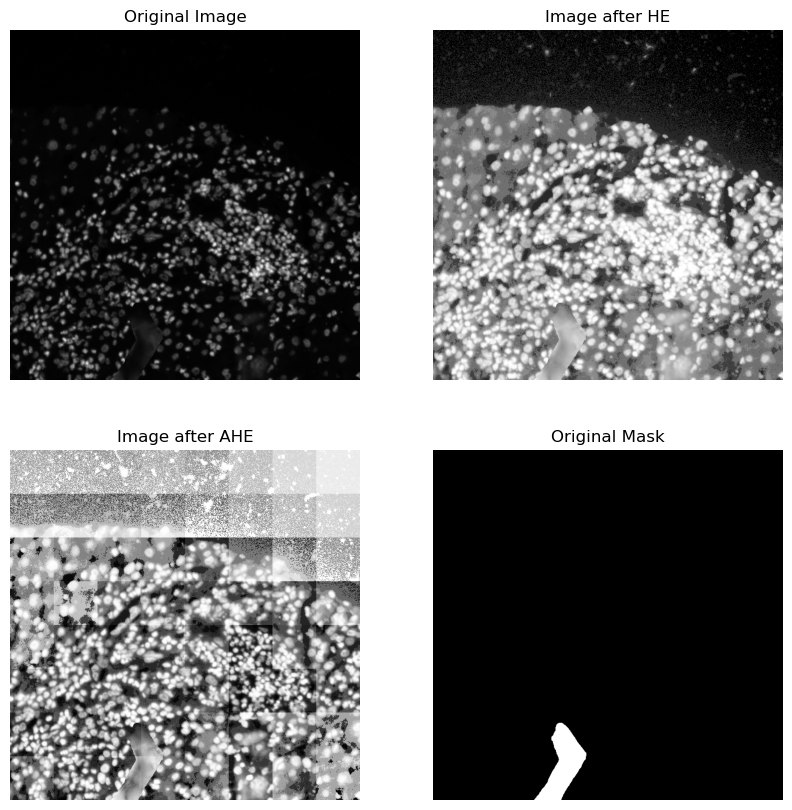

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_5.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_5_label1.png
(680, 680) (680, 680)


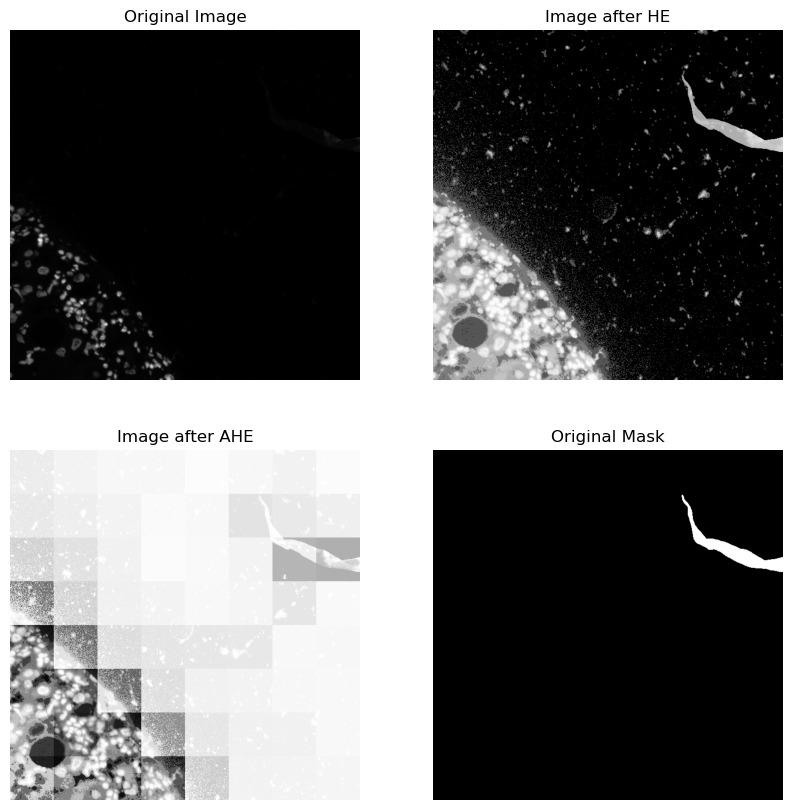

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_6.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_6_label1.png
(680, 680) (680, 680)


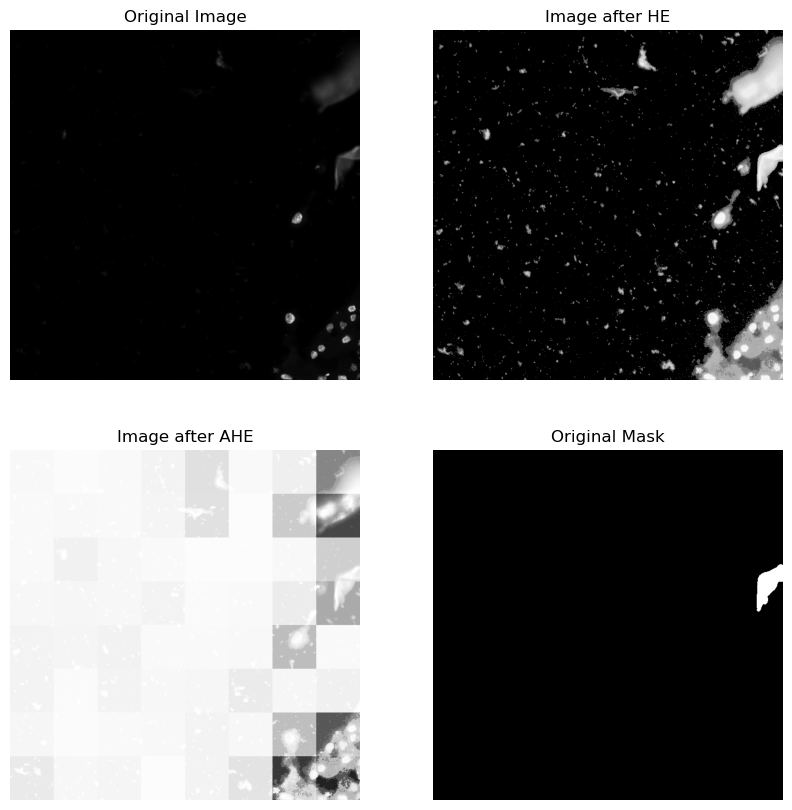

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_7.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_7_label1.png
(680, 680) (680, 680)


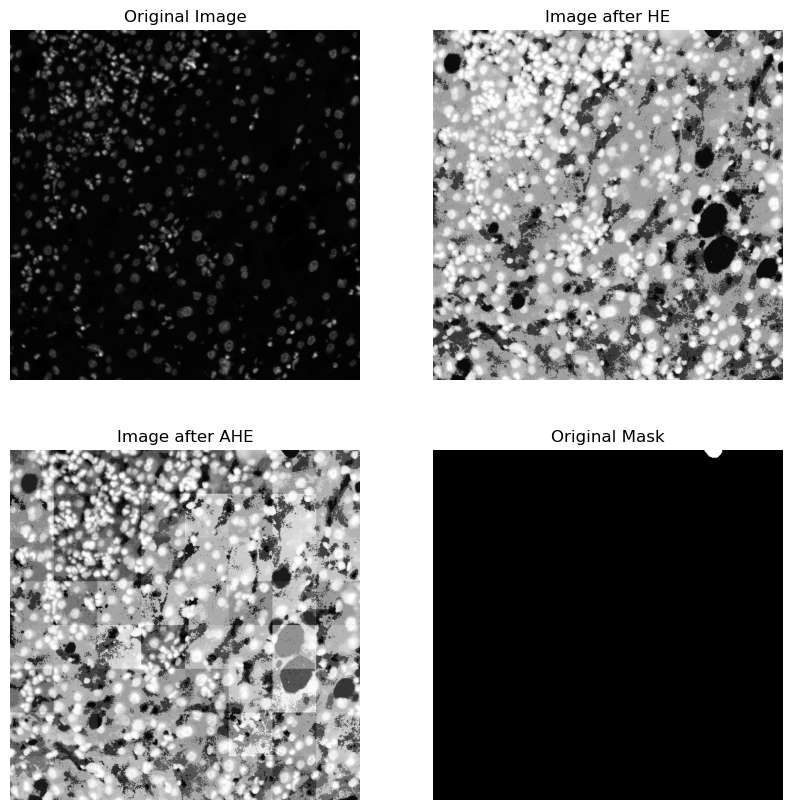

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_8.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_8_label1.png
(680, 680) (680, 680)


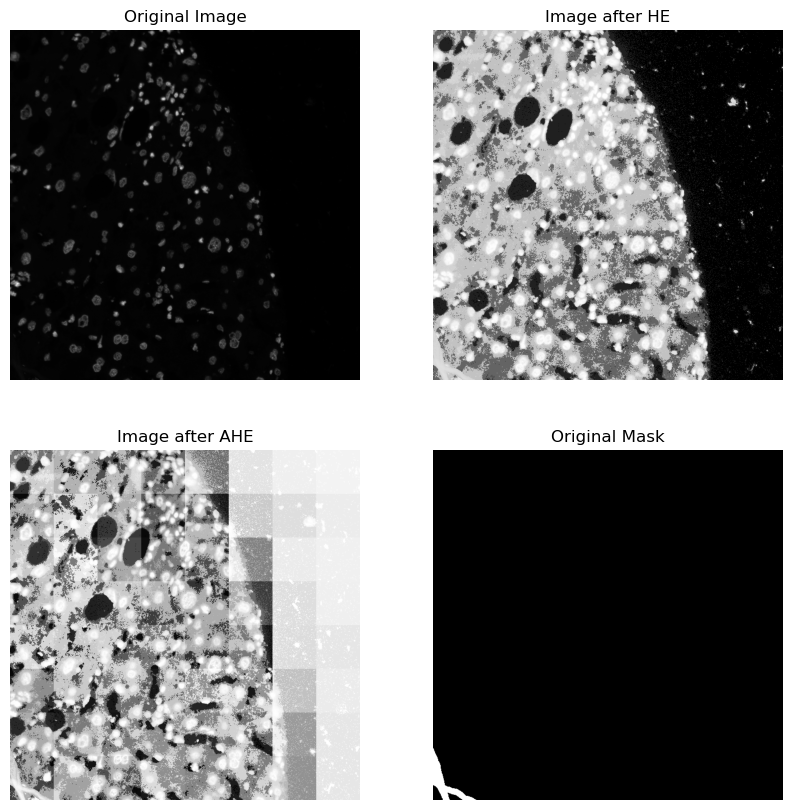

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_9.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_9_label1.png
(680, 680) (680, 680)


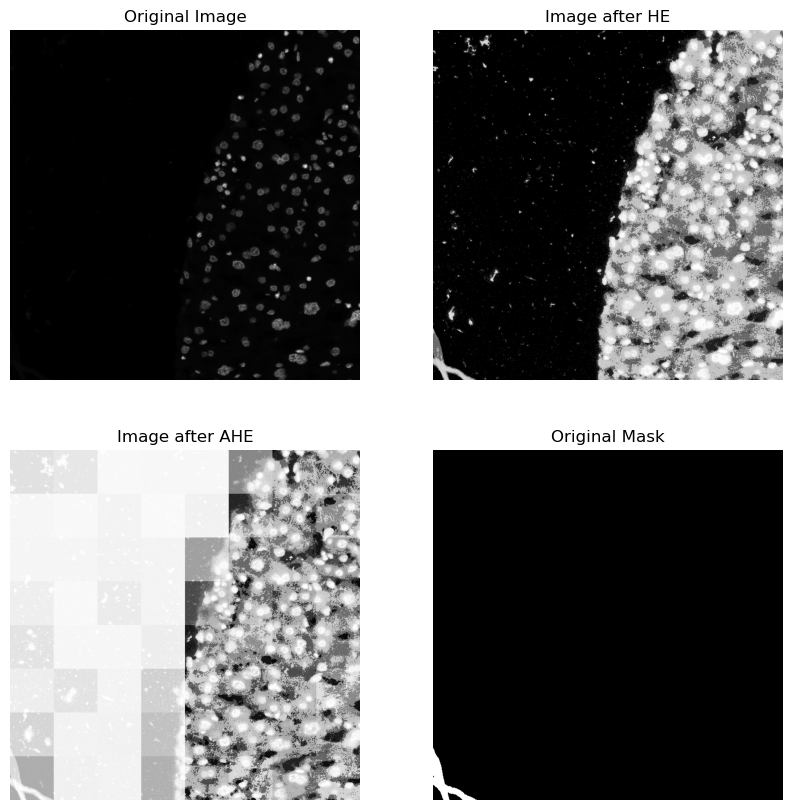

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M1_DAPI_cropped_1.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M1_DAPI_cropped_1_label1.png
(680, 680) (680, 680)


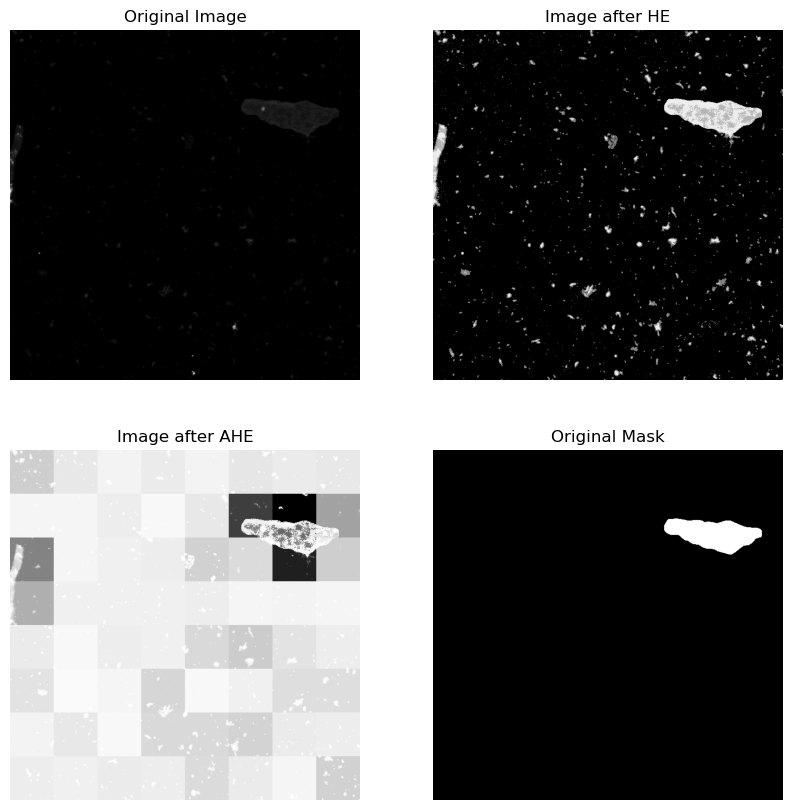

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M1_DAPI_cropped_2.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M1_DAPI_cropped_2_label1.png
(680, 680) (680, 680)


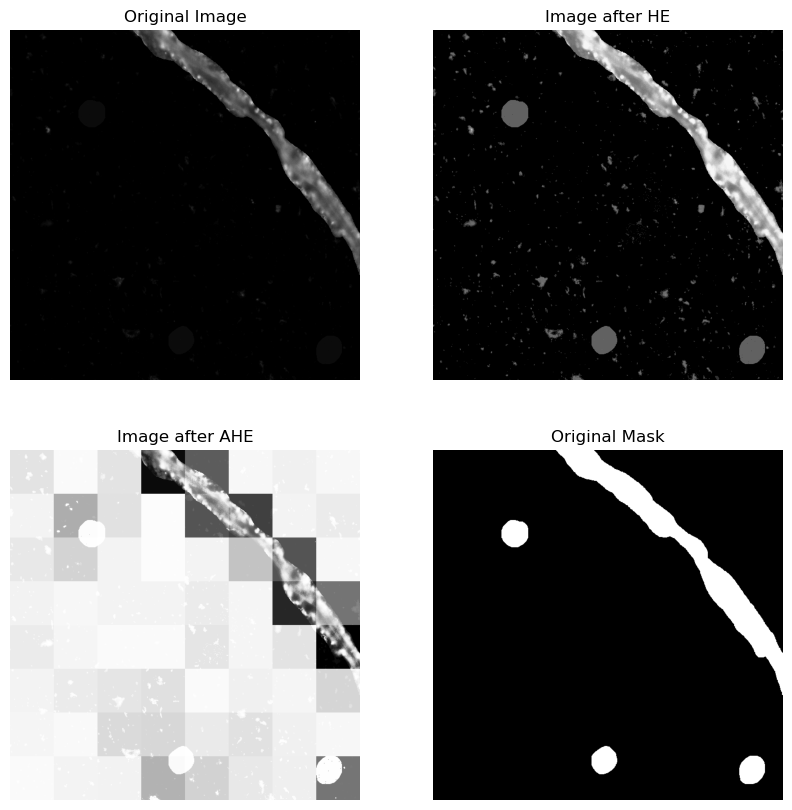

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M1_DAPI_cropped_3.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M1_DAPI_cropped_3_label1.png
(680, 680) (680, 680)


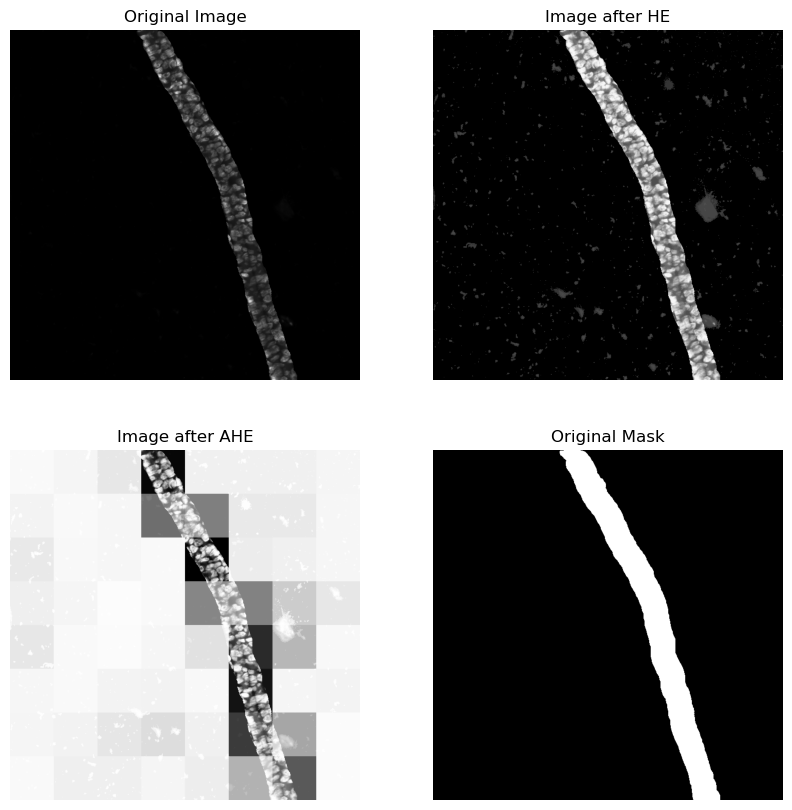

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M1_DAPI_cropped_4.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M1_DAPI_cropped_4_label1.png
(680, 680) (680, 680)


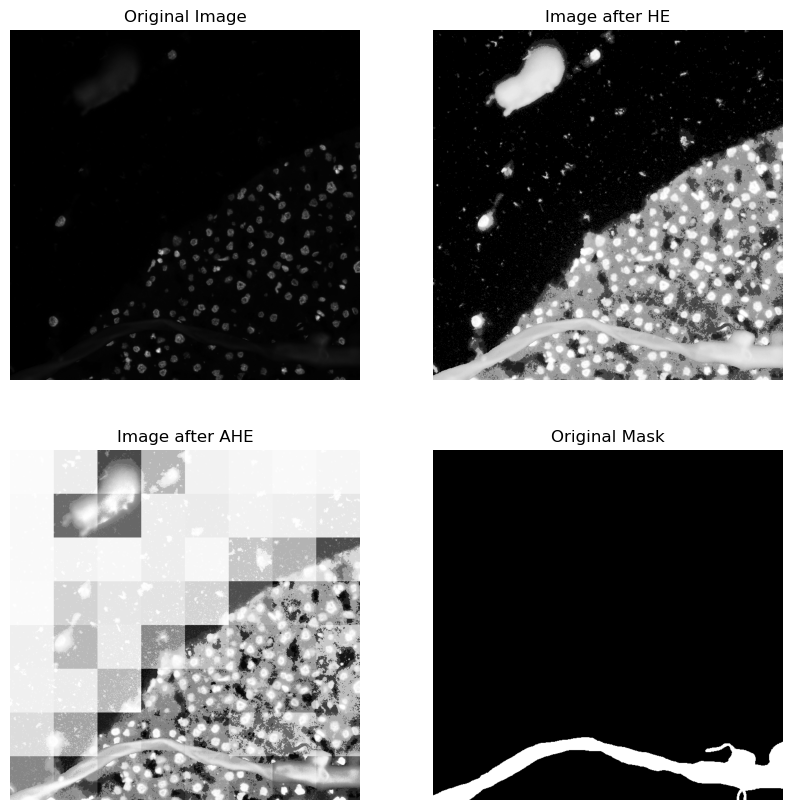

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M1_DAPI_cropped_5.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M1_DAPI_cropped_5_label1.png
(680, 680) (680, 680)


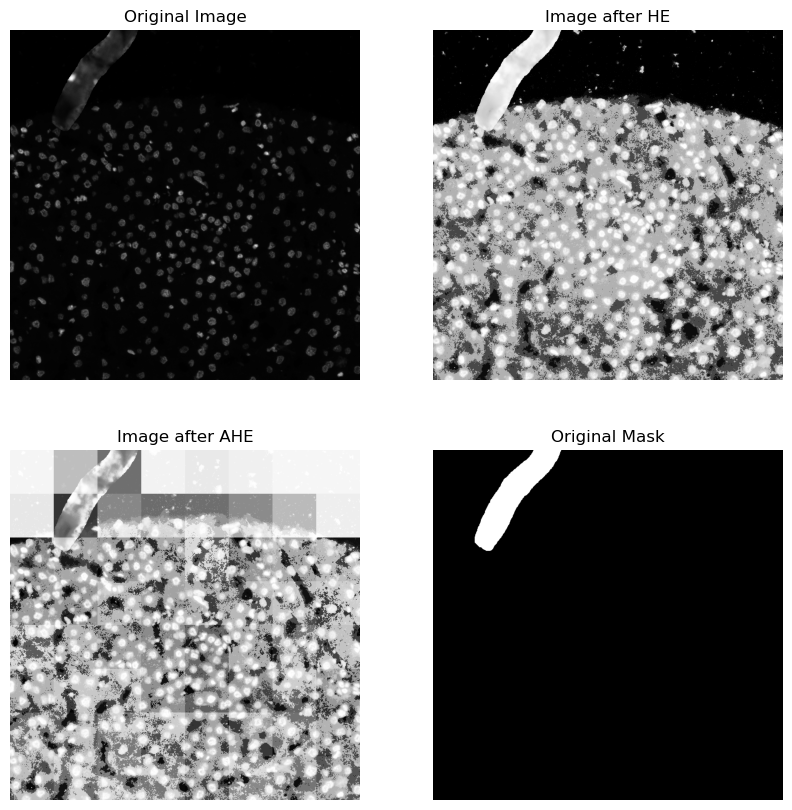

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M1_DAPI_cropped_6.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M1_DAPI_cropped_6_label1.png
(680, 680) (680, 680)


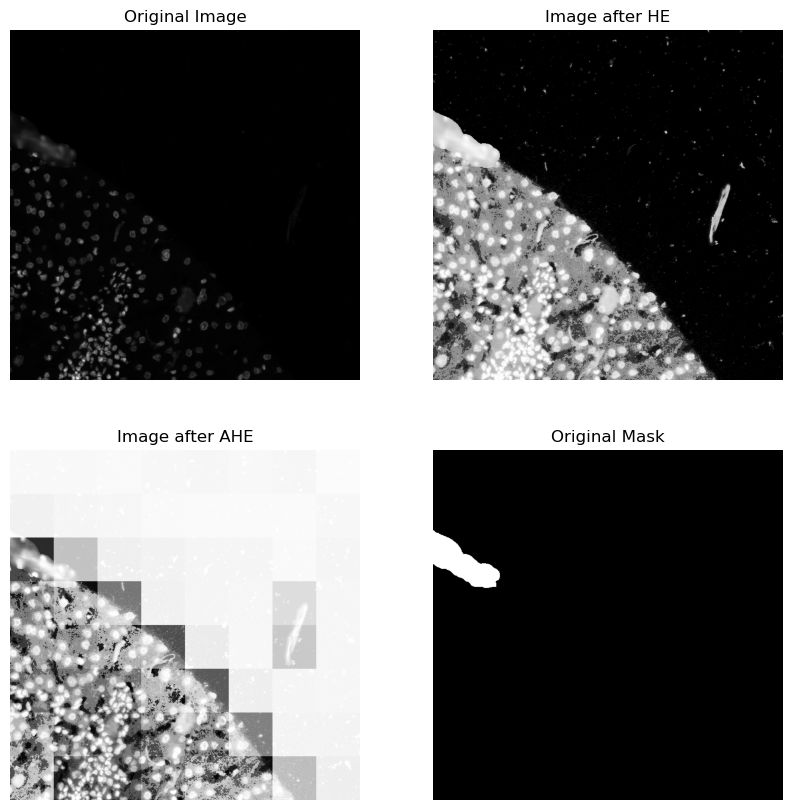

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M1_DAPI_cropped_7.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M1_DAPI_cropped_7_label1.png
(680, 680) (680, 680)


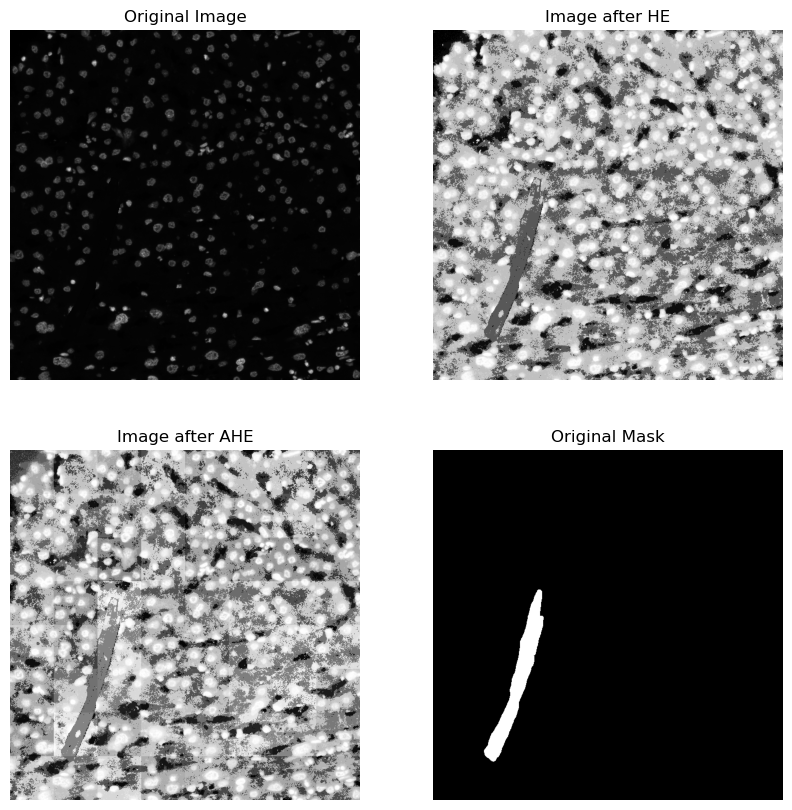

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M1_DAPI_cropped_8.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M1_DAPI_cropped_8_label1.png
(680, 680) (680, 680)


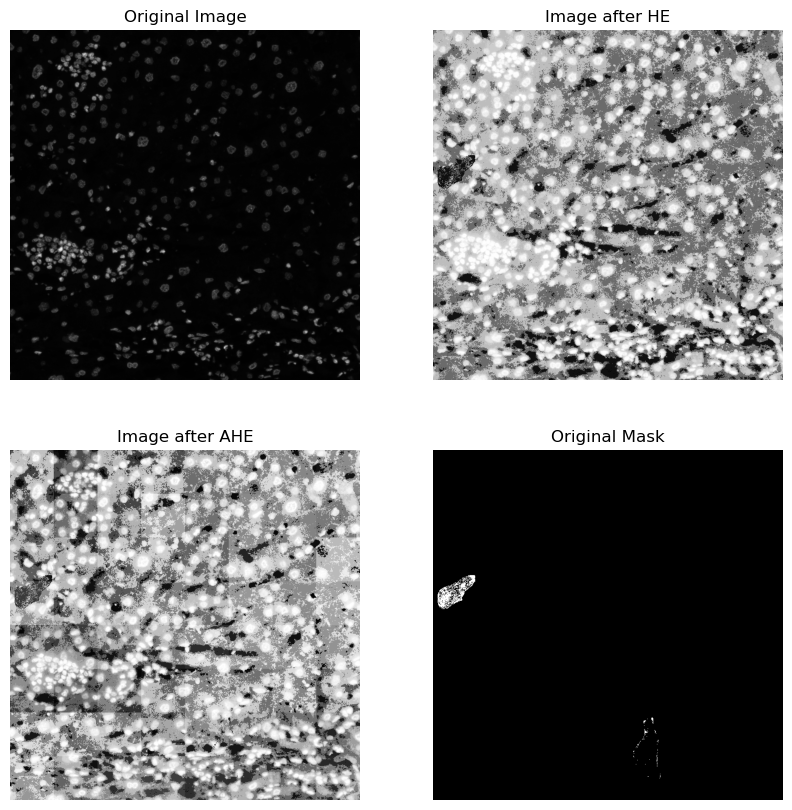

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M1_DAPI_cropped_9.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M1_DAPI_cropped_9_label1.png
(680, 680) (680, 680)


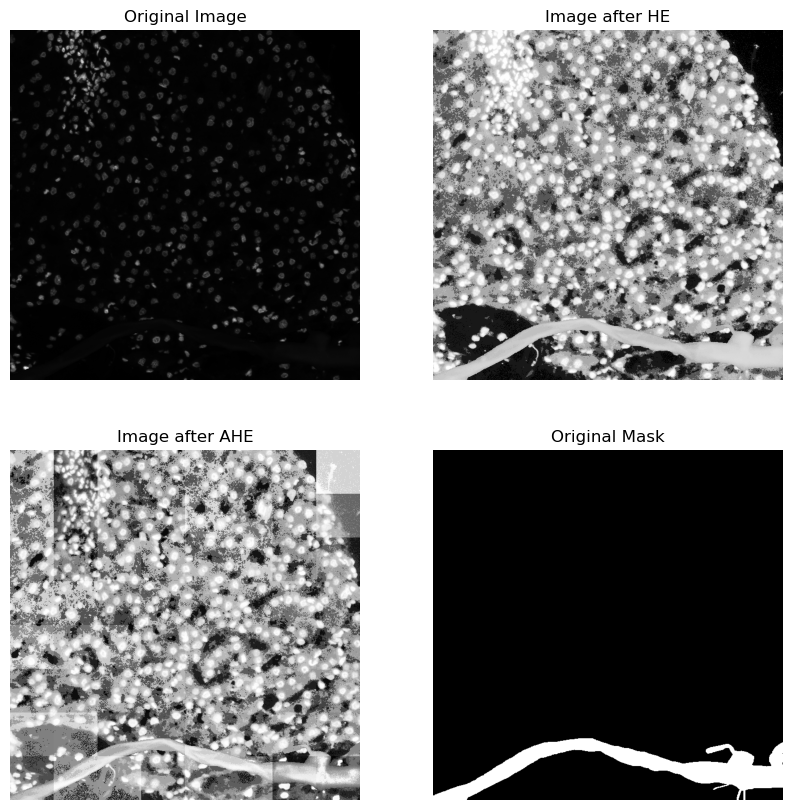

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M2_DAPI_cropped_1.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M2_DAPI_cropped_1_label1.png
(680, 680) (680, 680)


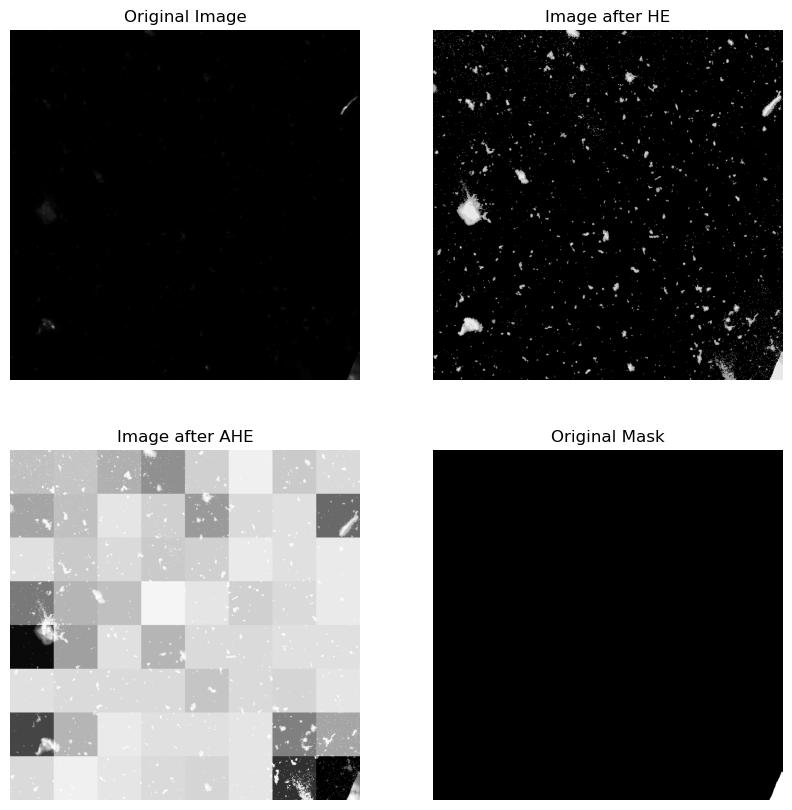

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M2_DAPI_cropped_2.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M2_DAPI_cropped_2_label1.png
(680, 680) (680, 680)


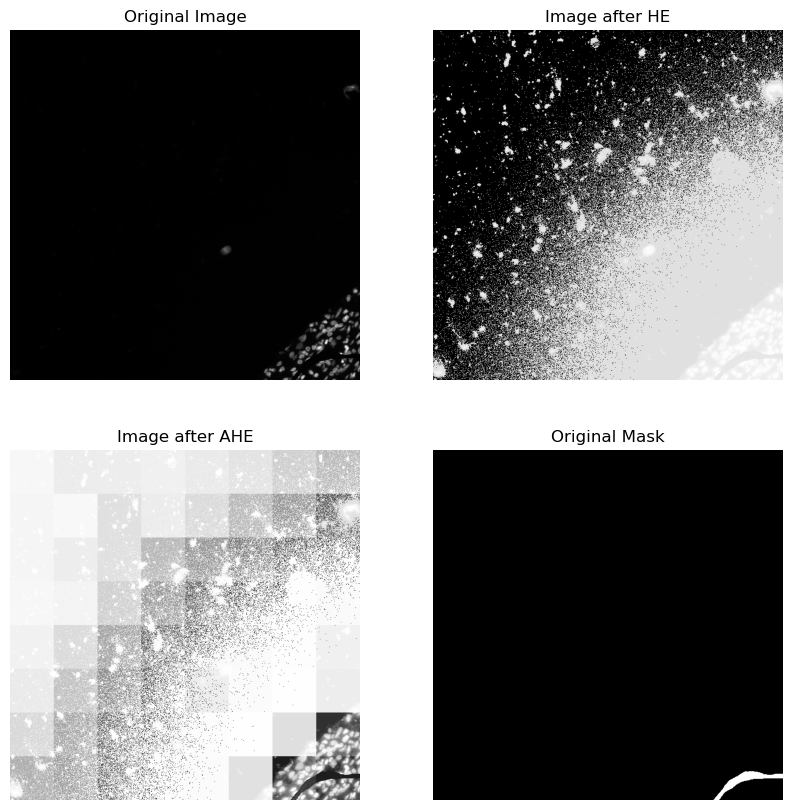

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M2_DAPI_cropped_3.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M2_DAPI_cropped_3_label1.png
(680, 680) (680, 680)


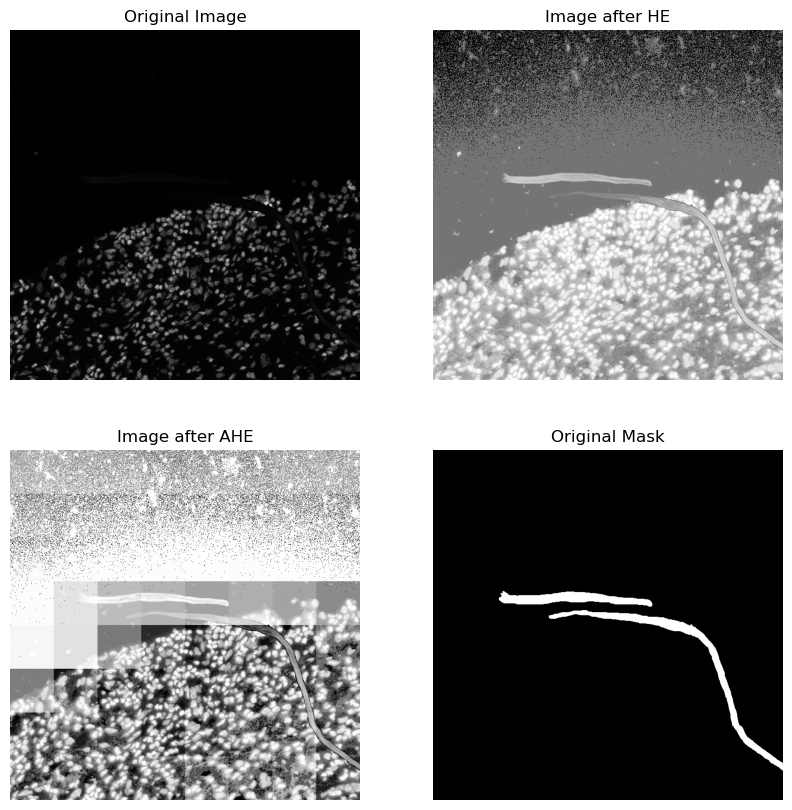

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M2_DAPI_cropped_4.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M2_DAPI_cropped_4_label1.png
(680, 680) (680, 680)


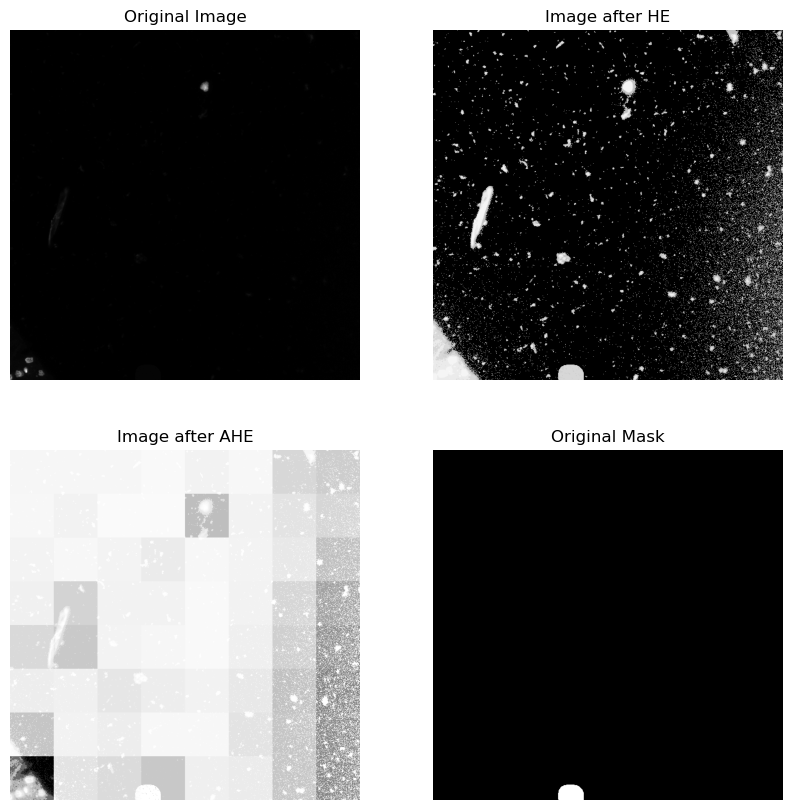

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M2_DAPI_cropped_5.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M2_DAPI_cropped_5_label1.png
(680, 680) (680, 680)


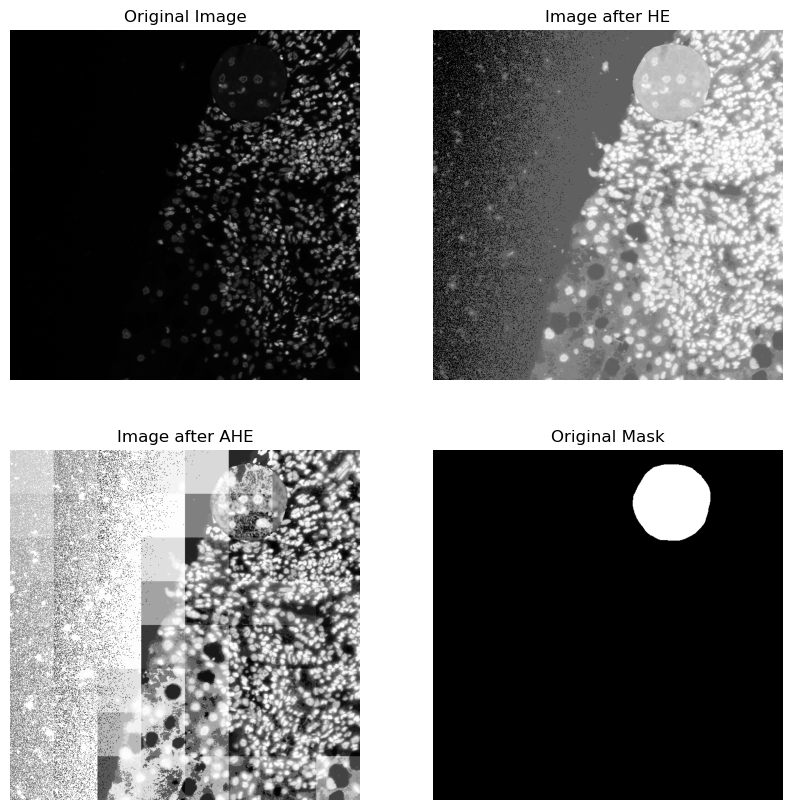

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M2_DAPI_cropped_6.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M2_DAPI_cropped_6_label1.png
(680, 680) (680, 680)


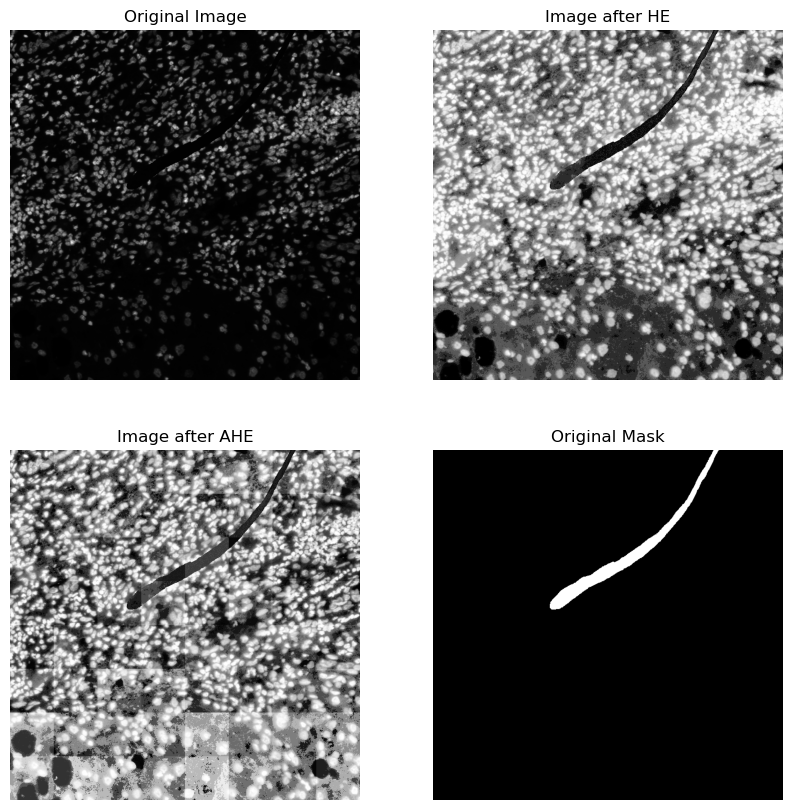

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M2_DAPI_cropped_7.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M2_DAPI_cropped_7_label1.png
(680, 680) (680, 680)


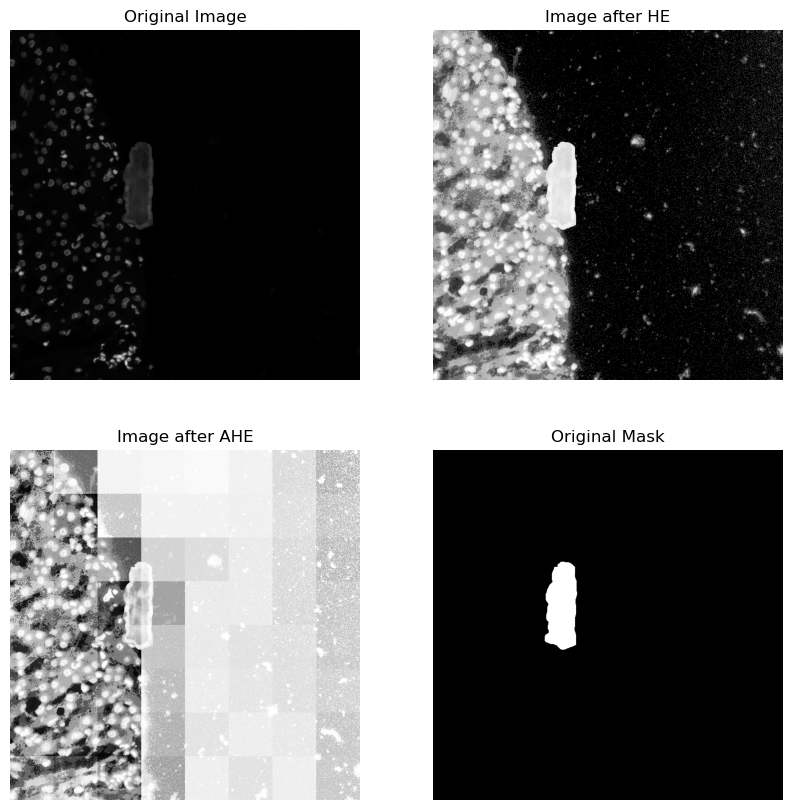

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M2_DAPI_cropped_8.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M2_DAPI_cropped_8_label1.png
(680, 680) (680, 680)


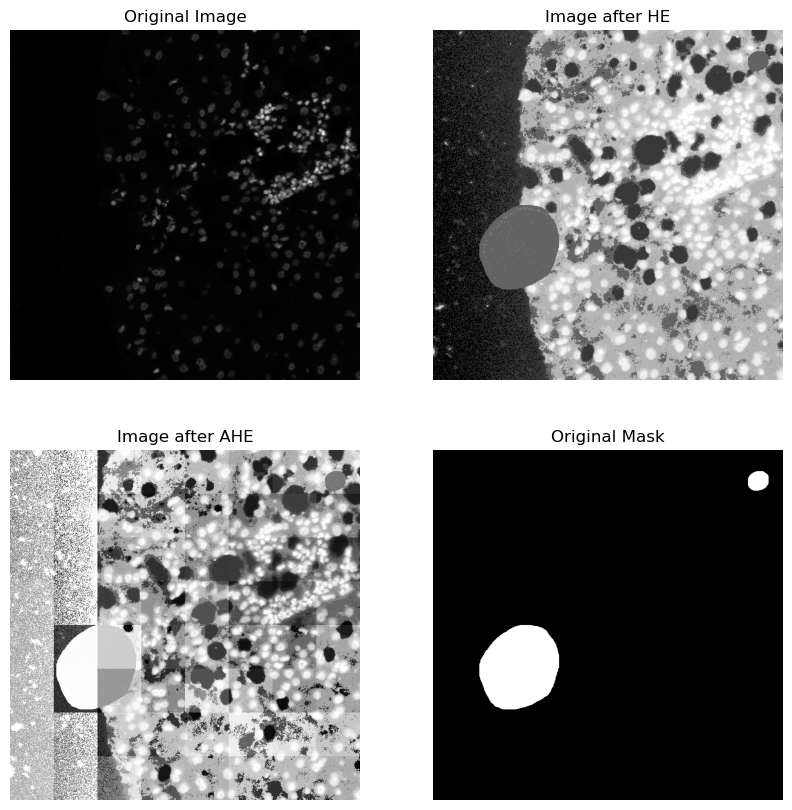

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M2_DAPI_cropped_9.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M2_DAPI_cropped_9_label1.png
(680, 680) (680, 680)


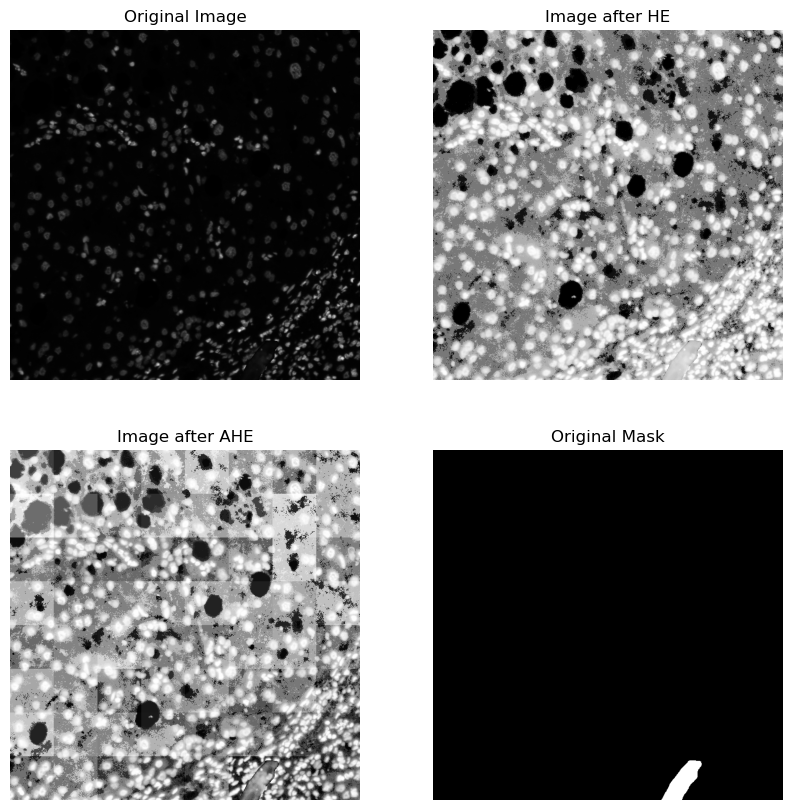

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M5_DAPI_cropped_1.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M5_DAPI_cropped_1_label1.png
(680, 680) (680, 680)


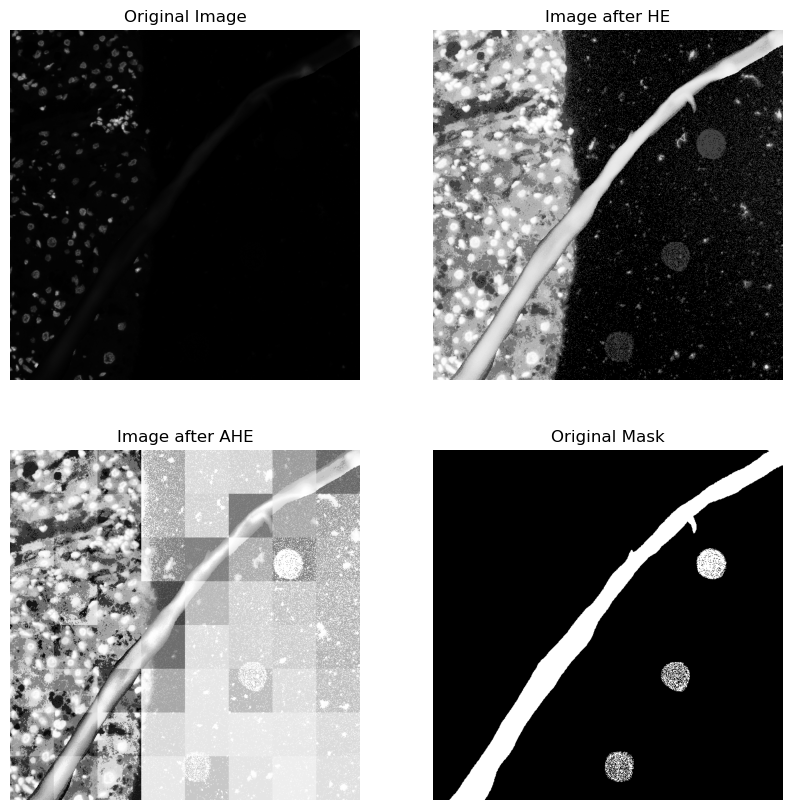

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M5_DAPI_cropped_2.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M5_DAPI_cropped_2_label1.png
(680, 680) (680, 680)


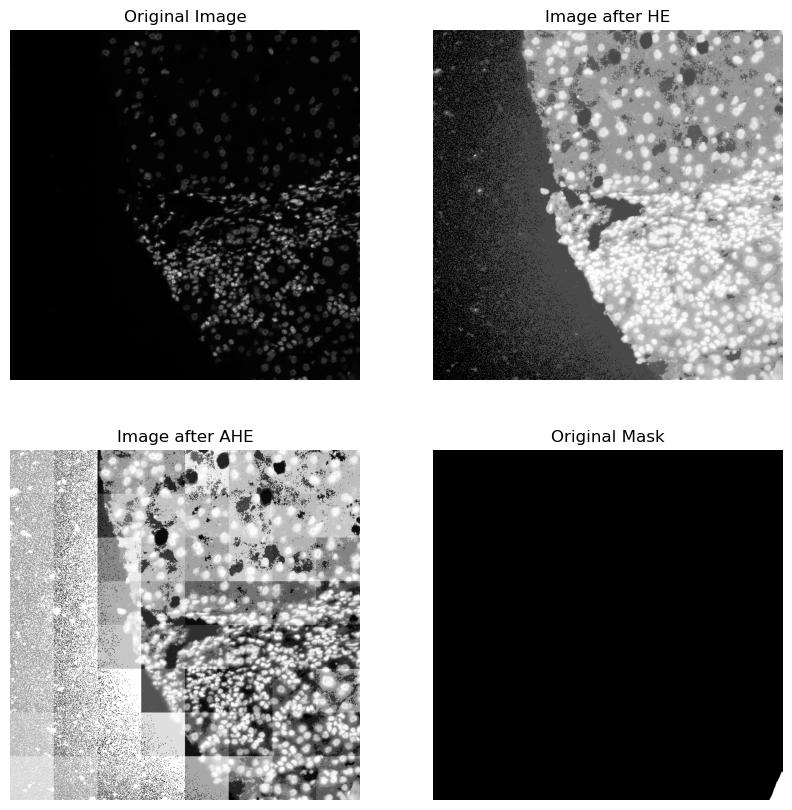

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M5_DAPI_cropped_3.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M5_DAPI_cropped_3_label1.png
(680, 680) (680, 680)


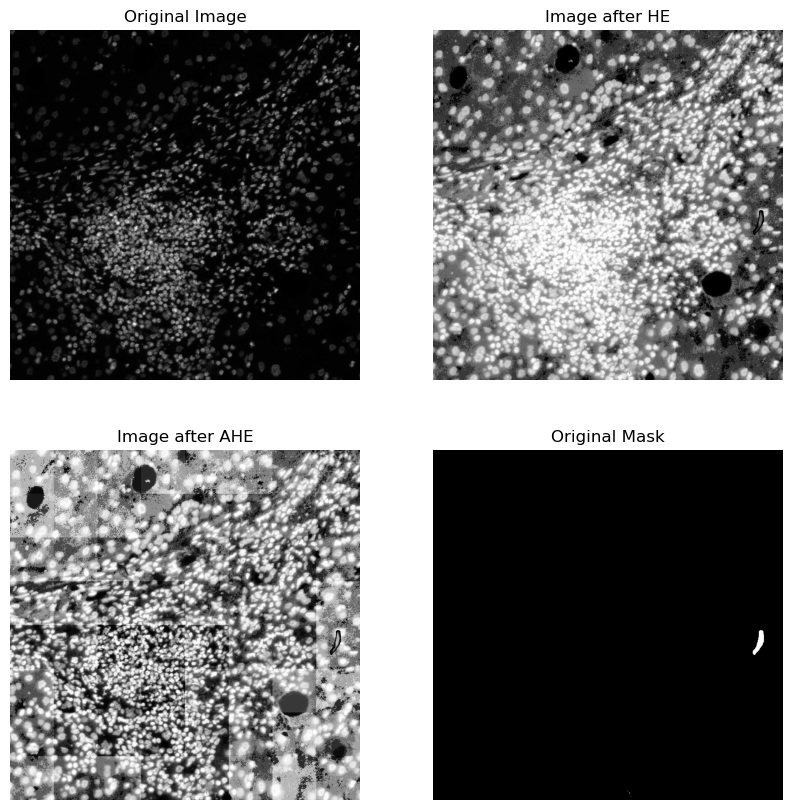

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M5_DAPI_cropped_4.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M5_DAPI_cropped_4_label1.png
(680, 680) (680, 680)


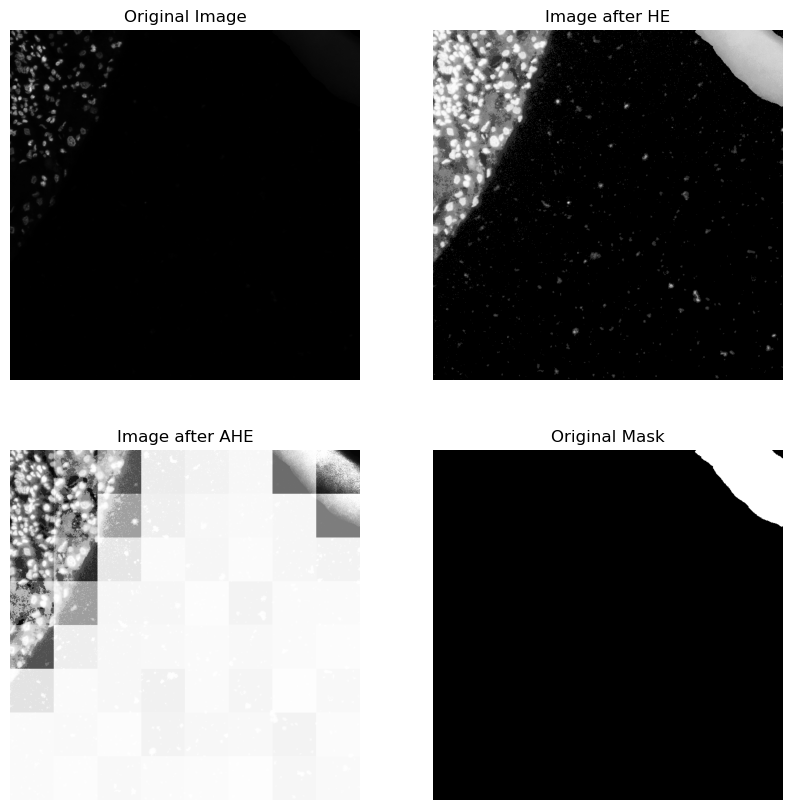

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M5_DAPI_cropped_5.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M5_DAPI_cropped_5_label1.png
(680, 680) (680, 680)


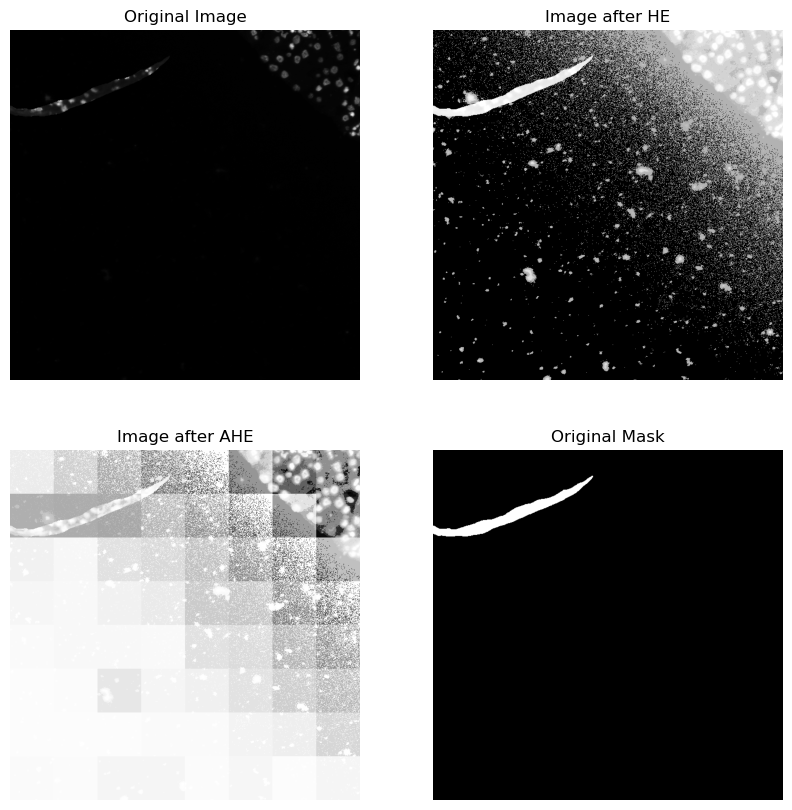

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M5_DAPI_cropped_6.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M5_DAPI_cropped_6_label1.png
(680, 680) (680, 680)


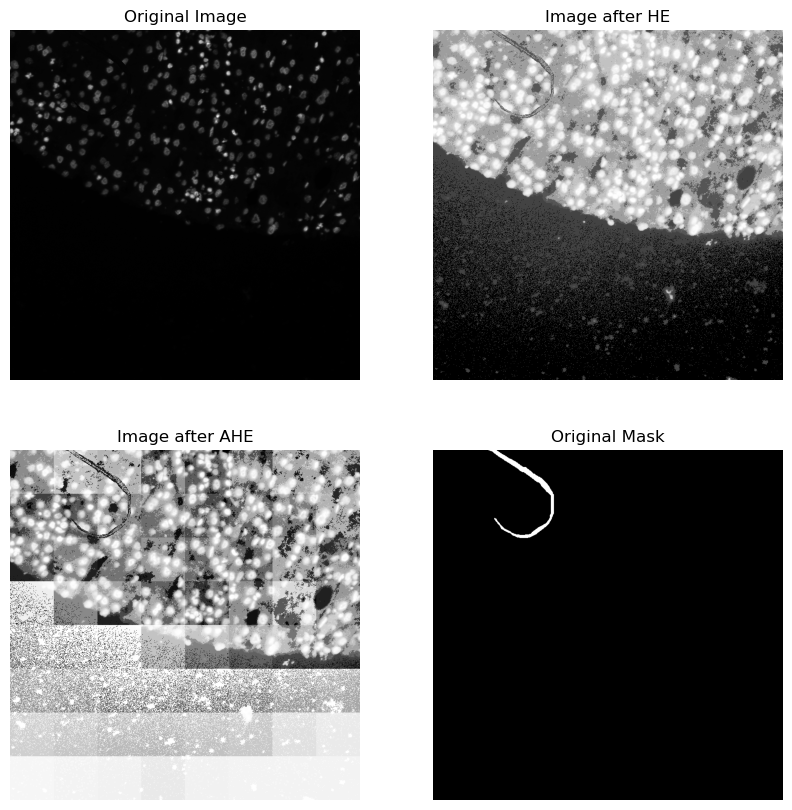

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M5_DAPI_cropped_7.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M5_DAPI_cropped_7_label1.png
(680, 680) (680, 680)


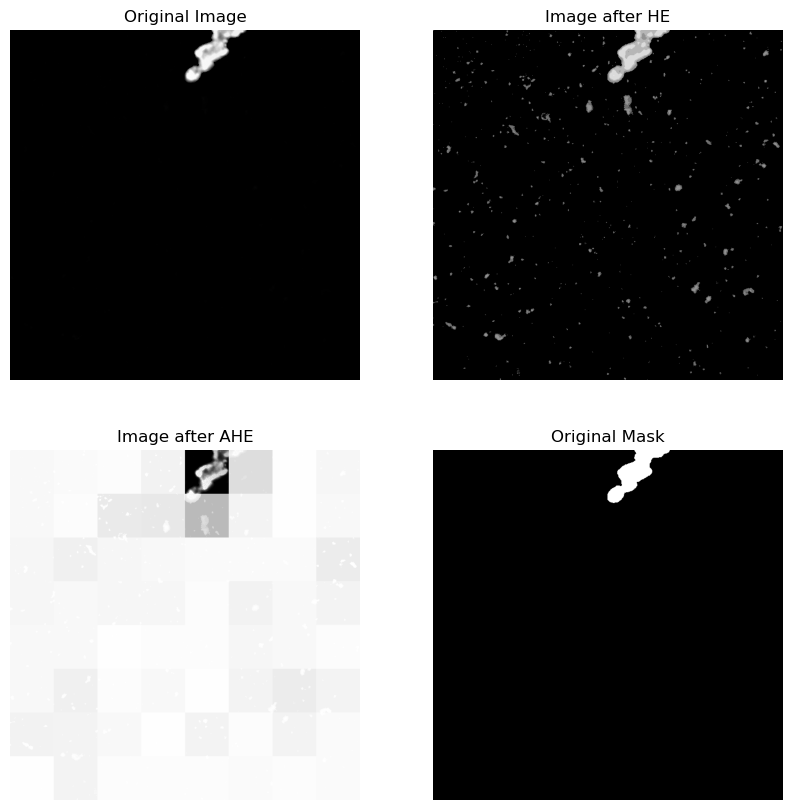

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M5_DAPI_cropped_8.png
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M5_DAPI_cropped_8_label1.png
(680, 680) (680, 680)


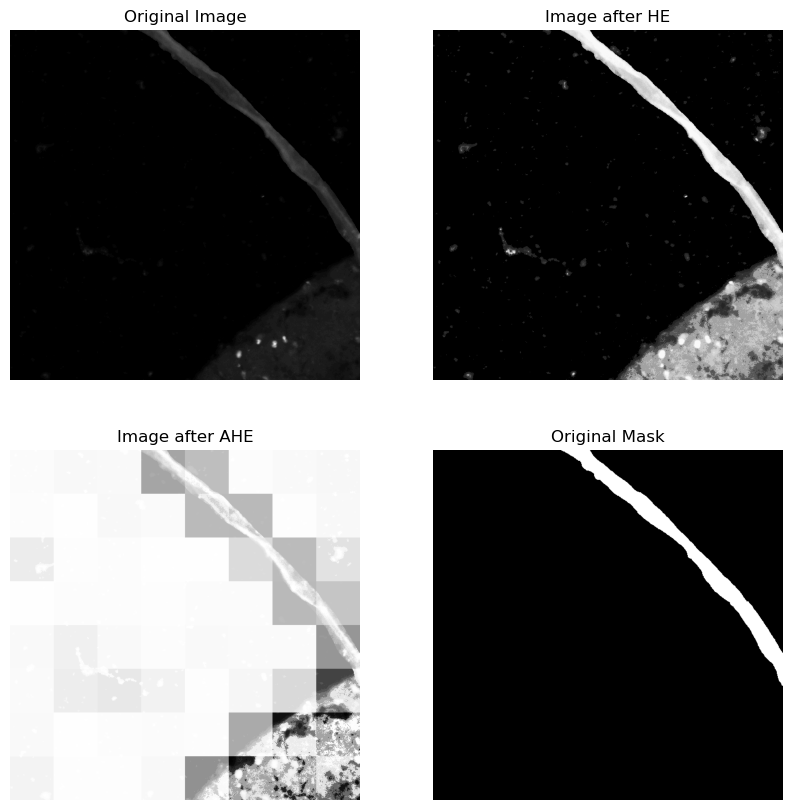

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M5_DAPI_cropped_9.png


KeyboardInterrupt: 

In [4]:
from hist_eq import *
import os
import numpy as np
from PIL import Image
from utils.data_loading import *
import cv2
import argparse
import numpy as pb
import glob
from augmentation import *




    
file_path = 'data/extra/images' 

    
k=0

for image in os.listdir(file_path):
    print(image)
    img = Image.open(f'{file_path}/{image}')
    # Original file name
    
    img = np.array(img)
# Split the original filename into its base name and extension
    base_name, extension = image.rsplit('.', 1)

# New file name with label
    new_filename = f'{base_name}_label1.{extension}'
    print(new_filename)


    mask=Image.open(f'data/extra/masks/{new_filename}')
    mask=np.array(mask)
    
    hist= hist_equalization(img)
        # Merge back the channel
    clahe1=clahe(img)

    ahe_img = ahe(img)
   
    print(hist.shape, ahe_img.shape)
        
    
    visualize(img, hist, ahe_img, mask)
  
       
    
  




artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_2.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_2_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


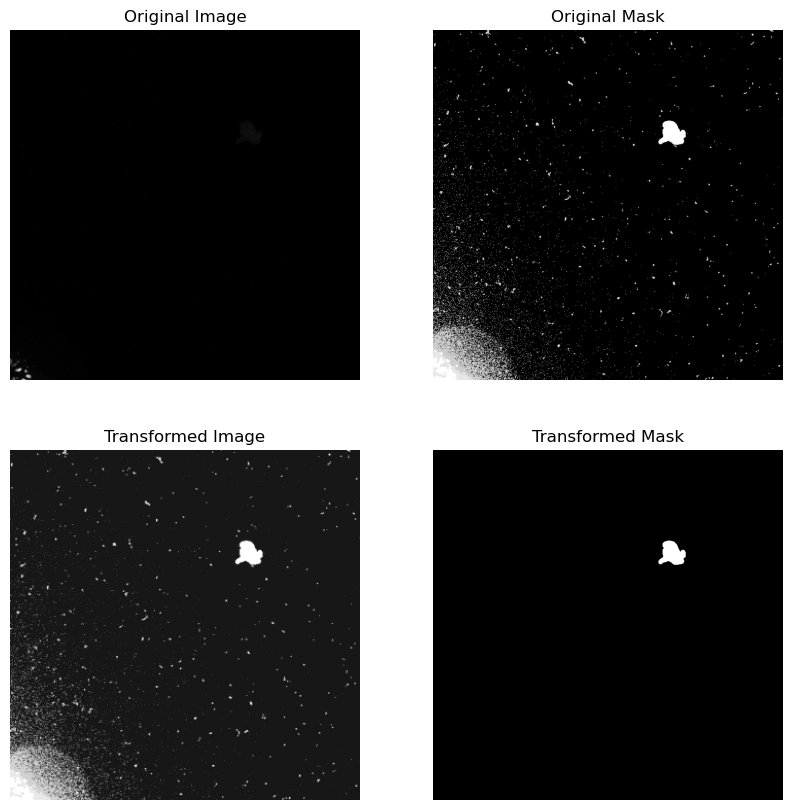

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_3.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_3_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


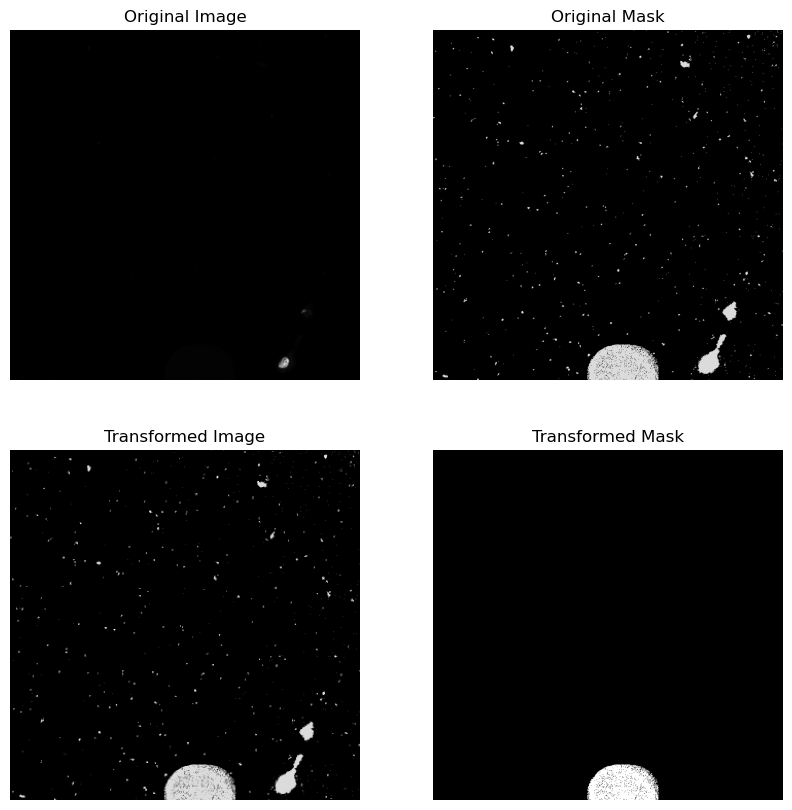

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_4.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_4_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


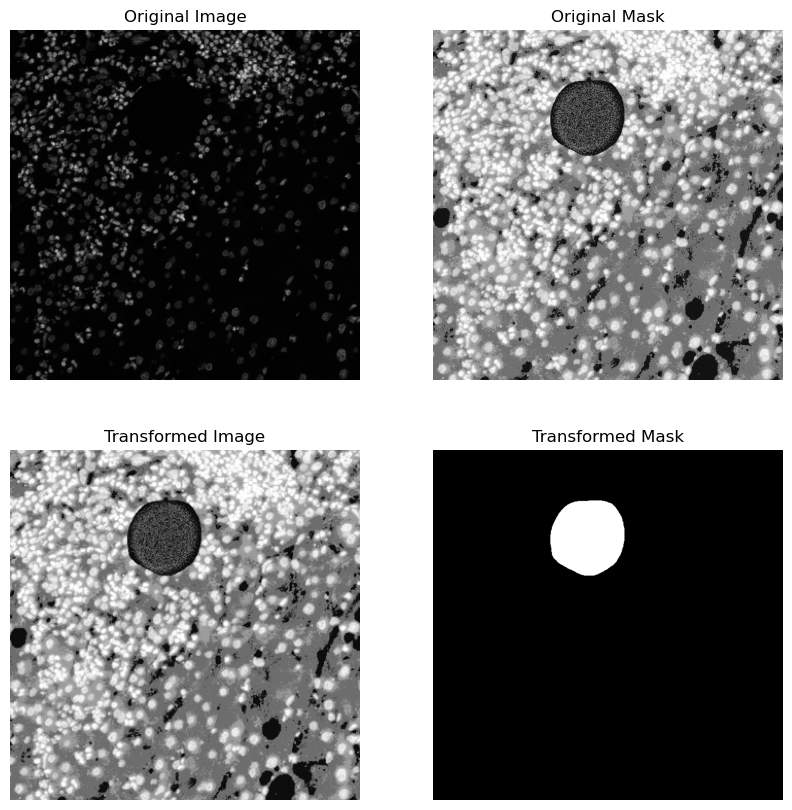

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_5.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_5_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


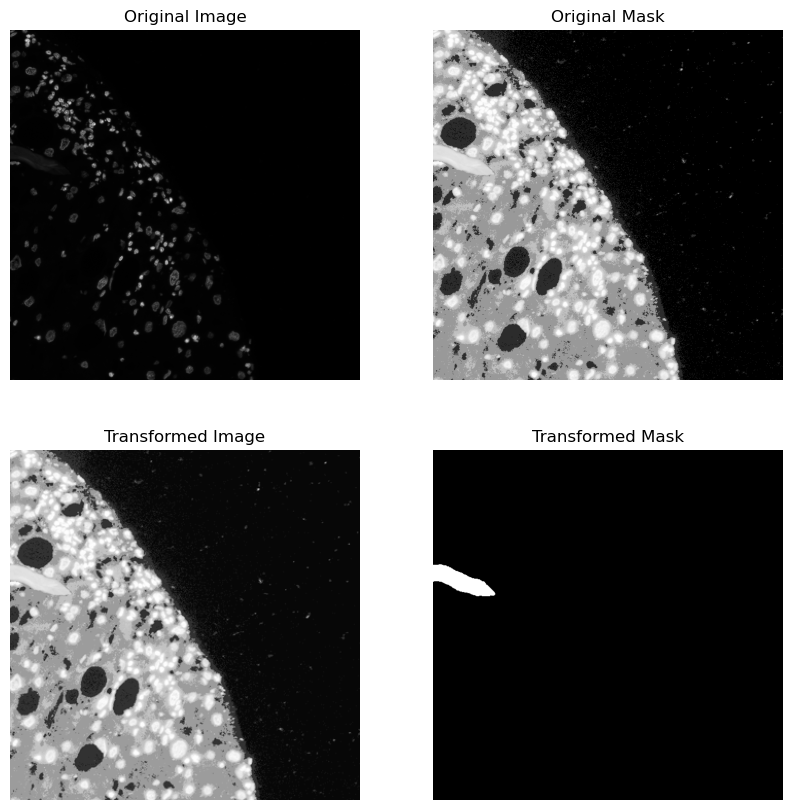

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_6.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_6_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


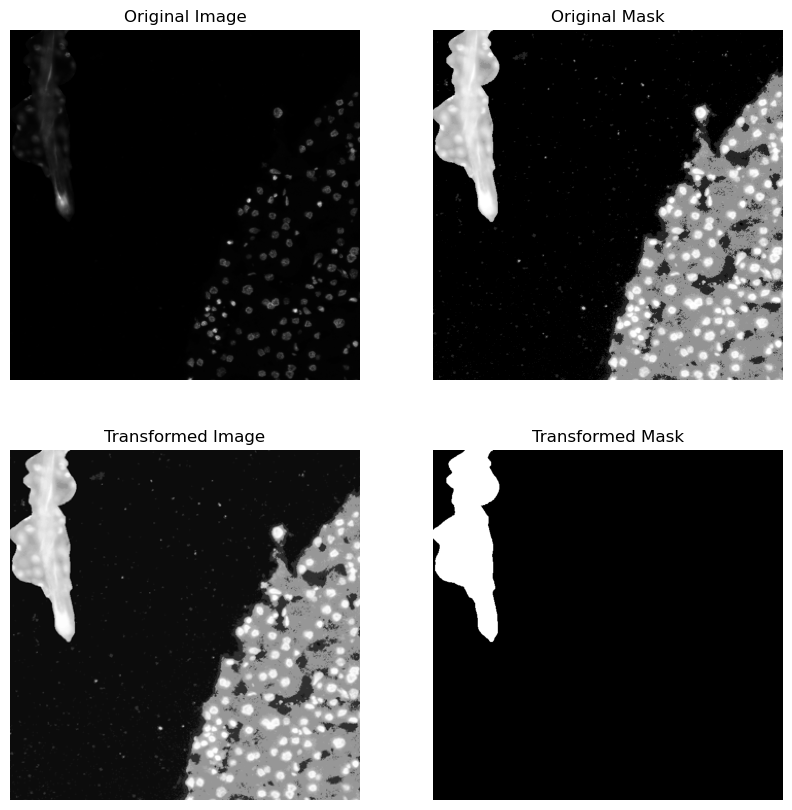

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_7.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_7_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


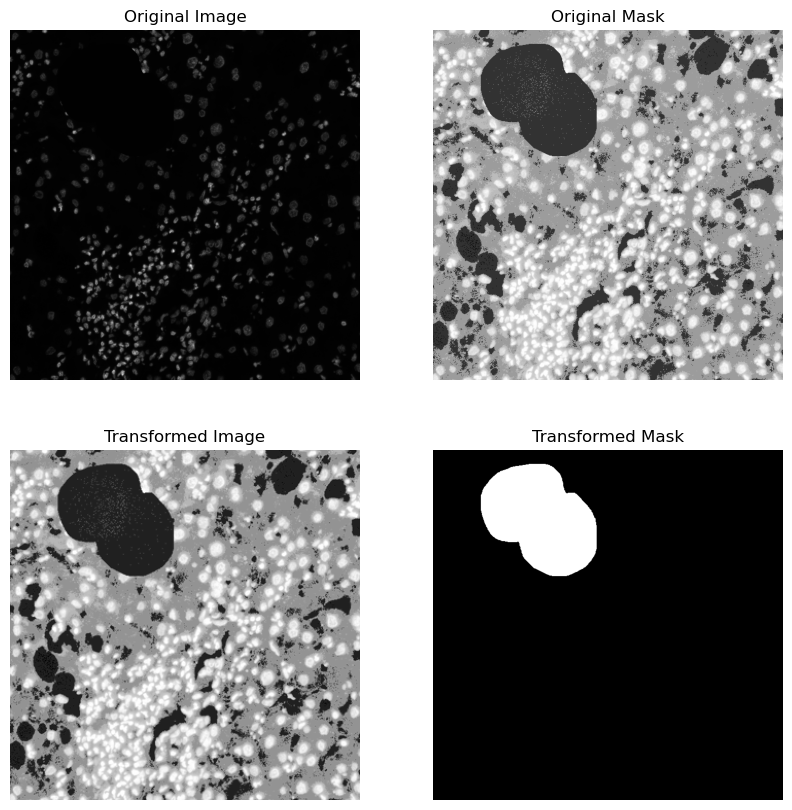

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_8.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_8_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


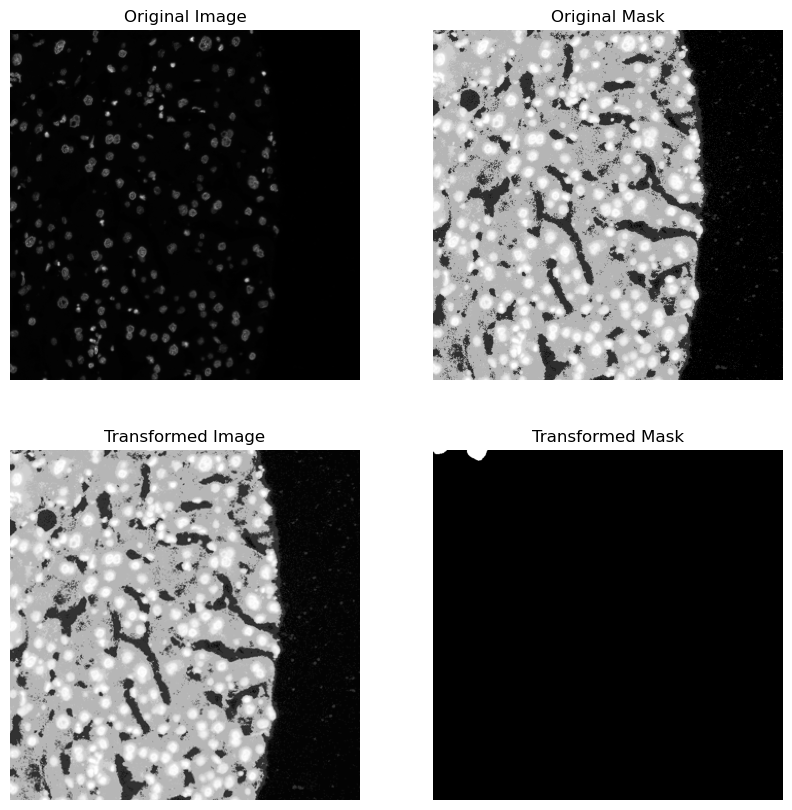

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_9.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_9_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


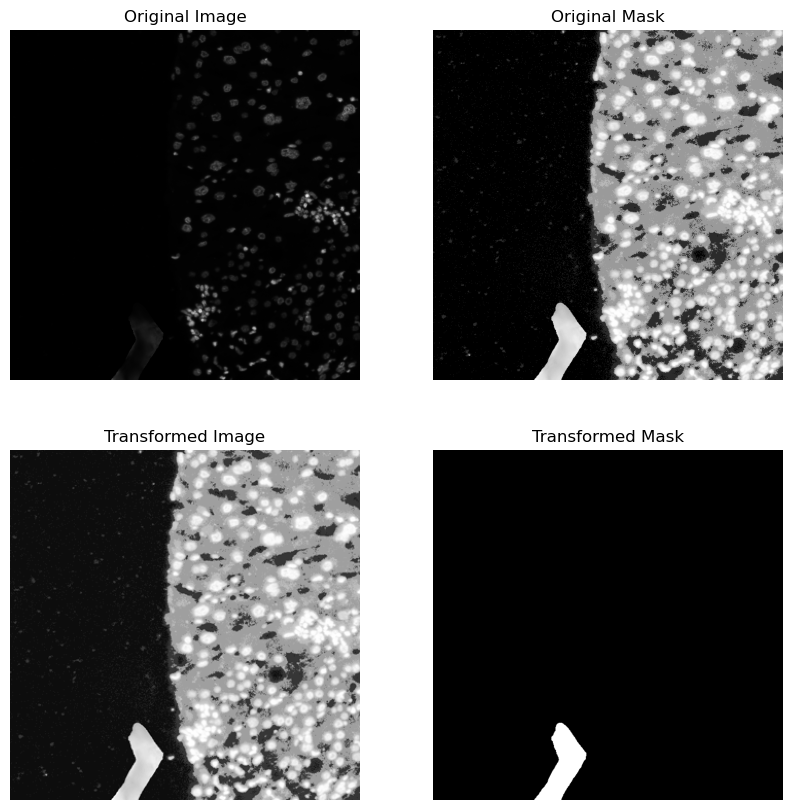

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_1.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_1_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


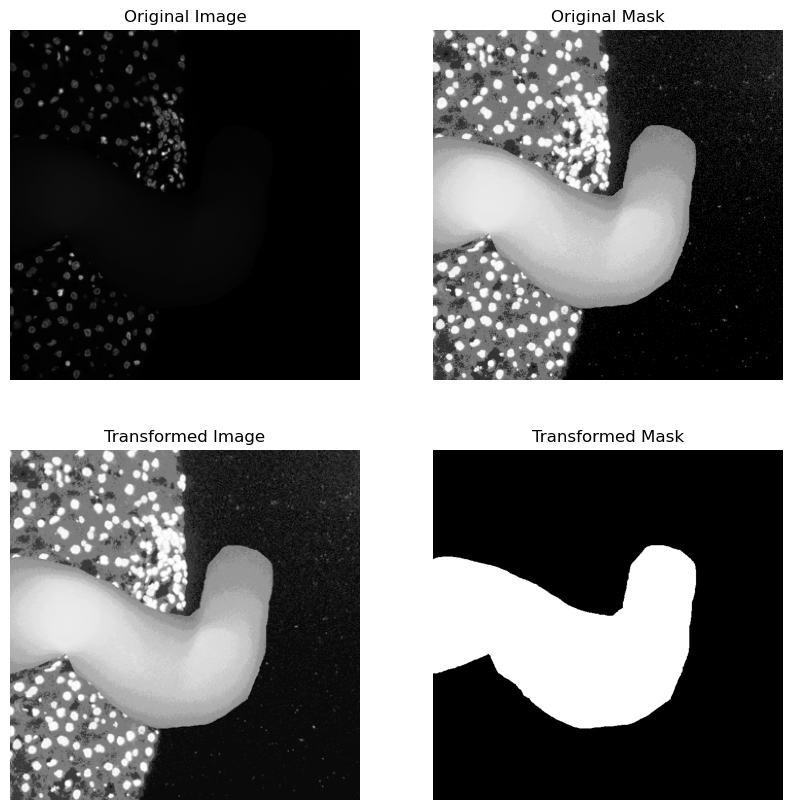

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_2.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_2_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


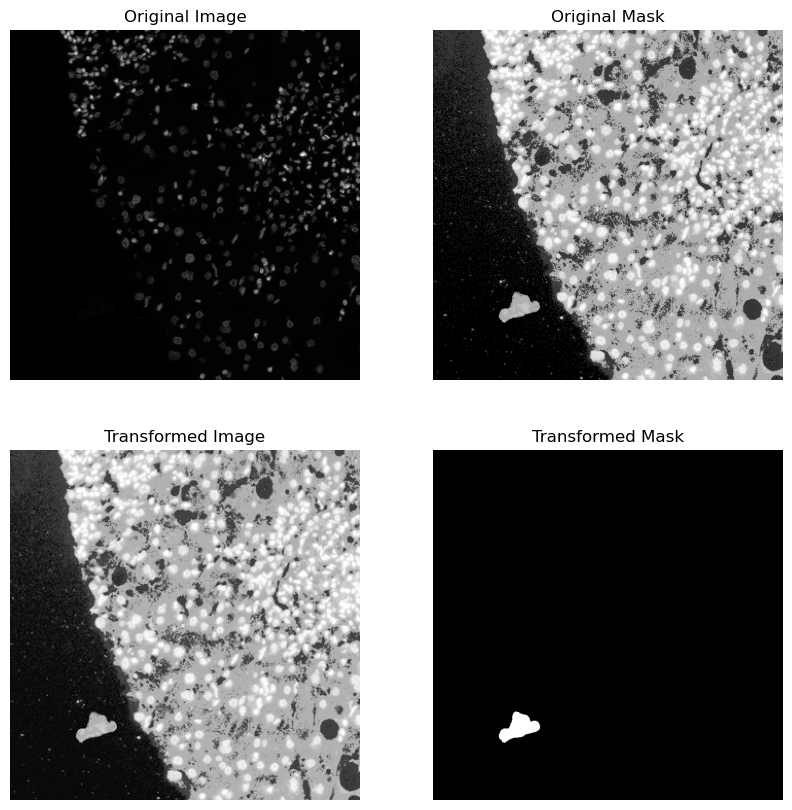

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_3.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_3_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


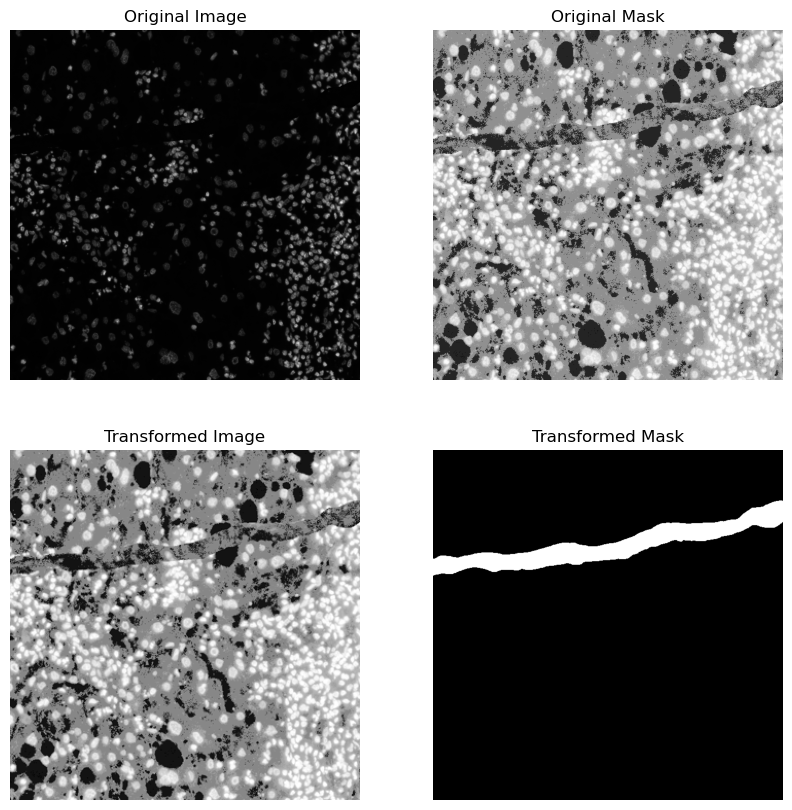

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_4.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_4_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


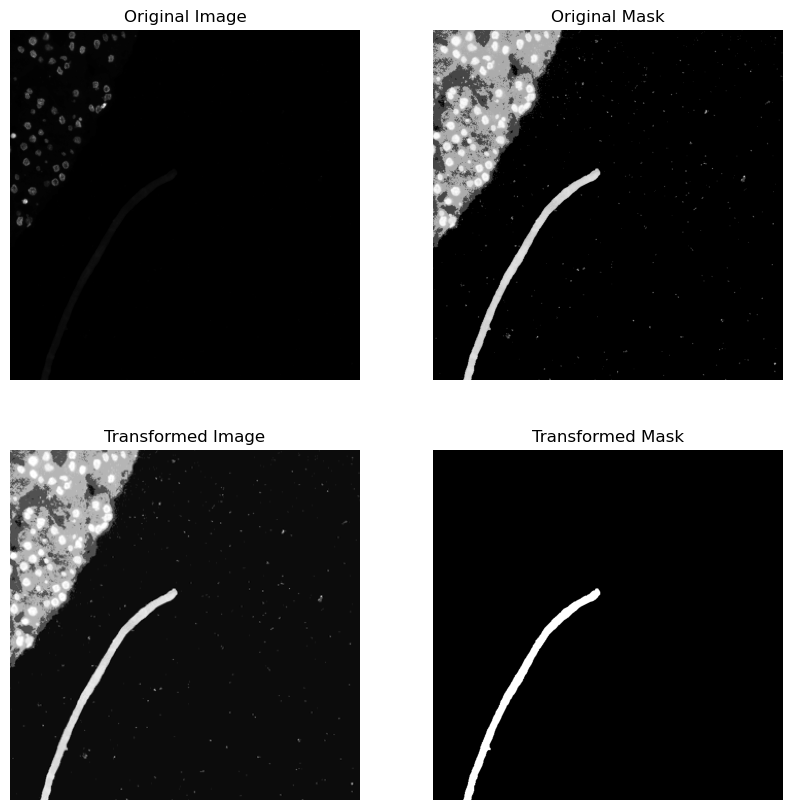

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_5.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_5_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


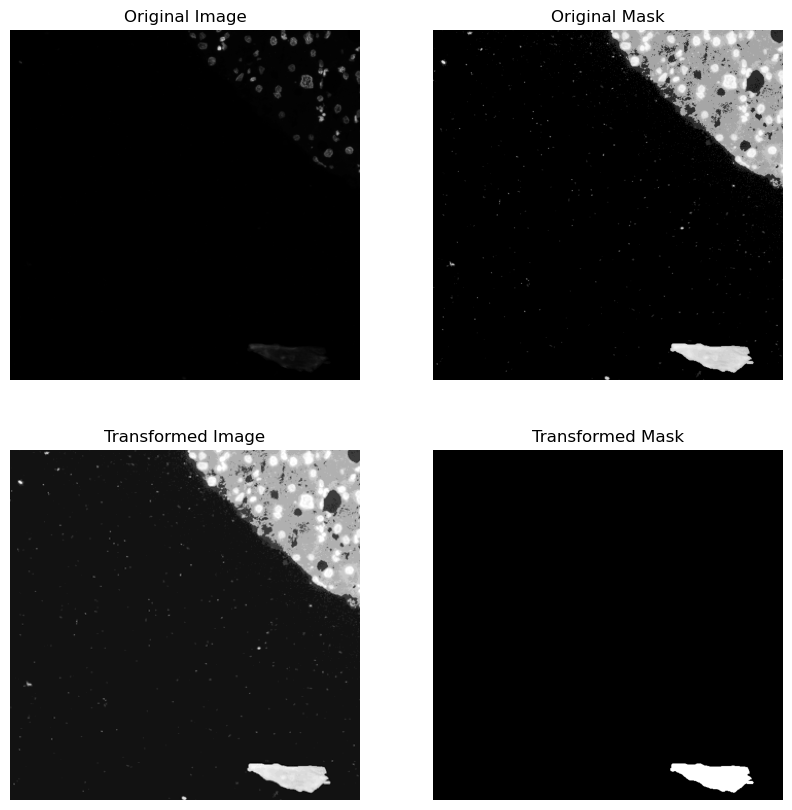

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_6.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_6_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


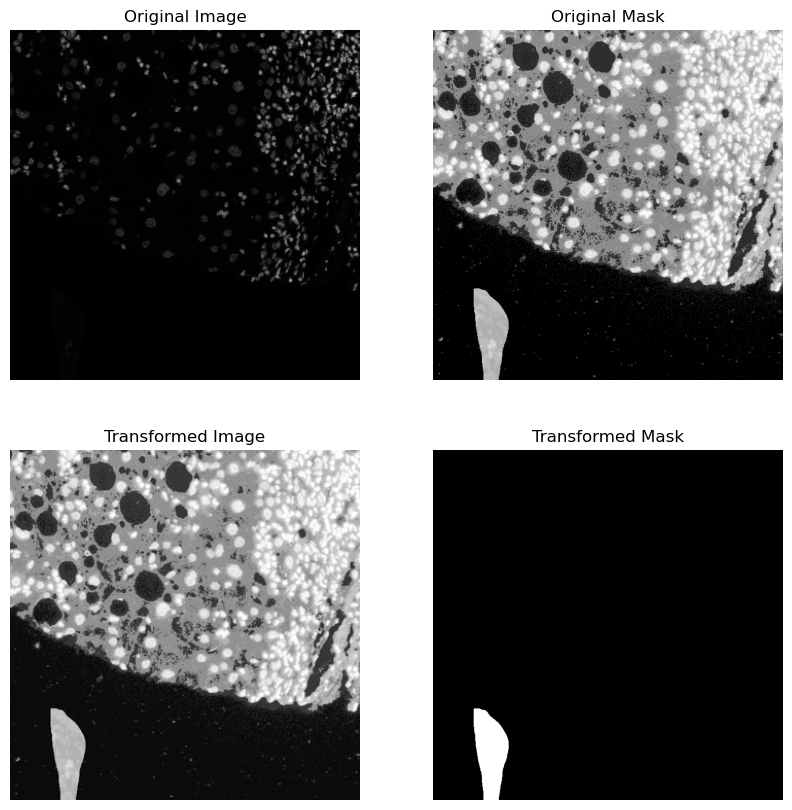

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_7.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_7_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


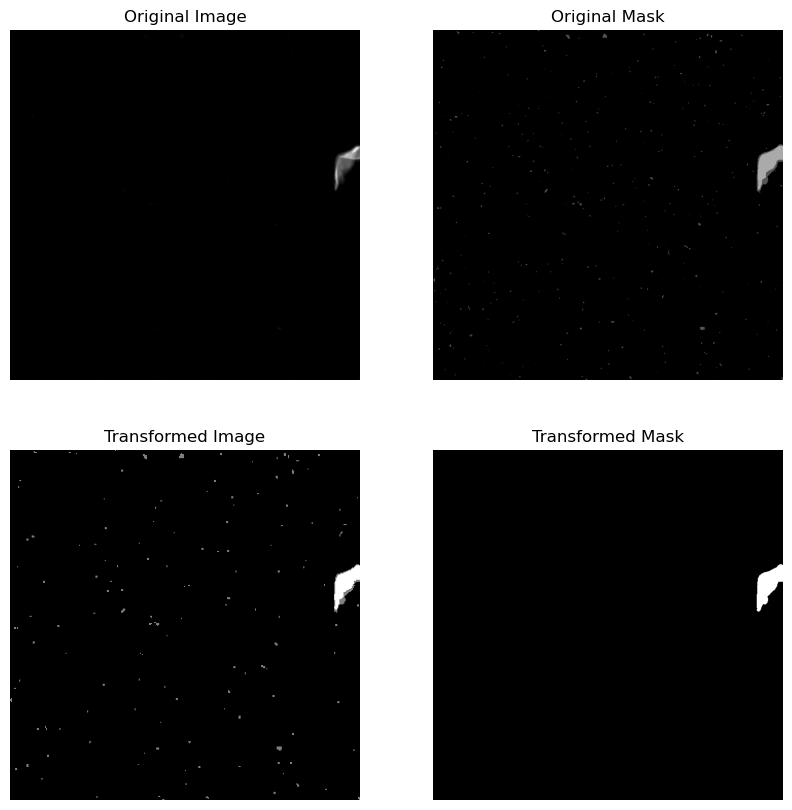

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_8.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_8_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


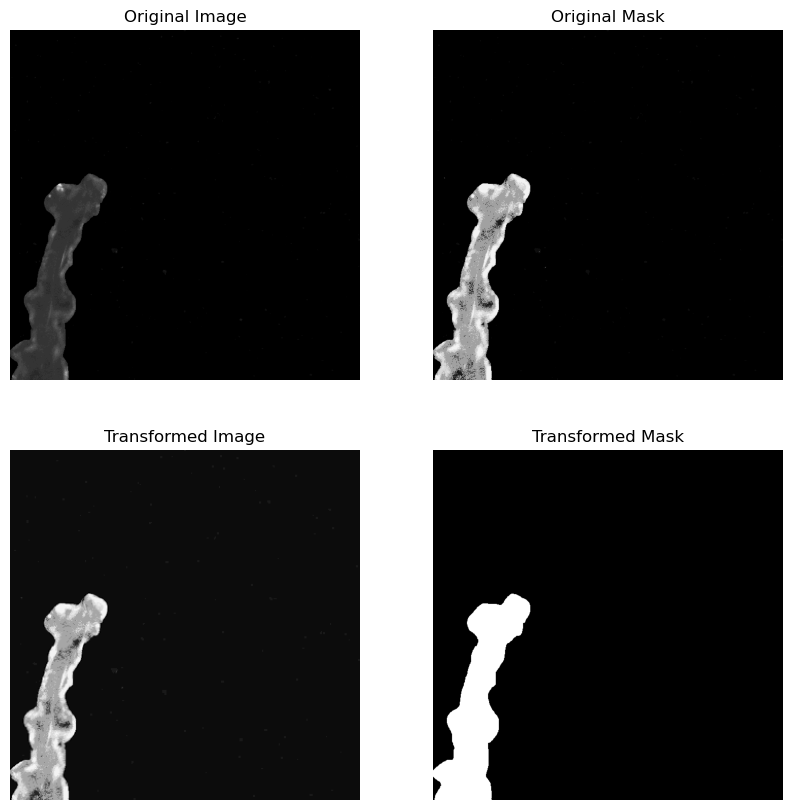

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_9.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M2_DAPI_cropped_9_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


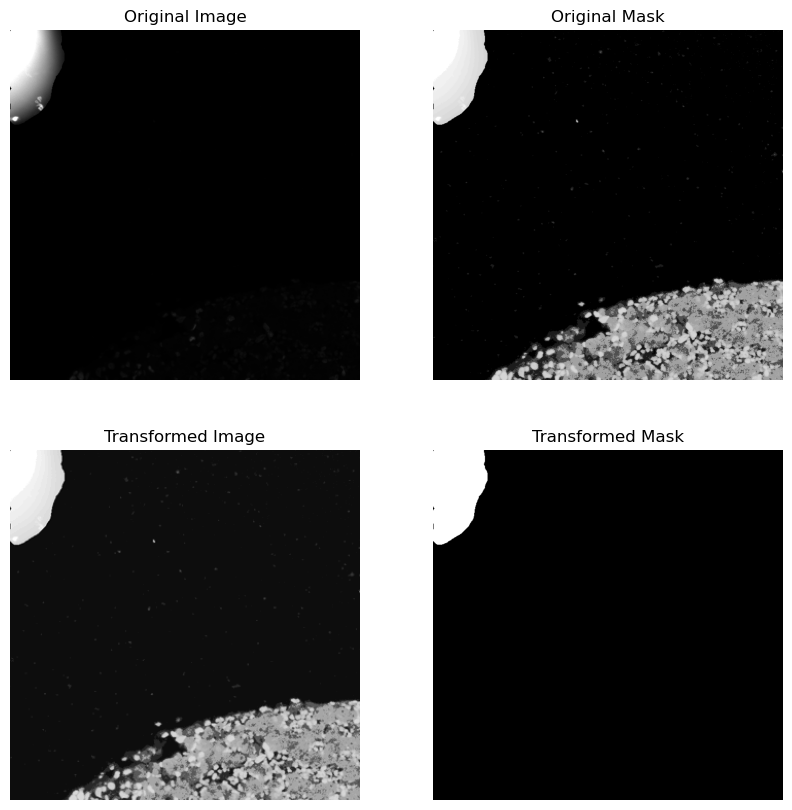

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_1.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_1_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


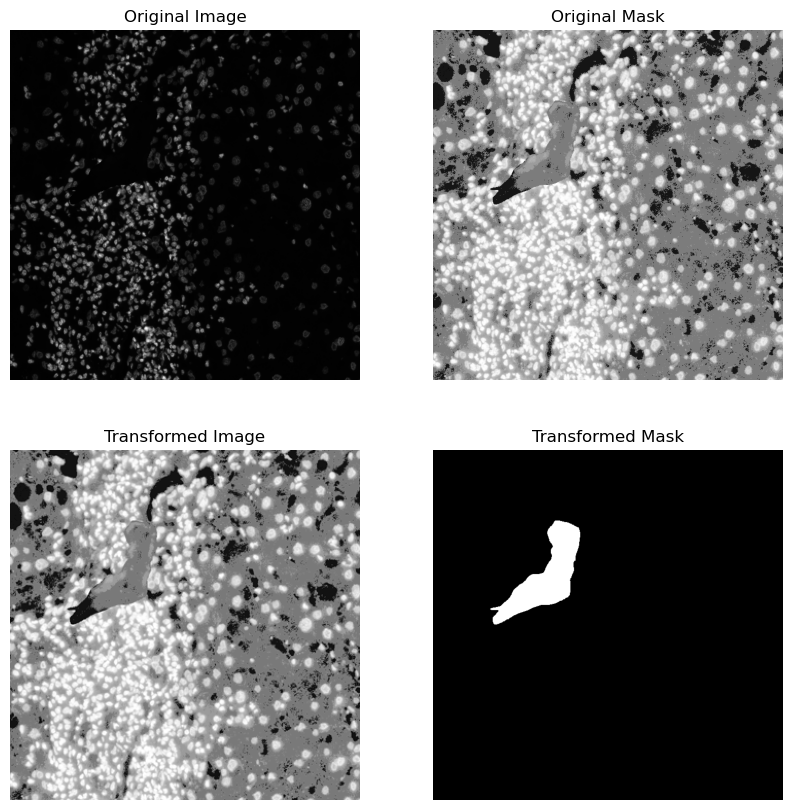

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_2.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_2_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


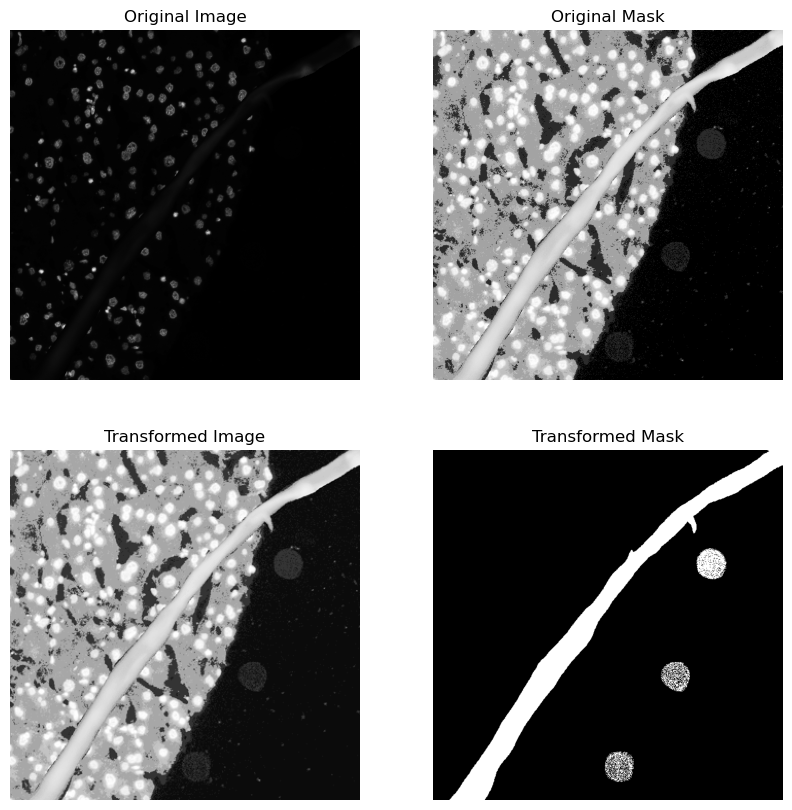

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_3.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_3_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


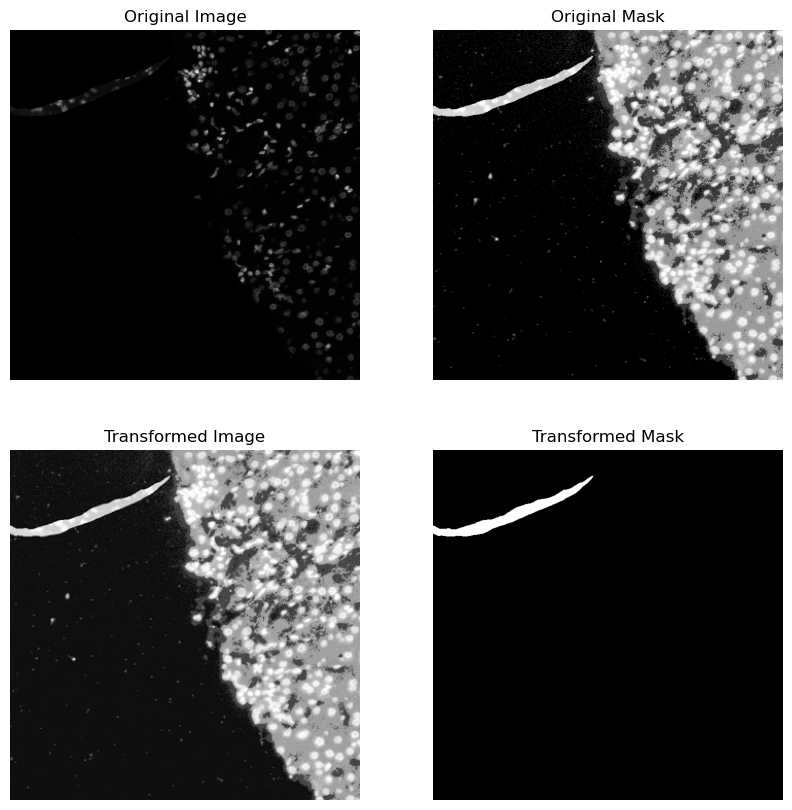

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_4.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_4_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


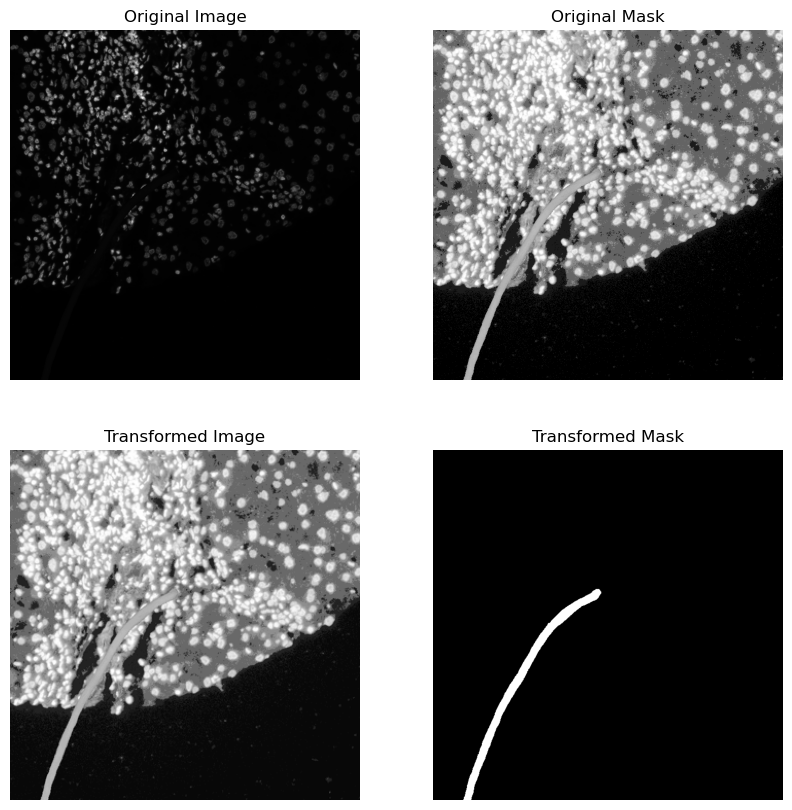

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_5.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_5_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


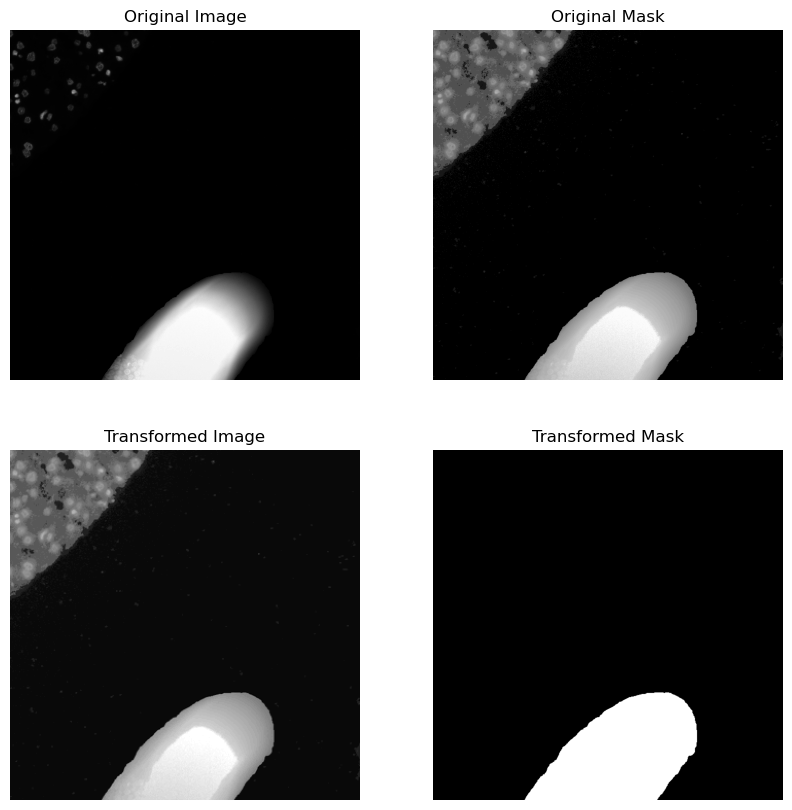

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_6.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_6_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


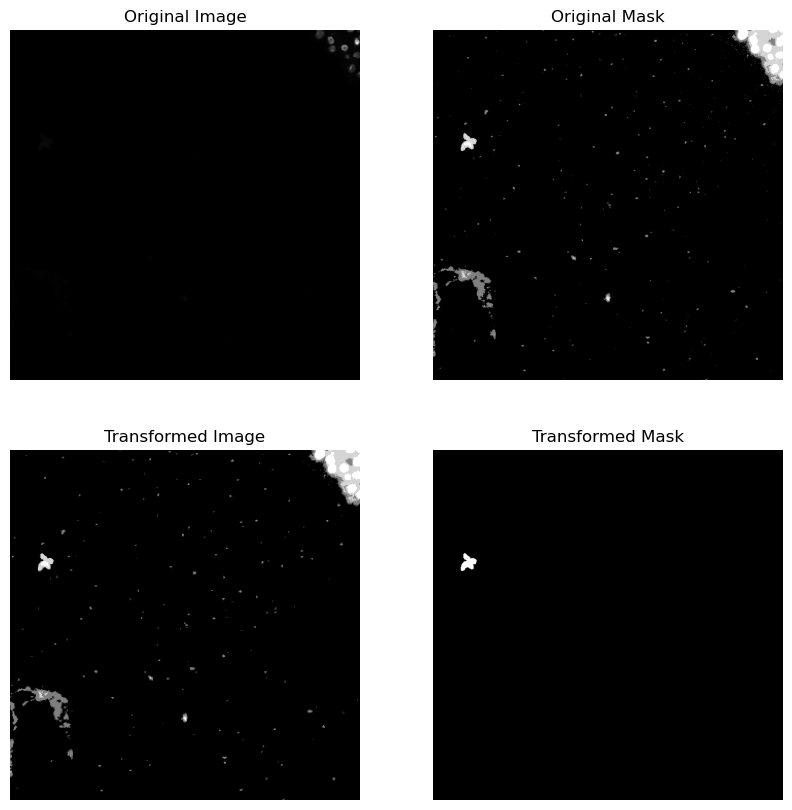

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_7.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_7_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


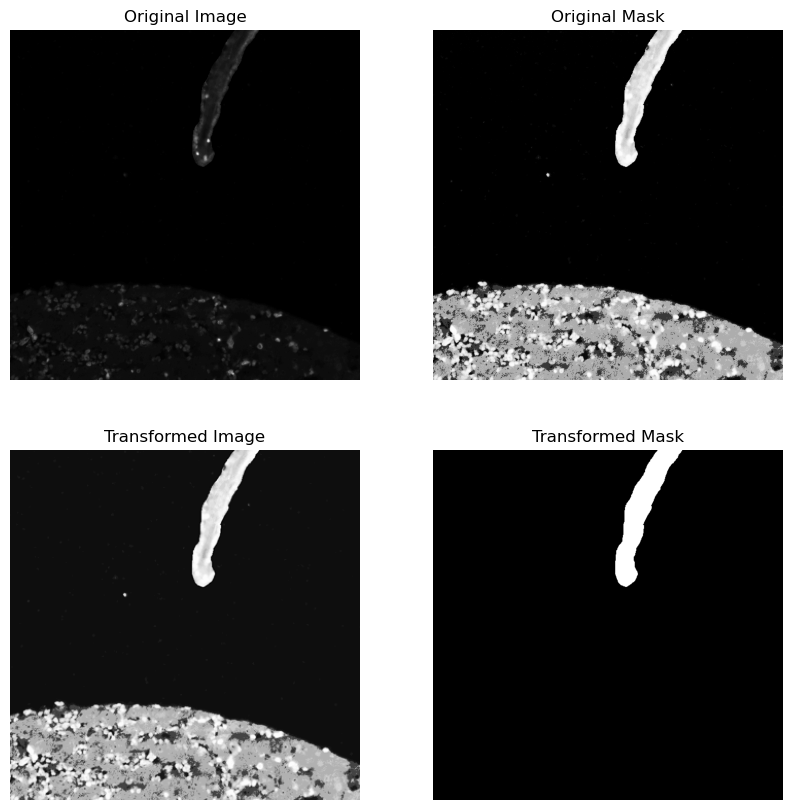

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_8.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_8_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


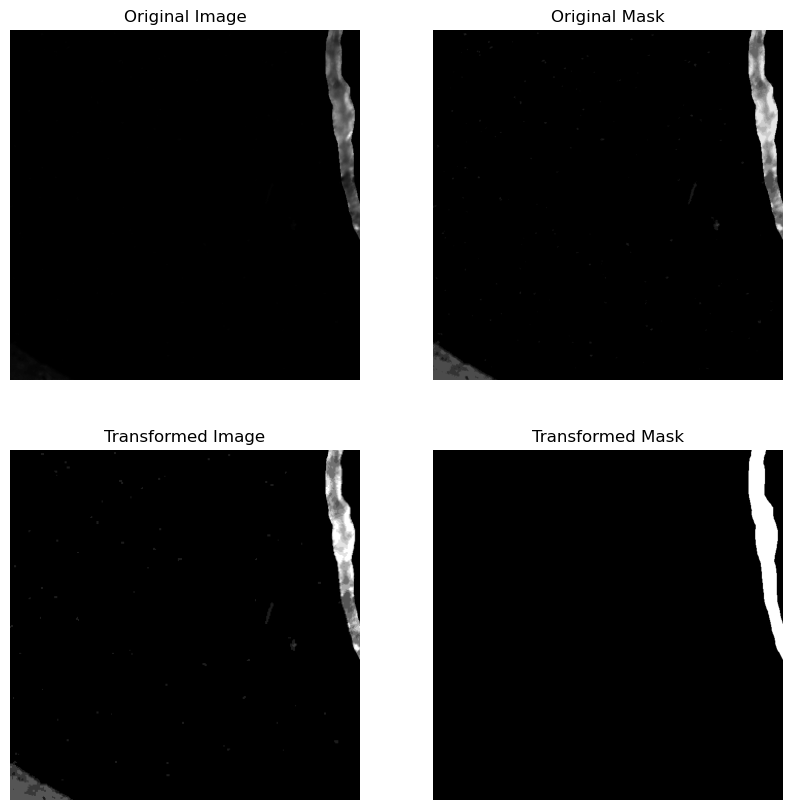

artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_9.png
(680, 680)
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M3_DAPI_cropped_9_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


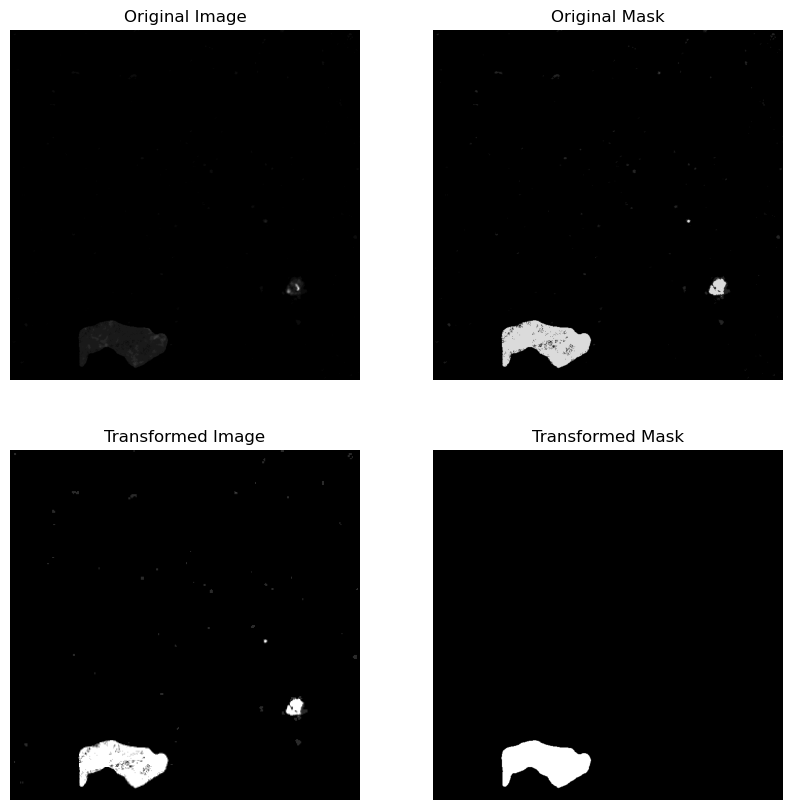

artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_1.png
(680, 680)
artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_1_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


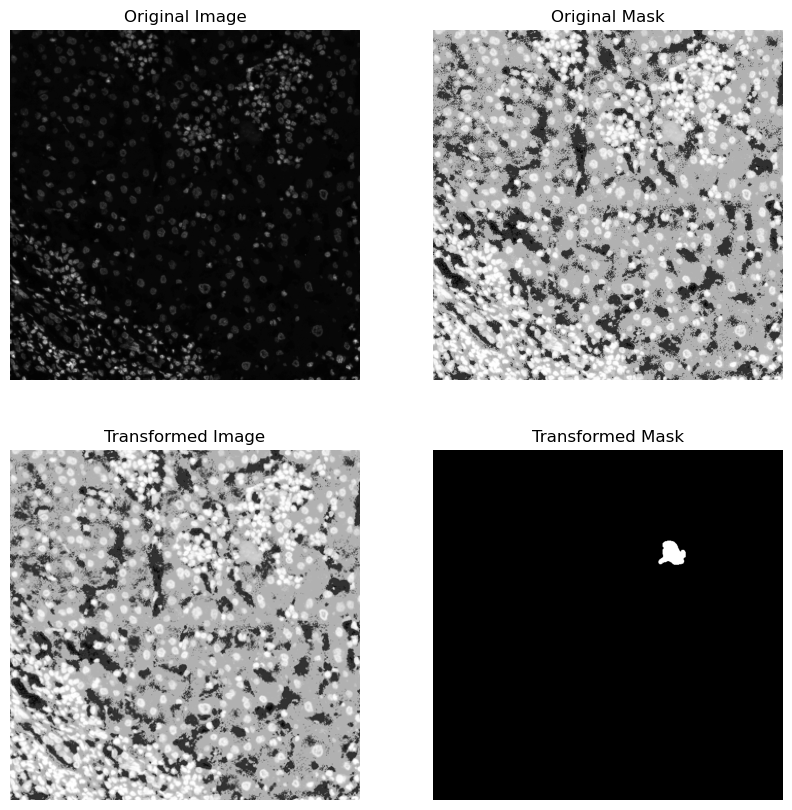

artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_2.png
(680, 680)
artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_2_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


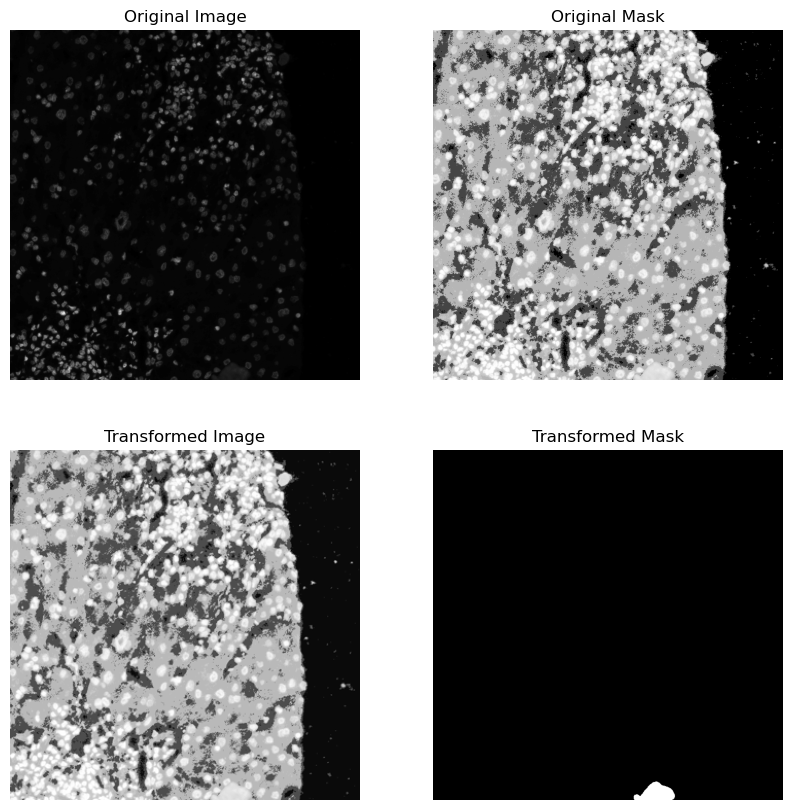

artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_3.png
(680, 680)
artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_3_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


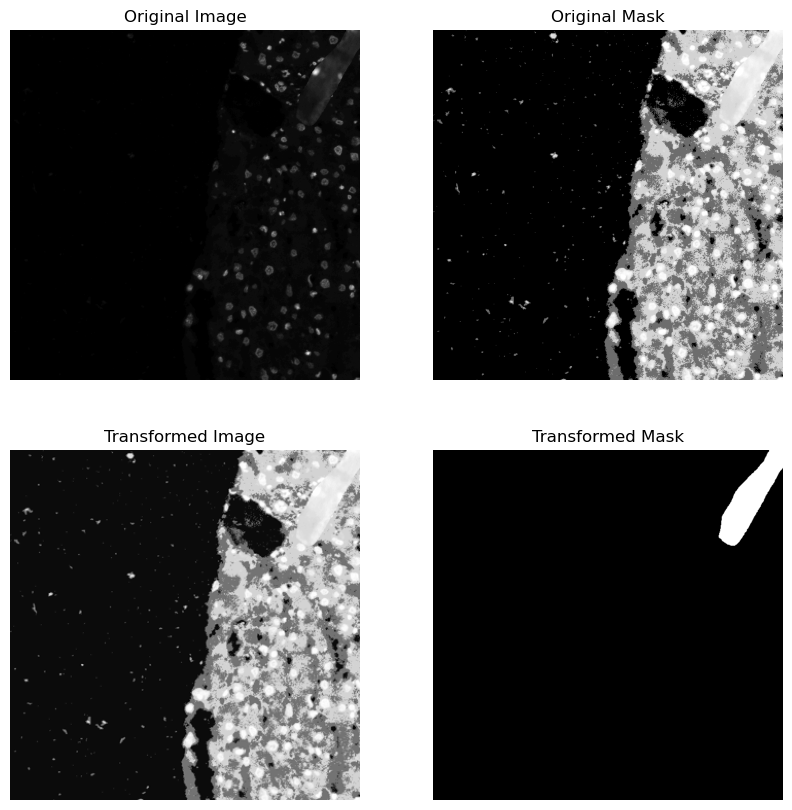

artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_4.png
(680, 680)
artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_4_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


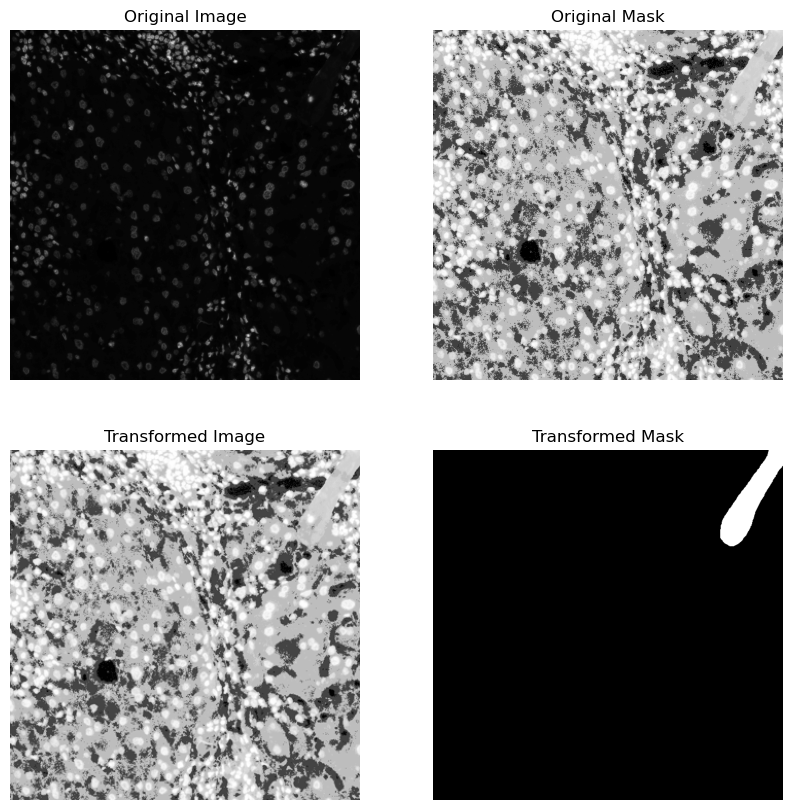

artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_5.png
(680, 680)
artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_5_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


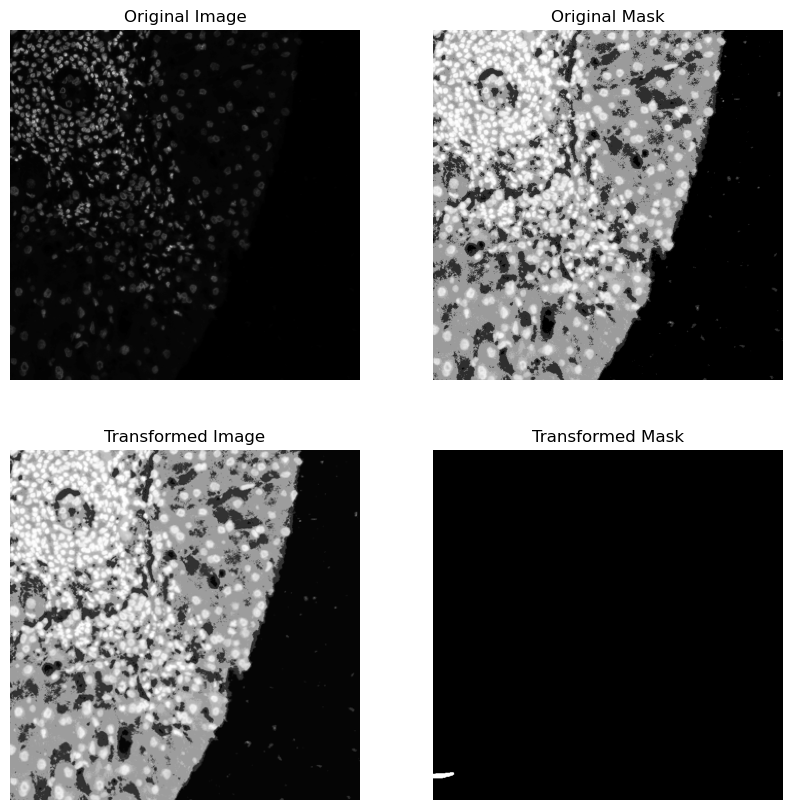

artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_6.png
(680, 680)
artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_6_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


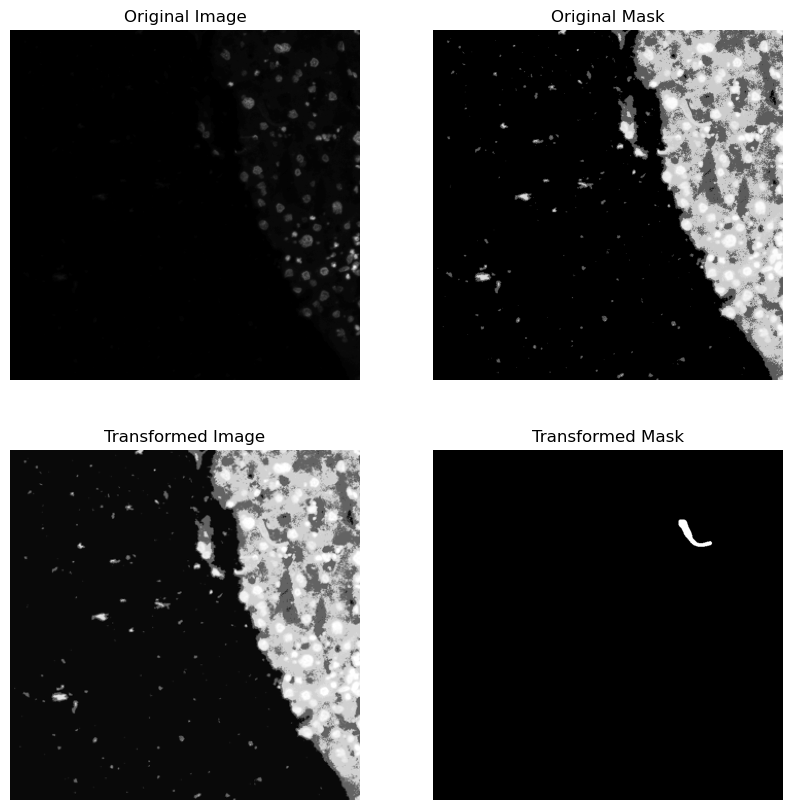

artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_7.png
(680, 680)
artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_7_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


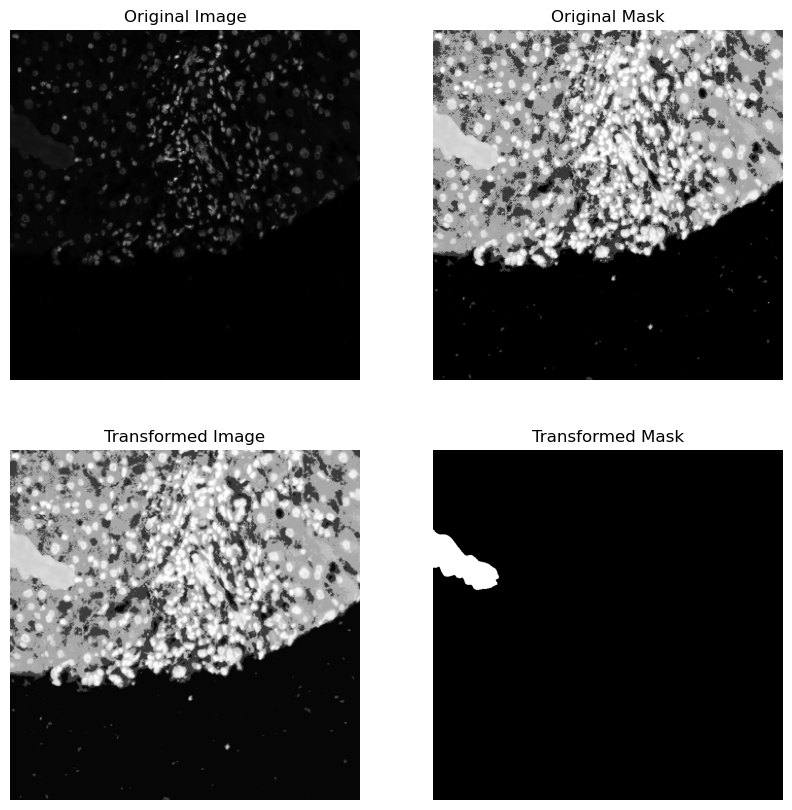

artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_8.png
(680, 680)
artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_8_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


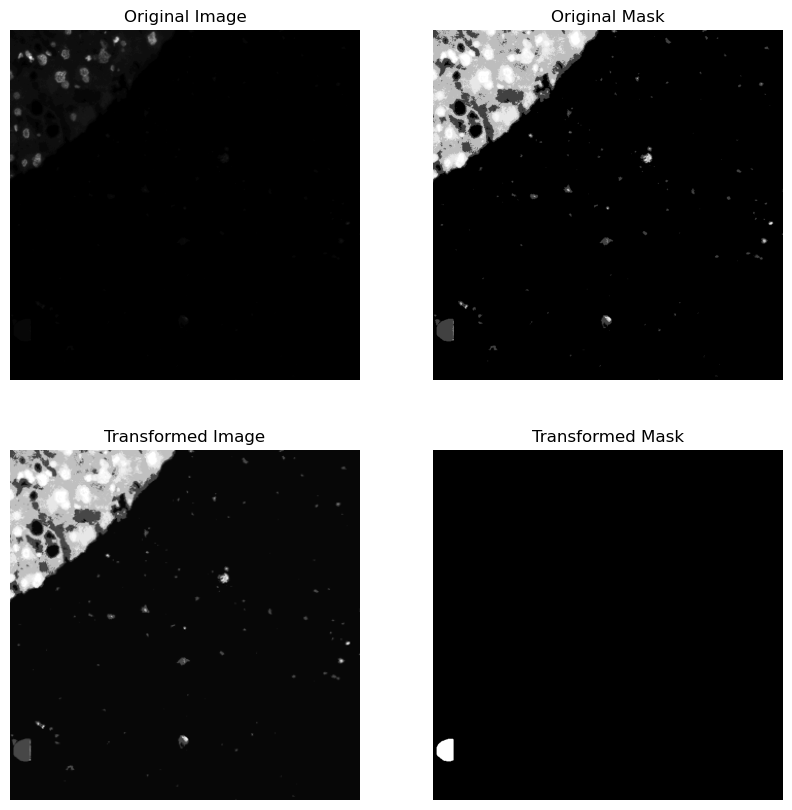

artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_9.png
(680, 680)
artifact_AIH_20200506_14R-Scene-01-ScanRegion0_S0M3_DAPI_cropped_9_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


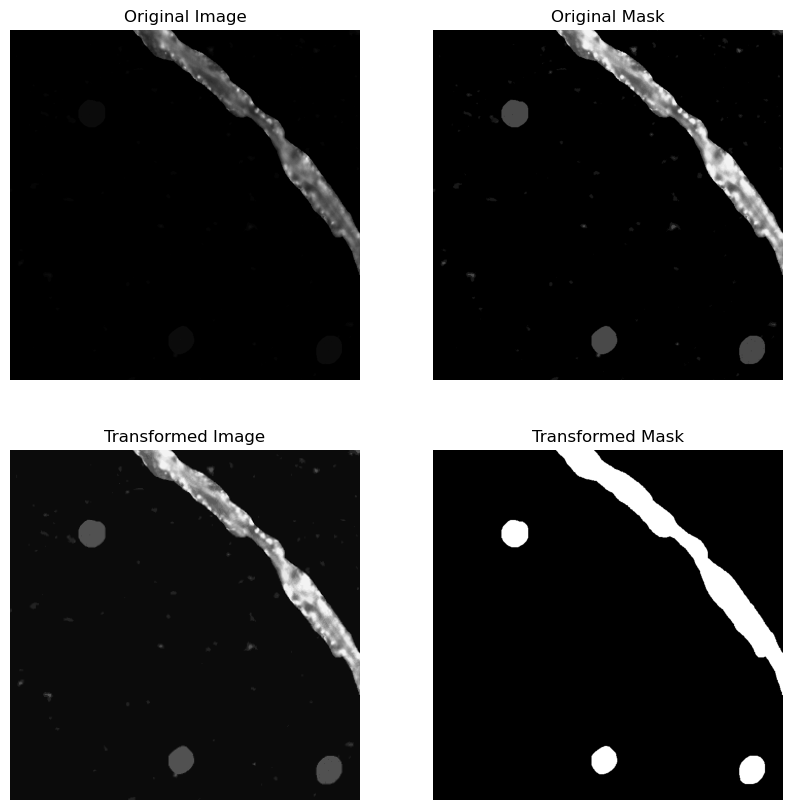

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_1.png
(680, 680)
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_1_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


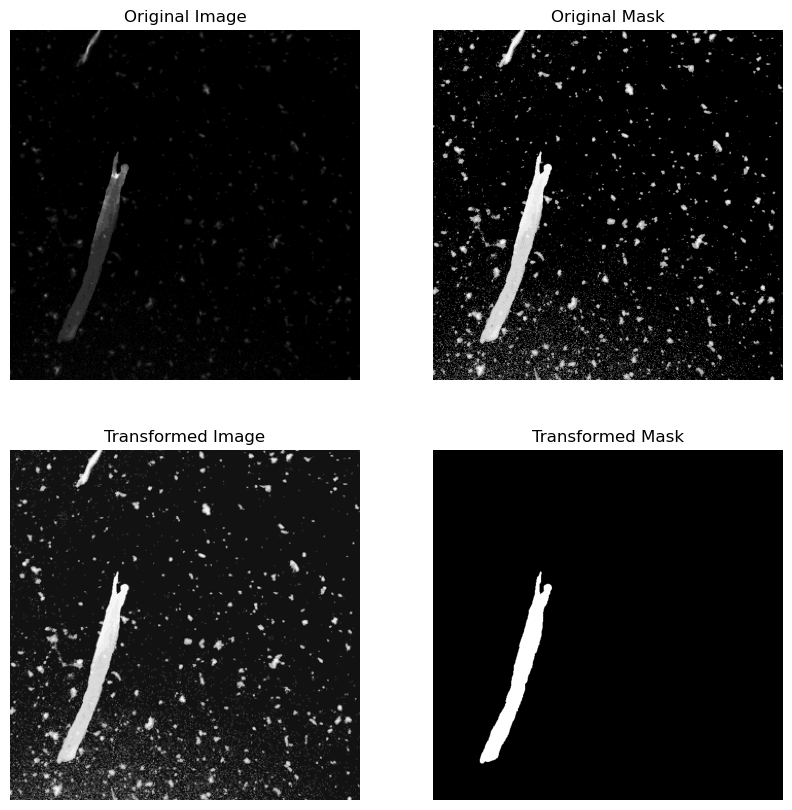

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_2.png
(680, 680)
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_2_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


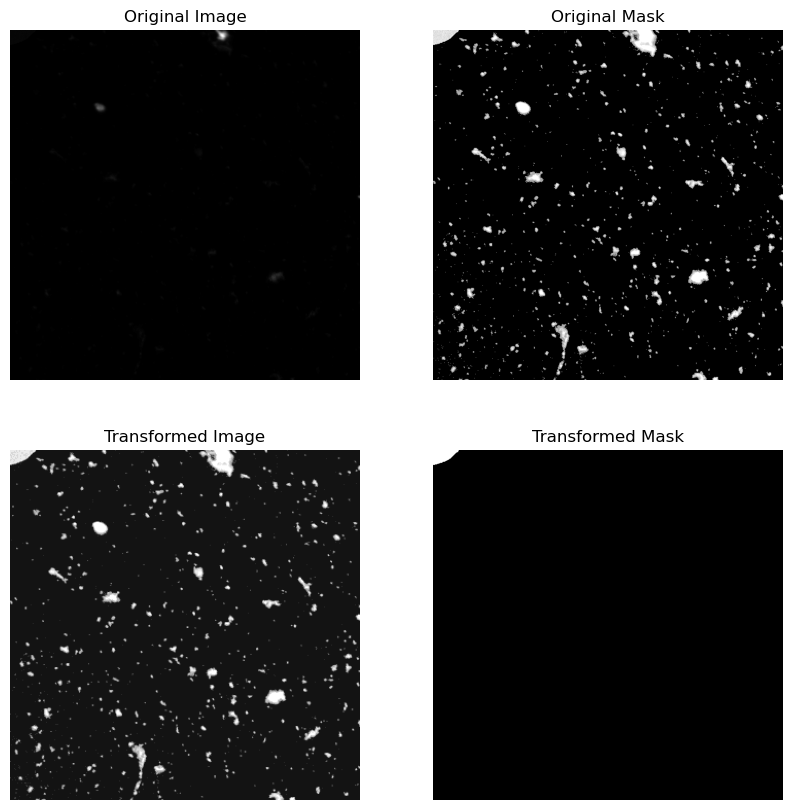

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_3.png
(680, 680)
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_3_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


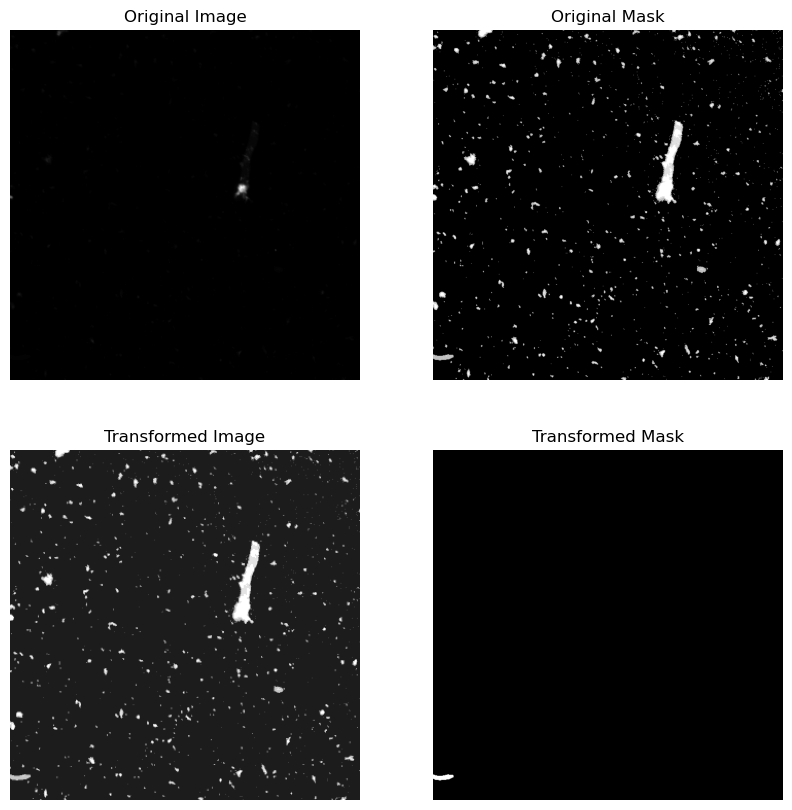

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_4.png
(680, 680)
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_4_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


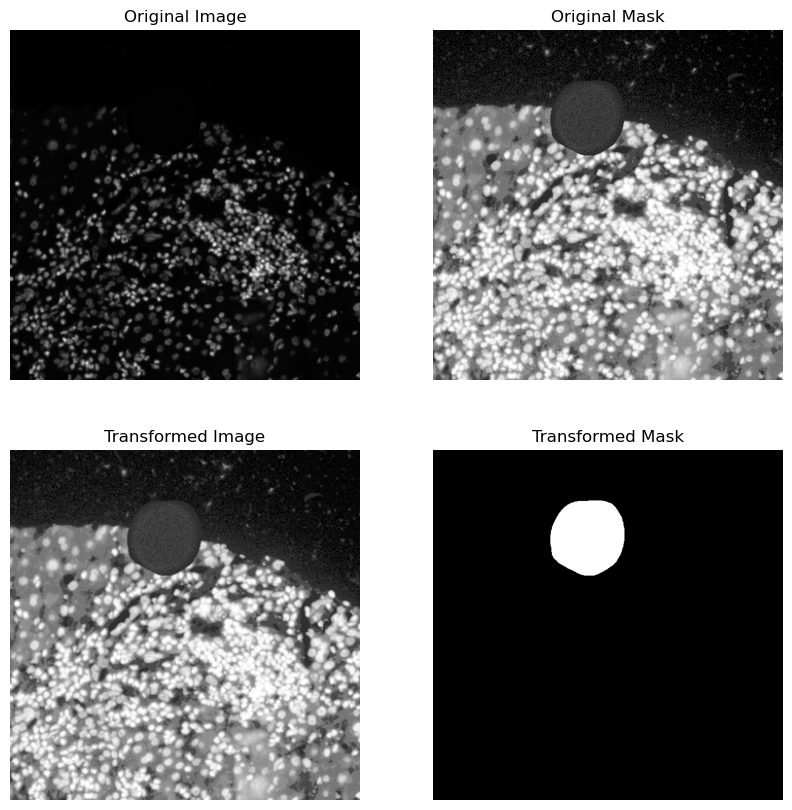

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_5.png
(680, 680)
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_5_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


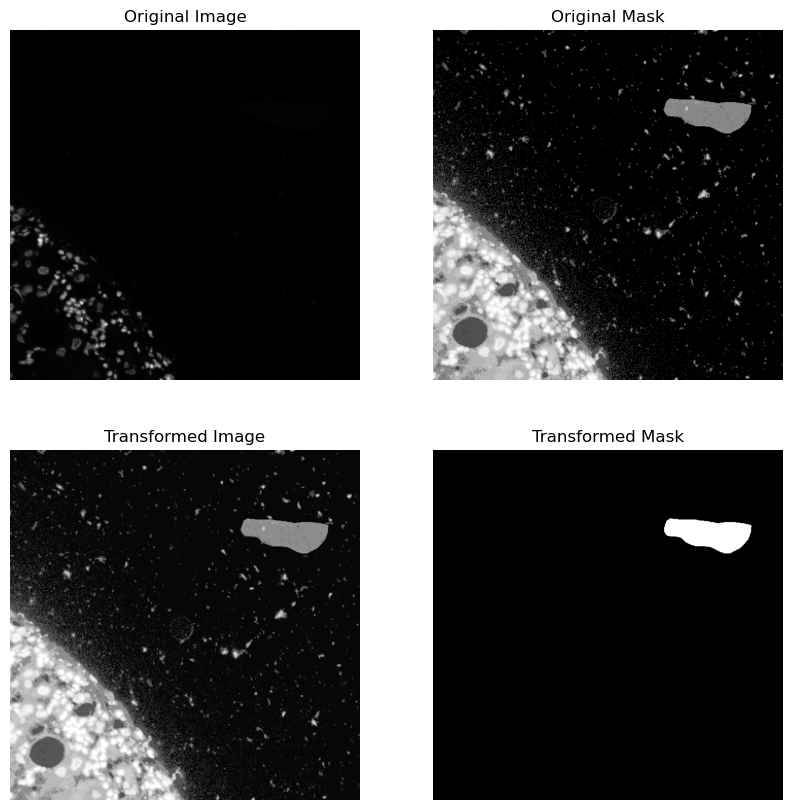

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_6.png
(680, 680)
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_6_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


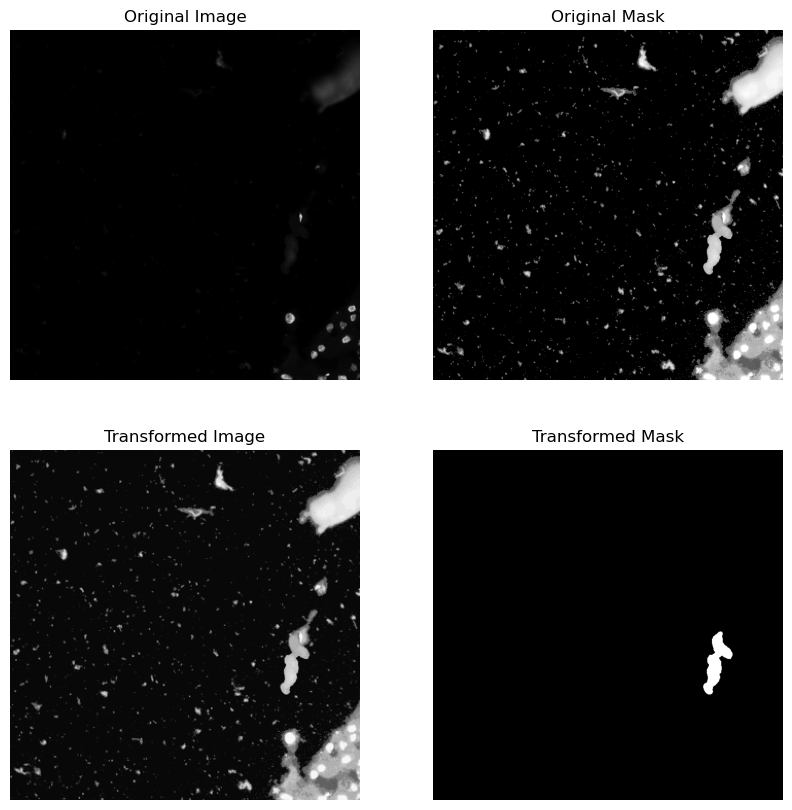

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_7.png
(680, 680)
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_7_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


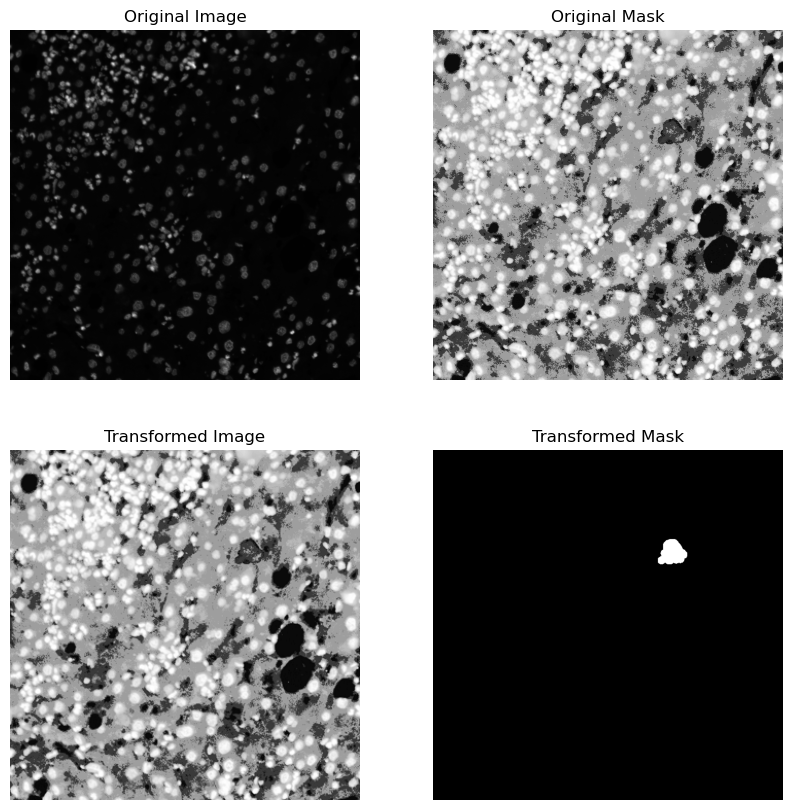

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_8.png
(680, 680)
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_8_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


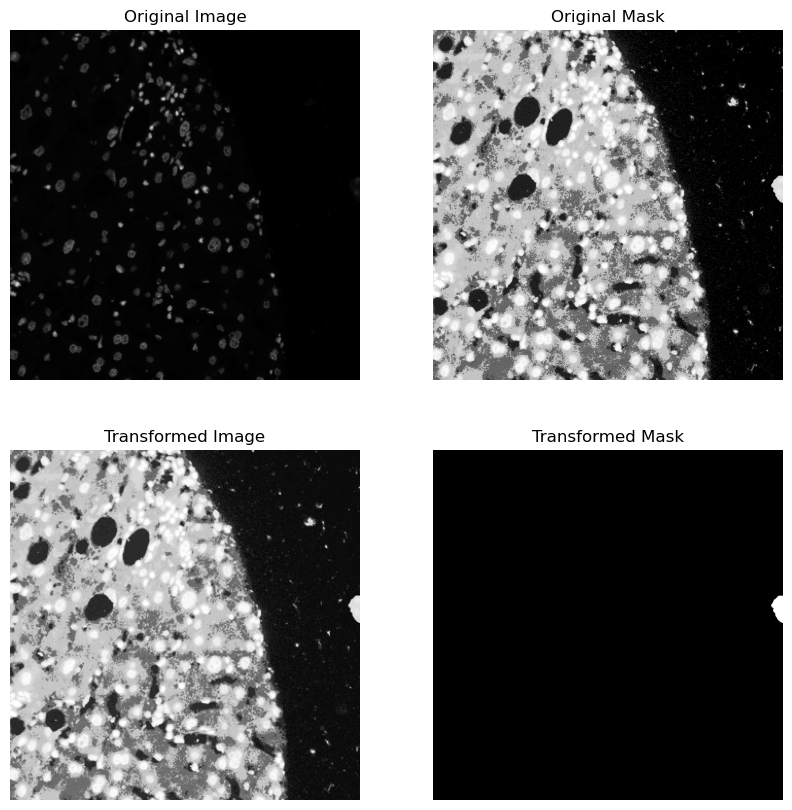

artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_9.png
(680, 680)
artifact_AIH_20200511_17R-Scene-04-ScanRegion3_S0M0_DAPI_cropped_9_label1.png
(680, 680)
(680, 680)
(1, 340, 340)


KeyboardInterrupt: 

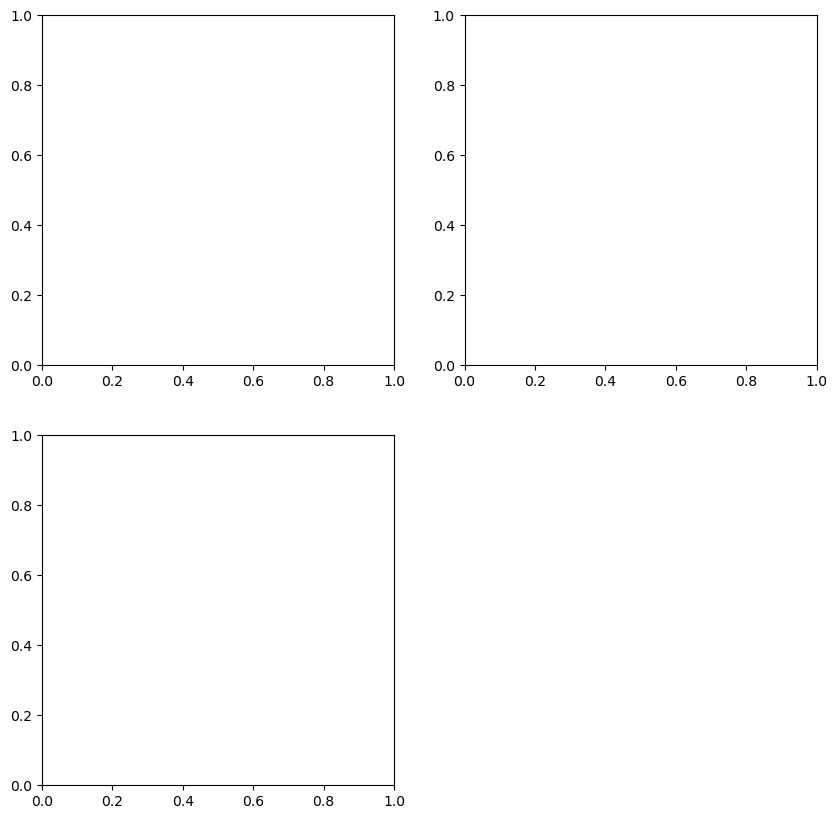

In [18]:
from hist_eq import *
import os
import numpy as np
from PIL import Image
from utils.data_loading import *
import cv2
import argparse
import numpy as pb
import glob
from augmentation import *



file_path = 'data/artifact/images' 

    
k=0

for image in os.listdir(file_path):
    print(image)
    pil_img = Image.open(f'{file_path}/{image}')
    # Original file name
   
    
    img=np.array(pil_img)
    print(img.shape)
# Split the original filename into its base name and extension
    base_name, extension = image.rsplit('.', 1)

# New file name with label
    new_filename = f'{base_name}_label1.{extension}'
    print(new_filename)


    mask=Image.open(f'data/artifact/masks/{new_filename}')
    mask=np.array(mask)
    print(img.shape)
    hist= hist_equalization(img)
        # Merge back the channel
    hist1=Image.fromarray(hist)
    w, h = hist1.size
    newW, newH = int(0.5 * w), int(0.5 * h)
    assert newW > 0 and newH > 0, 'Scale is too small, resized images would have no pixel'
    hist1 = hist1.resize((newW, newH), resample=Image.BICUBIC)
    hist1 = np.asarray(hist1)

    if hist1.ndim == 2:
        hist1 = hist1[np.newaxis, ...]
    else:
        hist1 = hist1.transpose((2, 0, 1))

    if (hist > 1).any():
        hist1 = hist1 / 255.0
    
    print(hist.shape)
    
   
    print(hist1.shape)
        
    
    visualize(img, hist, hist1, mask)
  
       
    
  




In [5]:
from PIL import Image
import os
import cv2
# Assuming you have a folder containing TIFF files
tiff_folder = "data/Food-Image-Classifier/No_Artifacts_label"

# Iterate through each TIFF file in the folder
for filename in os.listdir(tiff_folder):
    if filename.endswith(".tiff") or filename.endswith(".tif"):
        # Open the TIFF file
        tiff_path = os.path.join(tiff_folder, filename)
        image = cv2.imread(tiff_path, cv2.IMREAD_GRAYSCALE)
        
        # Convert to PNG
        png_path = os.path.join(tiff_folder, os.path.splitext(filename)[0] + ".png")
        cv2.imwrite(png_path, image)

        # Optionally, you can delete the original TIFF file
        os.remove(tiff_path)

print("Conversion completed.")


Conversion completed.


In [18]:
import numpy as np

# Convert the lists to numpy arrays for easier computation
predicted_labels =np.array([1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])
true_labels = np.array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0]) # Insert the provided predicted labels
  # Insert the provided true labels

# True Positive (TP)
TP = np.sum((predicted_labels == 1) & (true_labels == 1))

# True Negative (TN)
TN = np.sum((predicted_labels == 0) & (true_labels == 0))

# False Positive (FP)
FP = np.sum((predicted_labels == 1) & (true_labels == 0))

# False Negative (FN)
FN = np.sum((predicted_labels == 0) & (true_labels == 1))

# Accuracy
accuracy = (TP + TN) / (TP + TN + FP + FN)

# Recall (Sensitivity)
recall = TP / (TP + FN)

# Precision
precision = TP / (TP + FP)

# Specificity
specificity = TN / (TN + FP)

# F1 Score
f1_score = 2 * (precision * recall) / (precision + recall)

# Print the metrics
print("True Positive (TP):", TP)
print("True Negative (TN):", TN)
print("False Positive (FP):", FP)
print("False Negative (FN):", FN)
print("Accuracy:", accuracy)
print("Recall (Sensitivity):", recall)
print("Precision:", precision)
print("Specificity:", specificity)
print("F1 Score:", f1_score)


True Positive (TP): 89
True Negative (TN): 750
False Positive (FP): 83
False Negative (FN): 23
Accuracy: 0.8878306878306879
Recall (Sensitivity): 0.7946428571428571
Precision: 0.5174418604651163
Specificity: 0.9003601440576231
F1 Score: 0.6267605633802816


In [15]:
import pandas as pd
import os

# Define a list to store all dataframes
dfs = []

# Loop through all files in the folder
folder_path = "data/results/he"  # Replace with the path to your folder
for filename in os.listdir(folder_path):
    if filename.startswith("class_metrics_fulldata") and filename.endswith(".xlsx"):
        # Read the CSV file into a DataFrame
        df = pd.read_excel(os.path.join(folder_path, filename), index_col=0)
        # Rename the columns to include the file number
        df.columns = [f"{col}_{filename.split('_')[-1].split('.')[0]}" for col in df.columns]
      
        # Append the DataFrame to the list
        dfs.append(df)

# Concatenate all DataFrames into a single DataFrame
merged_df = pd.concat(dfs, axis=1)

# Display the merged DataFrame
print(merged_df)


                     0_fulldata1  0_fulldata2  0_fulldata3  0_fulldata4  \
TP                     58.000000   105.000000    96.000000   105.000000   
TN                    532.000000   149.000000   211.000000   166.000000   
FP                    301.000000   684.000000   622.000000   667.000000   
FN                     54.000000     7.000000    16.000000     7.000000   
Accuracy                0.624339     0.268783     0.324868     0.286772   
Recall                  0.517857     0.937500     0.857143     0.937500   
Precision               0.161560     0.133080     0.133705     0.136010   
F1                      0.246285     0.233074     0.231325     0.237557   
Sensitivity             0.517857     0.937500     0.857143     0.937500   
Specificity             0.638655     0.178872     0.253301     0.199280   
dice score              0.582029     0.197254     0.260604     0.216024   
pixelwise iou score     0.576925     0.188744     0.253079     0.207598   

                     0_f

In [16]:
max_values = merged_df.max(axis=1)



# Convert the DataFrame to an Excel file
excel_file_path = "data/results/he/metrics_fulldata_he.xlsx"  # Specify the output file path
merged_df.to_excel(excel_file_path)

print(max_values)

TP                     105.000000
TN                     532.000000
FP                     684.000000
FN                      54.000000
Accuracy                 0.624339
Recall                   0.937500
Precision                0.161560
F1                       0.263989
Sensitivity              0.937500
Specificity              0.638655
dice score               0.582029
pixelwise iou score      0.576925
dtype: float64


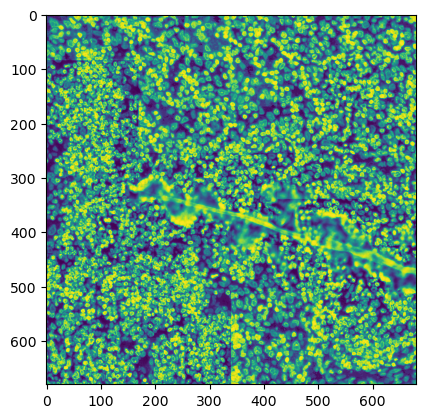

In [23]:
filep='data/Food-Image-Classifier/test_vgg/cropped_images'
import numpy as np
from hist_eq import *
pil_img = Image.open(f'{filep}/DLBCL10_20200416_01R-Scene-22-ScanRegion21_S0M1_DAPI_cropped_8.png')
    # Original file name
   
    
img=np.array(pil_img)
a_img=ahe(img)
plt.imshow(a_img)
plt.show()

In [1]:
import os
import numpy as np
from PIL import Image
from utils.data_loading import *
import cv2
import argparse
import numpy as np
import glob
from augmentation import *

# Import hist_equalization and ahe functions from hist_eq module
from hist_eq import hist_equalization, ahe

# Define the file paths
file_path = 'data/artifact/images' 
output_path_he = 'data/processed_images/he/images'
output_path_ahe='data/processed_images/ahe/images'
output_path_he_masks = 'data/processed_images/he/masks'
output_path_ahe_masks='data/processed_images/ahe/masks'
# Create the output directory if it doesn't exist
os.makedirs(output_path_he, exist_ok=True)
os.makedirs(output_path_ahe, exist_ok=True)
os.makedirs(output_path_he_masks, exist_ok=True)
os.makedirs(output_path_ahe_masks, exist_ok=True)
# Iterate over the images in the input directory
for image in os.listdir(file_path):
    print(image)
    # Open the image
    img = Image.open(f'{file_path}/{image}')
    # Original file name
    img = np.array(img)
    # Split the original filename into its base name and extension
    base_name, extension = image.rsplit('.', 1)

    # New file name with label
    new_filename = f'{base_name}_label1.{extension}'
    print(new_filename)

    # Open the corresponding mask image
    mask = Image.open(f'data/artifact/masks/{new_filename}')
    mask = np.array(mask)

    # Apply histogram equalization
    hist = hist_equalization(img)
    # Apply adaptive histogram equalization
    ahe_img = ahe(img)

    # Save the processed images
    Image.fromarray(hist).save(f'{output_path_he}/{base_name}_hist.{extension}')
    Image.fromarray(ahe_img).save(f'{output_path_ahe}/{base_name}_ahe.{extension}')
    Image.fromarray(mask).save(f'{output_path_he_masks}/{base_name}_hist_label1.{extension}')
    Image.fromarray(mask).save(f'{output_path_ahe_masks}/{base_name}_ahe_label1.{extension}')

c:\ProgramData\anaconda3\lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_2.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_2_label1.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_3.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_3_label1.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_4.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_4_label1.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_5.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_5_label1.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_6.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_6_label1.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_7.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_7_label1.png
artifact_AIH_20200424_05R-Scene-03-ScanRegion2_S0M1_DAPI_cropped_8.png
artifact_AIH_20200424_05R-Scene-03-

KeyboardInterrupt: 

In [37]:
image_mask_transform = DoubleCompose([DoubleToTensor(), DoubleElasticTransform(), DoubleHorizontalFlip(), DoubleVerticalFlip(),])
                # Apply transformations to image-mask pair
img, mask = image_mask_transform(img, mask)


TypeError: pic should be PIL Image or ndarray. Got <class 'torch.Tensor'>

In [19]:
from utils.dice_score import *
import torch
from torch import Tensor
import os
from torchvision import transforms
from PIL import Image
import csv
import numpy as np
from sklearn.metrics import confusion_matrix, accuracy_score, recall_score, precision_score, f1_score

def calculate_classification_metrics(y_true, y_pred):
    # Calculate confusion matrix
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    
    # Calculate accuracy, recall, precision, F1 score
    accuracy = accuracy_score(y_true, y_pred)
    recall = recall_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred)
    f1 = f1_score(y_true, y_pred)
    if tn + fp == 0:
        specificity = np.nan  # or any other appropriate value
    else:
        specificity = tn / (tn + fp)

    # Calculate sensitivity and specificity
    sensitivity = tp / (tp + fn)
    
    
    return {
        'TP': tp,
        'TN': tn,
        'FP': fp,
        'FN': fn,
        'Accuracy': accuracy,
        'Recall': recall,
        'Precision': precision,
        'F1': f1,
        'Sensitivity': sensitivity,
        'Specificity': specificity
    }

def calculate_dice_score_and_save_csv(pred_dir: str, mask_dir: str, epsilon: float = 1e-6):
    # Calculate Dice score for all images in the given directories and save paths to a CSV file
    pred_files = sorted(os.listdir(pred_dir))
    mask_files = sorted(os.listdir(mask_dir))
    dice_scores = []
    bad_dice_pairs = []
    classification_metrics = {}
    true_labels=[]
    predicted_labels=[]
    for pred_file, mask_file in zip(pred_files, mask_files):
        if "_Cy5" in pred_file:
            pred_path = os.path.join(pred_dir, pred_file)
            mask_path = os.path.join(mask_dir, mask_file)
        
        # Load predicted and ground truth masks
            pred_mask = Image.open(pred_path)
            true_mask = Image.open(mask_path)
        
        # Convert images to tensors
            transform = transforms.ToTensor()
            pred_mask = transform(pred_mask)
            true_mask = transform(true_mask)
        
        # Calculate Dice coefficient
            dice_score = dice_coeff(pred_mask, true_mask, epsilon)
            dice_scores.append(dice_score.item())
        
        # Check if Dice score is less than 0.5
            predicted_label = (pred_mask.sum(dim=(1, 2)) > 100).int().cpu().numpy()  # Adjusted dimension for sum

        # True class labels based on the presence of an artifact in the true mask
            
            true_label=(true_mask.sum(dim=(1, 2)) > 0).int().cpu().numpy()
            print(predicted_label, true_label)
            predicted_labels.append(predicted_label[0])
            true_labels.append(true_label[0])
    print(true_labels)
    print(predicted_labels)
    # Save paths of images with Dice score less than 0.5 to CSV file
    metrics = calculate_classification_metrics(true_labels, predicted_labels)
    print(metrics)
    # Calculate average Dice score
    avg_dice_score = sum(dice_scores) / len(dice_scores)
    return avg_dice_score

# Example usage
pred_dir = 'data/re/test_predict'
mask_dir = 'data/Food-Image-Classifier/test_vgg/label2'
epsilon = 1e-6
avg_dice_score = calculate_dice_score_and_save_csv(pred_dir, mask_dir, epsilon)
print(f'Average Dice Score: {avg_dice_score}')


tensor(5.8092e-11)
[0] [1]
tensor(0.1653)
[1] [1]
tensor(0.6242)
[1] [1]
tensor(1.1347e-10)
[1] [1]
tensor(0.1765)
[1] [1]
tensor(8.6911e-11)
[1] [1]
tensor(0.3305)
[1] [1]
tensor(0.7413)
[1] [1]
tensor(0.7361)
[1] [1]
tensor(2.3369e-11)
[1] [1]
tensor(0.7912)
[1] [1]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
{'TP': 10, 'TN': 0, 'FP': 0, 'FN': 1, 'Accuracy': 0.9090909090909091, 'Recall': 0.9090909090909091, 'Precision': 1.0, 'F1': 0.9523809523809523, 'Sensitivity': 0.9090909090909091, 'Specificity': nan}
Average Dice Score: 0.3241050866773373


data\Food-Image-Classifier\test_vgg\image\DLBCL10_20200526_29R-Scene-03-ScanRegion2_S0M4_FITC.png
data\Food-Image-Classifier\test_vgg\label2\DLBCL10_20200526_29R-Scene-03-ScanRegion2_S0M4_FITC_label1.png
data\Food-Image-Classifier\test_vgg\image\CTR_20200408_00R-Scene-020-ScanRegion19_S0M2_DAPI.png
data\Food-Image-Classifier\test_vgg\label2\CTR_20200408_00R-Scene-020-ScanRegion19_S0M2_DAPI_label1.png
data\Food-Image-Classifier\test_vgg\image\HCV_20200408_00R-Scene-084-ScanRegion83_S0M3_FITC.png
data\Food-Image-Classifier\test_vgg\label2\HCV_20200408_00R-Scene-084-ScanRegion83_S0M3_FITC_label1.png
data\Food-Image-Classifier\test_vgg\image\DLBCL10_20200416_01R-Scene-22-ScanRegion21_S0M4_Cy5.png
data\Food-Image-Classifier\test_vgg\label2\DLBCL10_20200416_01R-Scene-22-ScanRegion21_S0M4_Cy5_label1.png
data\Food-Image-Classifier\test_vgg\image\DLBCL10_20200520_25R-Scene-25-ScanRegion24_S0M6_AF_FITC.png
data\Food-Image-Classifier\test_vgg\label2\DLBCL10_20200520_25R-Scene-25-ScanRegion24_S0M6

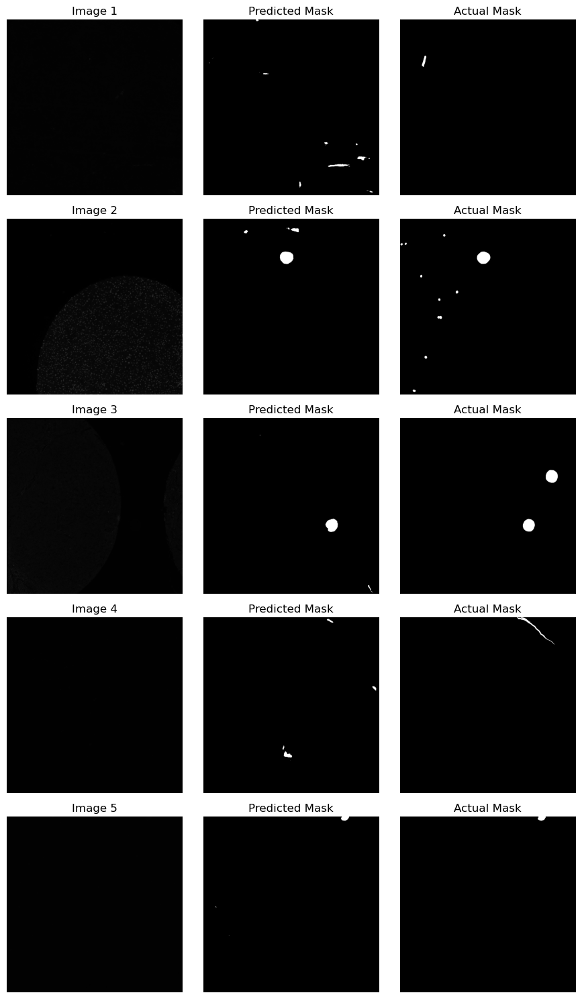

In [21]:
import matplotlib.pyplot as plt
import numpy as np
import random

# Function to plot images, predicted masks, and actual masks
def plot_images(images, predicted_masks, actual_masks):
    num_images = len(images)*3
    rows = 5
    cols = num_images // rows
    
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 3, rows * 3))
    for i in range(rows):
        ax = axes[i ,0]
        image1=cv2.imread(images[i])
        image=np.asarray(image1)
        ax.imshow(image, cmap='gray')
        ax.set_title(f'Image {i+1}')
        ax.axis('off')

        ax = axes[i, 1]
        pred_mask1=cv2.imread(predicted_masks[i])
        pred_mask=np.asarray(pred_mask1)
        ax.imshow(pred_mask, cmap='gray')
        ax.set_title('Predicted Mask')
        ax.axis('off')

        ax = axes[i, 2]
        actual_mask1=cv2.imread(actual_masks[i])
        actual_mask=np.asarray(actual_mask1)
        ax.imshow(actual_mask, cmap='gray')
        ax.set_title('Actual Mask')
        ax.axis('off')
    
    plt.tight_layout()
    plt.show()

# Assuming images, predicted_masks, and actual_masks are lists of numpy arrays
# Here you should load your 10 images, predicted masks, and actual masks
import os
import cv2

# Define the paths to the folders containing images, masks, and predicted masks
image_folder = "data\\Food-Image-Classifier\\test_vgg\\image"
mask_folder = "data\\Food-Image-Classifier\\test_vgg\\label2"
predicted_mask_folder = "data\\re\\test_predict"

# Get the list of image file names from the image folder
image_files = os.listdir(image_folder)
random.shuffle(image_files)
# Initialize lists to store images, masks, and predicted masks
images = []
masks = []
predicted_masks = []
k=0
# Iterate over each image file
for image_file in image_files:
    # Load the image
    image_path = os.path.join(image_folder, image_file)
    images.append(image_path)
    print(image_path)
    # Get the corresponding mask file name
    mask_file = image_file.split('.')[0] + '_label1.png'
    mask_path = os.path.join(mask_folder, mask_file)
    mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
    masks.append(mask_path)
    print(mask_path)
    # Get the corresponding predicted mask file name
    predicted_mask_file = image_file.split('.')[0] + '_OUT.png'
    predicted_mask_path = os.path.join(predicted_mask_folder, predicted_mask_file)
    predicted_mask = cv2.imread(predicted_mask_path, cv2.IMREAD_GRAYSCALE)
    predicted_masks.append(predicted_mask_path)
    k+=1
# Now you have lists of images, masks, and predicted masks
# You can proceed to plot and save them using the previous code snippet
    if k==5:
        break
# Call the function to plot and save the images
plot_images(images, predicted_masks, masks)


In [6]:
import os
import cv2
def convert_to_black_image(image_path):
    # Read the image
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)


    # Set all non-zero pixels to zero
    image[image > 0] = 0

    # Save the modified image
    cv2.imwrite(image_path, image)
   
def sum_white_pixels(image_path):
    # Read the binary image
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Calculate the sum of white pixels
    sum_white = cv2.countNonZero(image)

    return sum_white

def sum_white_pixels_in_folder(folder_path):
    # Initialize dictionary to store sum of white pixels for each image
    sums_per_image = {}
    p=0
    # Iterate over all files in the folder
    for filename in os.listdir(folder_path) :
        if filename.endswith('.png') or filename.endswith('.jpg') :
            # Construct the full path to the image file
            image_path = os.path.join(folder_path, filename)

            # Calculate the sum of white pixels in the image
            sum_in_image = sum_white_pixels(image_path)

            # Store the sum of white pixels for this image

            
            if sum_in_image>0 and sum_in_image<500:
                convert_to_black_image(image_path)
                sums_per_image[filename] = sum_in_image
                p=p+1
    print(p)
    return sums_per_image

# Example usage
folder_path = 'data/re/test_1'
sums_per_image = sum_white_pixels_in_folder(folder_path)

# Print the sums of white pixels for each image
for filename, sum_white_pixels in sums_per_image.items():
    print(f'{filename}: {sum_white_pixels}')


6
CD3OX40_R02_V01_ETIME_MDA_S0M22_DAPI_cropped_2_OUT.png: 356
CD3OX40_R02_V01_ETIME_MDA_S2M32_DAPI_cropped_1_OUT.png: 445
CTR_20200408_00R-Scene-020-ScanRegion19_S0M2_DAPI_cropped_4_OUT.png: 472
DLBCL10_20200425_07R-Scene-06-ScanRegion5_S0M6_AF_FITC_cropped_3_OUT.png: 408
HCV_20200408_00R-Scene-008-ScanRegion7_S0M0_AF_FITC_cropped_7_OUT.png: 307
HCV_20200408_00R-Scene-023-ScanRegion22_S0M2_Cy5_cropped_2_OUT.png: 463


In [14]:
min_value = min(sums_per_image.values())
min_value

274

In [15]:
second_min_value = sorted(sums_per_image.values())
second_min_value

[274,
 590,
 657,
 683,
 767,
 1161,
 1239,
 1380,
 1391,
 1414,
 1673,
 1680,
 1759,
 2030,
 2131,
 2169,
 2181,
 2227,
 2238,
 2285,
 2307,
 2386,
 2392,
 2464,
 2511,
 2586,
 2720,
 2809,
 2876,
 2998,
 3034,
 3129,
 3250,
 3350,
 3399,
 3541,
 3644,
 3733,
 3761,
 3925,
 3969,
 4145,
 4186,
 4347,
 4469,
 4509,
 4670,
 4827,
 4837,
 4857,
 5185,
 5224,
 5244,
 5383,
 5503,
 5538,
 5594,
 5656,
 5693,
 5695,
 5733,
 5923,
 5936,
 5937,
 5987,
 6224,
 6255,
 6428,
 6436,
 6649,
 6676,
 6688,
 6720,
 6736,
 6754,
 6789,
 6840,
 6880,
 6930,
 6936,
 6988,
 6995,
 7002,
 7048,
 7055,
 7085,
 7141,
 7267,
 7303,
 7360,
 7419,
 7454,
 7463,
 7618,
 7726,
 7743,
 7832,
 7848,
 7862,
 7982,
 8065,
 8136,
 8148,
 8148,
 8182,
 8199,
 8364,
 8483,
 8569,
 8572,
 8577,
 8733,
 8850,
 8864,
 8868,
 8901,
 9099,
 9239,
 9246,
 9285,
 9314,
 9345,
 9370,
 9378,
 9492,
 9594,
 9708,
 9958,
 9969,
 10004,
 10032,
 10283,
 10415,
 10481,
 10546,
 10628,
 10633,
 10683,
 10730,
 10739,
 10837,
 10882

In [28]:
sums_per_image

{'CTR_20200408_00R-Scene-020-ScanRegion19_S0M0_AF_FITC_label1.png': 46404,
 'CTR_20200408_00R-Scene-020-ScanRegion19_S0M0_Cy5_label1.png': 24233,
 'CTR_20200408_00R-Scene-020-ScanRegion19_S0M0_DAPI_label1.png': 57868,
 'CTR_20200408_00R-Scene-020-ScanRegion19_S0M0_FITC_label1.png': 49957,
 'CTR_20200408_00R-Scene-020-ScanRegion19_S0M0_TRITC_label1.png': 49423,
 'CTR_20200408_00R-Scene-020-ScanRegion19_S0M2_AF_FITC_label1.png': 17528,
 'CTR_20200408_00R-Scene-020-ScanRegion19_S0M2_FITC_label1.png': 30142,
 'CTR_20200408_00R-Scene-020-ScanRegion19_S0M2_TRITC_label1.png': 30954,
 'CTR_20200408_00R-Scene-020-ScanRegion19_S0M3_AF_FITC_label1.png': 95433,
 'CTR_20200408_00R-Scene-020-ScanRegion19_S0M3_Cy5_label1.png': 104887,
 'CTR_20200408_00R-Scene-020-ScanRegion19_S0M3_DAPI_label1.png': 158669,
 'CTR_20200408_00R-Scene-020-ScanRegion19_S0M3_FITC_label1.png': 125516,
 'CTR_20200408_00R-Scene-020-ScanRegion19_S0M3_TRITC_label1.png': 100970,
 'CTR_20200408_00R-Scene-020-ScanRegion19_S0M4_AF_

In [3]:
len(dice_scores)

NameError: name 'dice_scores' is not defined

In [4]:
import os

def rename_labels(image_folder, label_folder):
    image_files = os.listdir(image_folder)
    label_files = os.listdir(label_folder)
    k=0
    for image_file in image_files:
        # Extract the image name without the extension
        image_name = os.path.splitext(image_file)[0]

        # Find the corresponding label file in the label folder
        for label_file in label_files:
            if label_file.startswith(image_name):
                # Construct the new label file name
                new_label_file = f"{image_name}_label1.png"

                # Rename the label file
                os.rename(os.path.join(label_folder, label_file),
                          os.path.join(label_folder, new_label_file))
                  # Move to the next image file
                k+=1
    print(k)
# Example usage: Provide the paths to the image and label folders
image_folder = 'data/Food-Image-Classifier/test_vgg/image'
label_folder = 'data/Food-Image-Classifier/test_vgg/label2'
rename_labels(image_folder, label_folder)


53


In [18]:
import os
import shutil
import pandas as pd

# Function to copy images and masks
def copy_images_and_masks(pred_csv, train_cropped_folder, masks_folder, re_imgs_folder, re_masks_folder):
    # Read the CSV file containing predicted filenames
    pred_df = pd.read_csv(pred_csv)
    
    # Iterate through each row in the DataFrame
    for index, row in pred_df.iterrows():
        # Get the predicted filename and corresponding mask filename
        pred_filename = row['Predicted Image']
        mask_filename = os.path.basename(row['Mask Image'])
        
        # Get the image name (remove extension)
        image_name = os.path.splitext(pred_filename)[0].split('_OUT')[0]
        print(image_name)
        
        # Find all images in train cropped folder that start with the image name
        matching_images = [f for f in os.listdir(masks_folder) if f.startswith(image_name)]
        print(matching_images)
        for mask_file in matching_images:
            print(mask_file)
        # Find the corresponding mask file
            src_mask_path = os.path.join(masks_folder, mask_file)
            dest_mask_path = os.path.join(re_masks_folder, mask_file)
            shutil.copyfile(src_mask_path, dest_mask_path)
            img_file=mask_file.replace('_label1', '')
            print(img_file)
        # Copy matching images to re/imgs folder
            src_img_path = os.path.join(train_cropped_folder, img_file)
            dest_img_path = os.path.join(re_imgs_folder, img_file)
            shutil.copyfile(src_img_path, dest_img_path)
        
       
        
        print(f"Copied {len(matching_images)} images and corresponding mask '{mask_filename}' to re/imgs and re/masks folders.")

# Paths
pred_csv = 'bad_dice_pairs.csv'
train_cropped_folder = 'data\\imgs'
masks_folder = 'data\\masks'
re_imgs_folder = 'data\\re\\imgs'
re_masks_folder = 'data\\re\\masks'

# Copy images and masks
copy_images_and_masks(pred_csv, train_cropped_folder, masks_folder, re_imgs_folder, re_masks_folder)


CTR_20200408_00R-Scene-020-ScanRegion19_S0M0_AF_FITC
['CTR_20200408_00R-Scene-020-ScanRegion19_S0M0_AF_FITC_cropped_1_label1.png', 'CTR_20200408_00R-Scene-020-ScanRegion19_S0M0_AF_FITC_cropped_2_label1.png', 'CTR_20200408_00R-Scene-020-ScanRegion19_S0M0_AF_FITC_cropped_3_label1.png', 'CTR_20200408_00R-Scene-020-ScanRegion19_S0M0_AF_FITC_cropped_4_label1.png', 'CTR_20200408_00R-Scene-020-ScanRegion19_S0M0_AF_FITC_cropped_7_label1.png']
CTR_20200408_00R-Scene-020-ScanRegion19_S0M0_AF_FITC_cropped_1_label1.png
CTR_20200408_00R-Scene-020-ScanRegion19_S0M0_AF_FITC_cropped_1.png
CTR_20200408_00R-Scene-020-ScanRegion19_S0M0_AF_FITC_cropped_2_label1.png
CTR_20200408_00R-Scene-020-ScanRegion19_S0M0_AF_FITC_cropped_2.png
CTR_20200408_00R-Scene-020-ScanRegion19_S0M0_AF_FITC_cropped_3_label1.png
CTR_20200408_00R-Scene-020-ScanRegion19_S0M0_AF_FITC_cropped_3.png
CTR_20200408_00R-Scene-020-ScanRegion19_S0M0_AF_FITC_cropped_4_label1.png
CTR_20200408_00R-Scene-020-ScanRegion19_S0M0_AF_FITC_cropped_4.p

In [1]:
import os
import shutil
import csv

def move_images(test_folder, train_folder, train_cropped_folder, output_csv):
    moved_files = []

    # Get the list of images in the test folder
    test_images = os.listdir(test_folder)
    
    # Iterate over the images in the test folder
    for image_name in test_images:
        # Check if corresponding cropped image exists in train_cropped folder
        print(image_name)
        b= f"{image_name.split('_cropped')[0]}"+".png"
        print(b)
        cropped_exists_in_train = b in os.listdir(train_cropped_folder)
        
        # If cropped image exists in either train_cropped or val_cropped folder, move the image to train folder
        if cropped_exists_in_train :
            src_path = os.path.join(test_folder, image_name)
            dest_path = os.path.join(train_folder, image_name)
            shutil.move(src_path, dest_path)
            moved_files.append(image_name)
            print(f"Moved {image_name} from test folder to train folder.")

    # Save moved file names to a CSV file
    with open(output_csv, 'w', newline='') as csvfile:
        csv_writer = csv.writer(csvfile)
        csv_writer.writerow(['Moved Files'])
        csv_writer.writerows([[file] for file in moved_files])

# Paths to folders
test_folder = 'data/test/imgs'
train_folder = 'data/imgs'
train_cropped_folder = 'data/Food-Image-Classifier/train_vgg/image'
output_csv = 'moved_files1.csv'

# Move images from test folder to train folder if corresponding cropped images exist
move_images(test_folder, train_folder, train_cropped_folder, output_csv)


CTR_20200408_00R-Scene-020-ScanRegion19_S0M2_DAPI_cropped_1.png
CTR_20200408_00R-Scene-020-ScanRegion19_S0M2_DAPI.png
CTR_20200408_00R-Scene-020-ScanRegion19_S0M2_DAPI_cropped_2.png
CTR_20200408_00R-Scene-020-ScanRegion19_S0M2_DAPI.png
CTR_20200408_00R-Scene-020-ScanRegion19_S0M2_DAPI_cropped_4.png
CTR_20200408_00R-Scene-020-ScanRegion19_S0M2_DAPI.png
CTR_20200408_00R-Scene-020-ScanRegion19_S0M2_DAPI_cropped_7.png
CTR_20200408_00R-Scene-020-ScanRegion19_S0M2_DAPI.png
CTR_20200408_00R-Scene-020-ScanRegion19_S0M4_TRITC_cropped_4.png
CTR_20200408_00R-Scene-020-ScanRegion19_S0M4_TRITC.png
Moved CTR_20200408_00R-Scene-020-ScanRegion19_S0M4_TRITC_cropped_4.png from test folder to train folder.
CTR_20200408_00R-Scene-033-ScanRegion32_S0M1_Cy5_cropped_5.png
CTR_20200408_00R-Scene-033-ScanRegion32_S0M1_Cy5.png
CTR_20200408_00R-Scene-033-ScanRegion32_S0M1_Cy5_cropped_8.png
CTR_20200408_00R-Scene-033-ScanRegion32_S0M1_Cy5.png
CTR_20200408_00R-Scene-046-ScanRegion45_S0M1_AF_FITC_cropped_5.png
CTR_

In [2]:
import os
import shutil
import csv

def extract_image_name(mask_name):
    # Split the mask name to extract the image name
    image_name = mask_name.split('.png')[0]
    return image_name

def move_masks(moved_files_csv, test_labels_folder, train_folder):
    # Read the moved files from the CSV file
    k=0
    moved_files = []
    with open(moved_files_csv, 'r') as csvfile:
        csv_reader = csv.reader(csvfile)
        next(csv_reader)  # Skip header
        for row in csv_reader:
            moved_files.append(row[0])
    print(moved_files)
    print(len(moved_files))
    # Iterate over the moved files and move corresponding masks
    for image_name in moved_files:
        # Construct the mask file name pattern to match
        mask_name_pattern = extract_image_name(image_name) 
        print(mask_name_pattern)
        # Find matching mask files in the test_labels folder
        mask_files = [f for f in os.listdir(test_labels_folder) if f.startswith(mask_name_pattern)]
        print(len(mask_files))

        # Move each matching mask file to the train folder
        for mask_file in mask_files:
            src_path = os.path.join(test_labels_folder, mask_file)
            dest_path = os.path.join(train_folder, mask_file)
            shutil.move(src_path, dest_path)
            k+=1
            print(f"Moved {mask_file} from test_labels folder to train folder.")
    print(k)
# Paths to folders and files
moved_files_csv = 'moved_files1.csv'
test_labels_folder = 'data\\test\\masks'
train_folder = 'data\\masks'

# Move masks from test_labels folder to train folder based on moved files
move_masks(moved_files_csv, test_labels_folder, train_folder)


['CTR_20200408_00R-Scene-020-ScanRegion19_S0M4_TRITC_cropped_4.png', 'CTR_20200408_00R-Scene-046-ScanRegion45_S0M1_AF_FITC_cropped_5.png', 'CTR_20200408_00R-Scene-046-ScanRegion45_S0M1_AF_FITC_cropped_8.png', 'CTR_20200408_00R-Scene-046-ScanRegion45_S0M1_FITC_cropped_5.png', 'CTR_20200408_00R-Scene-046-ScanRegion45_S0M1_FITC_cropped_8.png', 'DLBCL10_20200530_33R-Scene-01-ScanRegion0_S0M4_TRITC_cropped_4.png', 'DLBCL10_20200530_33R-Scene-01-ScanRegion0_S0M4_TRITC_cropped_5.png', 'DLBCL10_20200530_33R-Scene-01-ScanRegion0_S0M4_TRITC_cropped_6.png', 'DLBCL10_20200601_34R-Scene-11-ScanRegion10_S0M1_TRITC_cropped_1.png', 'DLBCL10_20200601_34R-Scene-11-ScanRegion10_S0M1_TRITC_cropped_7.png', 'DLBCL10_20200601_34R-Scene-11-ScanRegion10_S0M1_TRITC_cropped_8.png', 'DT1_R01_V2-Scene-15-ScanRegion14_S0M7_DAPI_cropped_3.png', 'DT1_R01_V2-Scene-15-ScanRegion14_S0M7_DAPI_cropped_6.png', 'DT1_R09_V1-Scene-04-ScanRegion3_S0M1_DAPI_cropped_8.png', 'HHCC_20200408_00R-Scene-045-ScanRegion44_S0M0_FITC_cro

In [5]:
import os

def count_same_files(folder1, folder2):
    # Get the list of files in each folder
    files1 = os.listdir(folder1)
    files2 = os.listdir(folder2)
    
    # Convert file names to sets for efficient comparison
    files1_set = set(files1)
    files2_set = set(files2)
    
    # Find the intersection of file names between the two folders
    same_files = files1_set.intersection(files2_set)
    
    # Count the number of files with the same name
    num_same_files = len(same_files)
    
    return num_same_files

# Paths to the folders
folder1 = 'data\\Food-Image-Classifier\\test_vgg\\image'
folder2 = 'data\\Food-Image-Classifier\\train_vgg\\image'

# Count the number of files with the same name in both folders
num_same_files = count_same_files(folder1, folder2)
print(f"Number of files with the same name in both folders: {num_same_files}")


Number of files with the same name in both folders: 0
